In [1]:
#Intraday Trading Strategies for Stock Markets Using Clustering and Differential Evolution

'''
This work presents a data science approach to provide a stock trading strategy based
on behavioral trends. Creating an intraday trading strategy, treating each daily behavior
as an individual and clustering based on its time series using a hierarchical clustering 
algorithm. Also a differential evolution was used to perform an intensification search in 
promising regions and adjust the borders regions parameters by the proposed model of this 
research. The main challenge for application in an emerging market are the creation of an 
adaptive strategy due to the high volatility of external factors, a wide range of results 
are generated to evaluate the strategy. Excellent results were obtained, mainly regarding 
the returns normality, tests were performed over a period of three years, presenting better 
results than Buy-\&-Hold and with a very reduced drawdown, therefore this strategy can be 
used as leverage. Thus, allowing for an investment greater than the monetary value of the 
invested capital.
'''

# Notebook


''' 
Notebook built to reproduce the study of the paper submitted to WCCI
INSTRUCTIONS FOR RUNNING THE CODE ARE IN README.MD
''' 


# Angelo Darcy Molin Brun - angelo.molin@ufms.br
# Adriano Cesár Machado Pereira - adrianoc@ufmg.br

' \nNotebook built to reproduce the study of the paper submitted to WCCI\nINSTRUCTIONS FOR RUNNING THE CODE ARE IN README.MD\n'

In [2]:
#Configuration of de Experiment

Otimization = False #[True] [False] Slow if True 
PlotClusters = True #[True] [False] Extensive Visualization
Windowing = 3 #[1] Six months - [2] One year - [3] Two years - [4] Accumulated


In [3]:
#Figure Plot by Time
def FigureBar():

    hora = sorted(Dados.hora.unique())
    hora = hora[0:31]
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaPerdaCompradoHoraCompra.count(
            tempo) + listaPerdaVendidoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaGanhoVendidoHoraVenda.count(
            tempo) + listaPerdaCompradoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribuition Buy/Sell')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Gain)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaGanhoVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell With Positive Returns')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Loss)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaCompradoHoraCompra.count(tempo) + listaPerdaVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaCompradoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell With Negative Returns')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Buy)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaPerdaCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaPerdaCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (BUY GAINS)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Positive Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy Losses)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Negative Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaVendidoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoVendidoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold at Gain)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Positive Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold at Loss)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Negative Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()


def FigureBarMagnitude():

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraCompraMagnitude[str(tempo)] + listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaCompradoHoraCompraMagnitude[str(tempo)]+ listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+ listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaGanhoVendidoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)]+ listaPerdaVendidoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraCompraMagnitude[str(tempo)] + listaPerdaCompradoHoraCompraMagnitude[str(tempo)]+listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)])

    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
     #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+  listaGanhoVendidoHoraVendaMagnitude[str(tempo)] + listaPerdaVendidoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
    #----------------------------------------//----------------------------------------
    # Plot the frequency of purchase and sale orders per hour (Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] +  listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+ listaGanhoCompradoHoraVendaMagnitude[str(tempo)] +  listaPerdaCompradoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy - Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)])

    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
     #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold - Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaVendidoHoraCompraMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
    

#Validates the buy and sale of assets
def verificaCompra(Representacao, correlacaoMomento, listaMedias,  posicao, ultimoNegocio, plot, comprado, vendido,parametrosNegociacao):
    
    somaGanho = 0
    somaRepresentacao = 0
    somaCorrelacao = 0
    ganho = 0
    clusters = []
    
    for i in range(0,len(correlacaoMomento)):
        ganho =  listaMedias[i][ultimoNegocio] - listaMedias[i][posicao]
        if correlacaoMomento[i] > 0.5:
            somaCorrelacao = somaCorrelacao + correlacaoMomento[i]*Representacao[i]
            somaRepresentacao = somaRepresentacao + Representacao[i]
            
            somaGanho = somaGanho + ganho*(Representacao[i]*1)
            clusters.append(i)
    
    
    if (somaGanho != 0) & (somaCorrelacao != 0):
        parametroGanho = somaGanho/somaRepresentacao
        parametroCorrelacao = somaCorrelacao/somaRepresentacao
    else:
        parametroGanho = 0
        parametroCorrelacao = 0
        
    if plot:
        print('Gain Parameter: ', parametroGanho)
        print('Gain Correlation: ', parametroCorrelacao)
    
        print("Clusters: ", clusters)

    if (parametroGanho > medidaGanho) & ((parametroCorrelacao > medidaCorrelacao) | (len(clusters) == 1)):
        if plot:
            print('Buy')
        return 1
    else:
        if (parametroGanho < medidaGanho ) & (parametroGanho > margemRisco ):
            if plot:
                print('Does not Perform')
            return 0
        else:
            #if (parametroGanho < medidaGanho*-1) & (parametroCorrelacao > medidaCorrelacao):
            if (parametroGanho < margemRisco) & ((parametroCorrelacao > medidaCorrelacaoRisco)  | (len(clusters) == 1)) & (comprado>0):
                if plot:
                    print('Sold')
                return -1

    if (parametroGanho < (-1*medidaGanho)) & ((parametroCorrelacao > medidaCorrelacao) | (len(clusters) == 1)):
        if plot:
            print('Sold Long')
        return 2
    else:
        if (parametroGanho > margemRisco) & ((parametroCorrelacao > medidaCorrelacaoRisco)  | (len(clusters) == 1))& (vendido>0):
            if plot:
                print('Buy Long')
        return -2
    
    #print('Inconsistente')
    return 3
    

In [4]:
# Teste de estratégia para MiniIndice
from Main import estruturaDados
import pandas as pd
import numpy as np
from datetime import datetime
import math
import scipy.cluster.hierarchy as hac
import matplotlib.pyplot as plt
import numpy as np
from scipy.cluster.hierarchy import fcluster
from sklearn import linear_model
import seaborn as sns
from scipy.stats import zscore
import statistics 

DatasIniciaisMes = ['2014-01-02' , '2014-02-03' , '2014-03-06' , '2014-04-01' , '2014-05-02' , '2014-06-02' , '2014-07-01' , '2014-08-01' , '2014-09-01' , '2014-10-01' , '2014-11-03' , '2014-12-01' ,
                    '2015-01-02' , '2015-02-02' , '2015-03-02' , '2015-04-01' , '2015-05-04' , '2015-06-01' , '2015-07-01' , '2015-08-03' , '2015-09-01' , '2015-10-01' , '2015-11-03' , '2015-12-01' ,
                    '2016-01-04' , '2016-02-01' , '2016-03-01' , '2016-04-01' , '2016-05-02' , '2016-06-01' , '2016-07-01' , '2016-08-01' , '2016-09-01' , '2016-10-03' , '2016-11-01' , '2016-12-01' , 
                    '2017-01-02' , '2017-02-01' , '2017-03-02' , '2017-04-03' , '2017-05-02' , '2017-06-01' , '2017-07-03' , '2017-08-01' , '2017-09-01' , '2017-10-02' , '2017-11-01' , '2017-12-01' , 
                    '2018-01-02' , '2018-02-01' , '2018-03-01' , '2018-04-02' , '2018-05-02' , '2018-06-01' , '2018-07-02' , '2018-08-01' , '2018-09-03' , '2018-10-01' , '2018-11-01' , '2018-12-03' , 
                    '2019-01-02' , '2019-02-01' , '2019-03-01' , '2019-04-01']



print('Reading...')
Dados = pd.read_csv("miniIndice.csv")

lista = []
datahora = []
time = []
data = []
for i in range(0,len(Dados)):
    lista.append('miniIndice')
    datahora.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S"))
    time.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S").time())
    data.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S").date())


Dados["codigo"] = lista;
Dados["datahora"] = datahora
Dados["data"] = data
Dados["hora"] = time

ativosAnalisados = ['miniIndice']

print('Mount the Data in the Formatted Series...')
# Monta estrutura baseada em Séries para aplicação de algoritmos
DadosSeries = estruturaDados.MontaSerie_Cluster(Dados,ativosAnalisados);

print('Segmentation of Days...')
#Segmenta os dados por dia semana
DadosDiaSemana = estruturaDados.segmentaDias(Dados, DadosSeries, ativosAnalisados)

print('Data Processing...')
[DadosFiltrados, DiasAnalisados] = estruturaDados.tratamentoDados(DadosDiaSemana)


hora= sorted(Dados.hora.unique())

print('Structure LogRetorno...')
logRetornoTratado = estruturaDados.DadosEntrada(DadosFiltrados, hora, 1)

#Dados
DadosTratados = logRetornoTratado

sequencia = range(0,len(DadosTratados.T))
DadosTratados.columns=[*sequencia]

#Cria lista de Dias com dados completos
dt_idx = pd.DatetimeIndex(DiasAnalisados, dtype='datetime64[ns, UTC]', name=u'DATE', freq=None)

print("Finished")

Reading...
Mount the Data in the Formatted Series...
Asset: miniIndice
Successfully Executed!!!
Segmentation of Days...
Data Processing...
Structure LogRetorno...
Finished


----------//----------
Studied Month:  2016-01-04
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  490
Plot the Clusters Formed
Cluster 0
Have 191 days
Representation: 38.98
Accumulated Representation: 38.98
Absolute Error: 0.0227
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


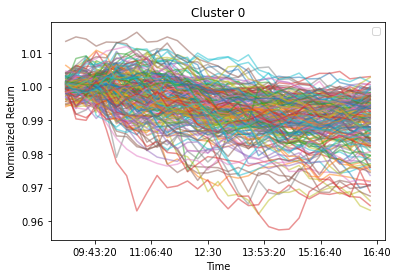

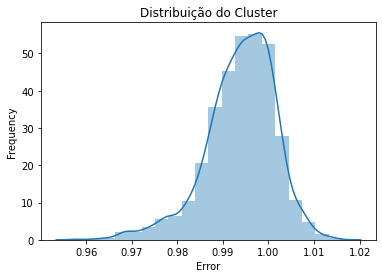

#------------------------------//------------------------------#
Cluster 1
Have 140 days
Representation: 28.57
Accumulated Representation: 67.55
Absolute Error: 0.0220
Mean Square Error: 0.0007
Upward Trend 09:15:00


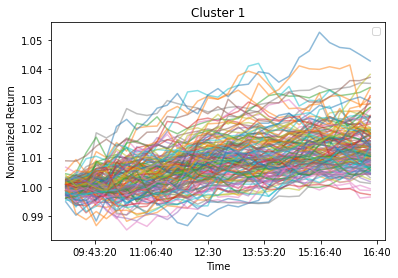

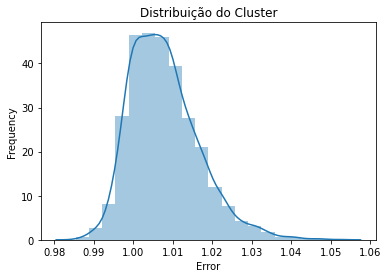

#------------------------------//------------------------------#
Cluster 2
Have 23 days
Representation: 4.69
Accumulated Representation: 72.24
Absolute Error: 0.0633
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 13:45:00


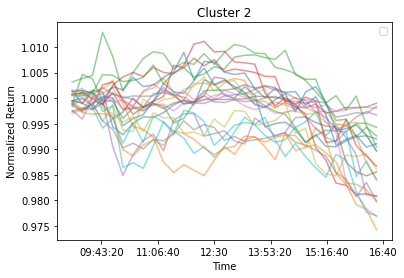

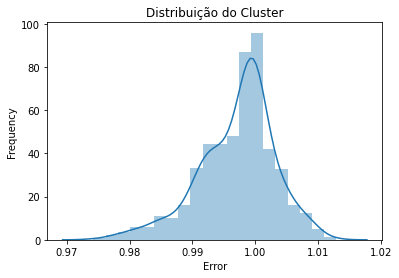

#------------------------------//------------------------------#
Cluster 3
Have 16 days
Representation: 3.27
Accumulated Representation: 75.51
Absolute Error: 0.1037
Mean Square Error: 0.0033
Upward Trend 09:15:00
Downtrend 13:45:00


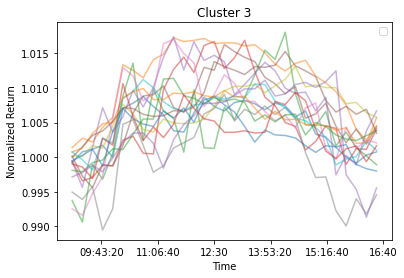

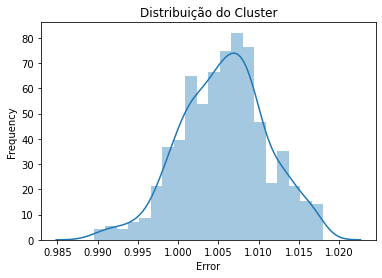

#------------------------------//------------------------------#
Cluster 4
Have 13 days
Representation: 2.65
Accumulated Representation: 78.16
Absolute Error: 0.0635
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:30:00
Upward Trend 15:30:00


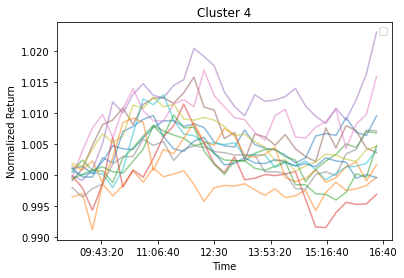

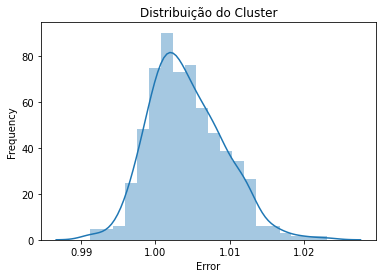

#------------------------------//------------------------------#
Cluster 5
Have 11 days
Representation: 2.24
Accumulated Representation: 80.41
Absolute Error: 0.0621
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:00:00
Upward Trend 14:00:00


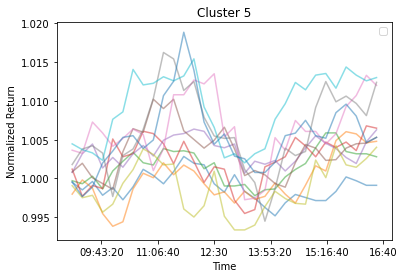

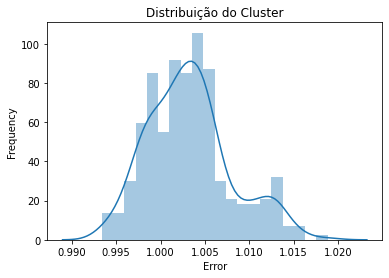

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -305
----------//----------
Studied Month:  2016-02-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  509
Plot the Clusters Formed
Cluster 0
Have 200 days
Representation: 39.29
Accumulated Representation: 39.29
Absolute Error: 0.0178
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


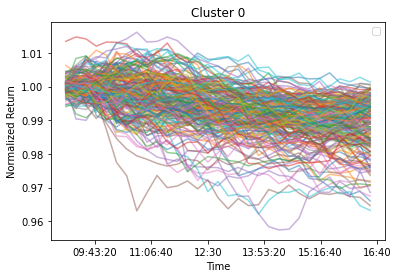

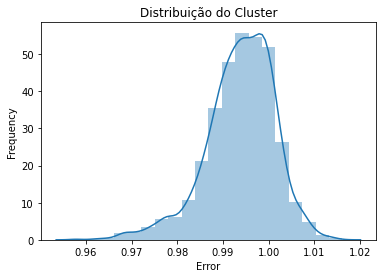

#------------------------------//------------------------------#
Cluster 1
Have 147 days
Representation: 28.88
Accumulated Representation: 68.17
Absolute Error: 0.0225
Mean Square Error: 0.0007
Upward Trend 09:15:00


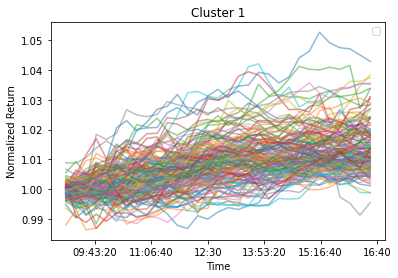

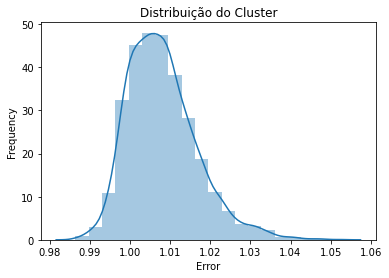

#------------------------------//------------------------------#
Cluster 2
Have 28 days
Representation: 5.50
Accumulated Representation: 73.67
Absolute Error: 0.0898
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:15:00


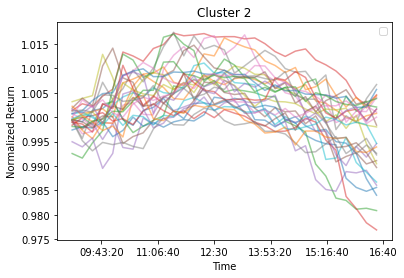

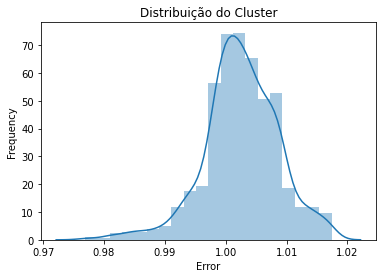

#------------------------------//------------------------------#
Cluster 3
Have 16 days
Representation: 3.14
Accumulated Representation: 76.82
Absolute Error: 0.0736
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:15:00
Upward Trend 13:45:00


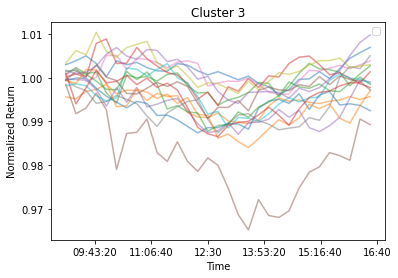

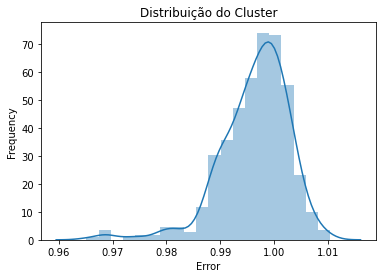

#------------------------------//------------------------------#
Cluster 4
Have 14 days
Representation: 2.75
Accumulated Representation: 79.57
Absolute Error: 0.0853
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 13:00:00


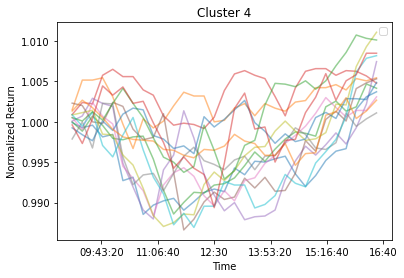

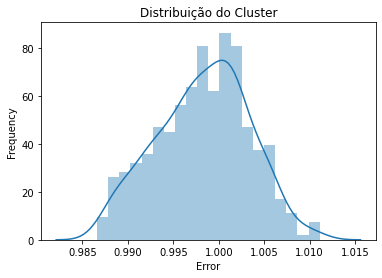

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.55
Accumulated Representation: 82.12
Absolute Error: 0.0623
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:30:00


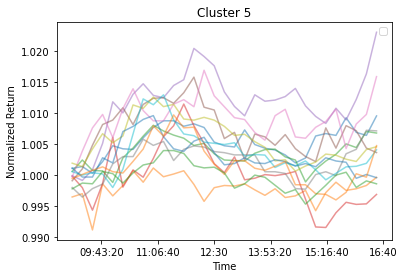

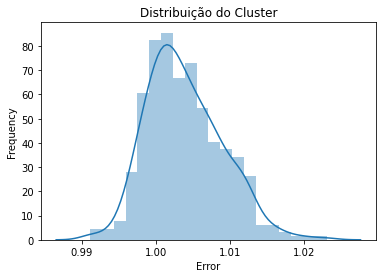

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -202
----------//----------
Studied Month:  2016-03-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  527
Plot the Clusters Formed
Cluster 0
Have 205 days
Representation: 38.90
Accumulated Representation: 38.90
Absolute Error: 0.0219
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


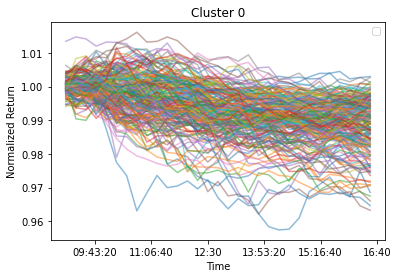

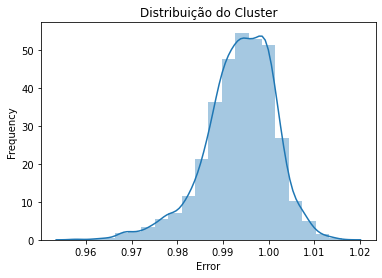

#------------------------------//------------------------------#
Cluster 1
Have 155 days
Representation: 29.41
Accumulated Representation: 68.31
Absolute Error: 0.0241
Mean Square Error: 0.0008
Upward Trend 09:15:00


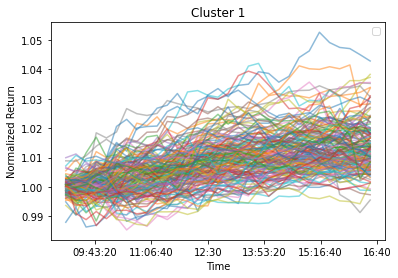

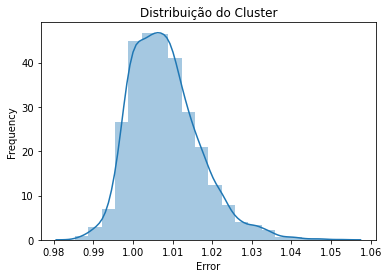

#------------------------------//------------------------------#
Cluster 2
Have 23 days
Representation: 4.36
Accumulated Representation: 72.68
Absolute Error: 0.0666
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 10:45:00
Downtrend 12:45:00


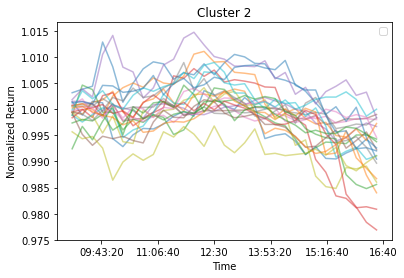

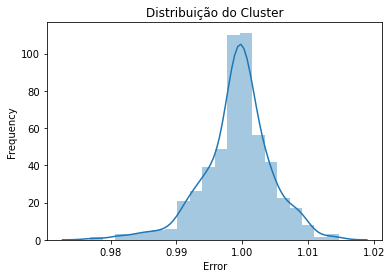

#------------------------------//------------------------------#
Cluster 3
Have 17 days
Representation: 3.23
Accumulated Representation: 75.90
Absolute Error: 0.0795
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


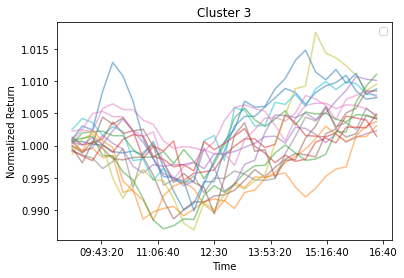

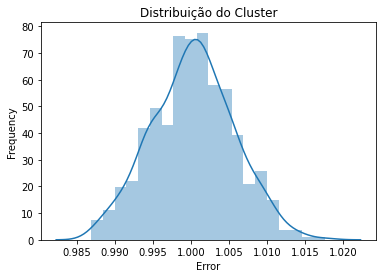

#------------------------------//------------------------------#
Cluster 4
Have 15 days
Representation: 2.85
Accumulated Representation: 78.75
Absolute Error: 0.0974
Mean Square Error: 0.0031
Upward Trend 09:15:00
Downtrend 13:15:00


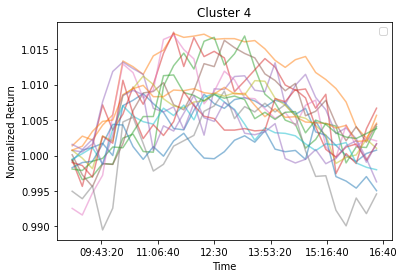

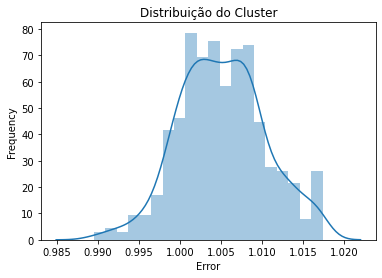

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.47
Accumulated Representation: 81.21
Absolute Error: 0.0623
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:30:00


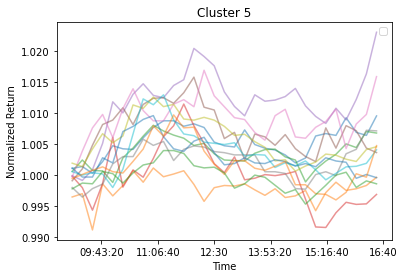

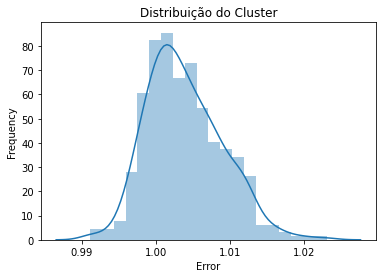

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2634
----------//----------
Studied Month:  2016-04-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  549
Plot the Clusters Formed
Cluster 0
Have 209 days
Representation: 38.07
Accumulated Representation: 38.07
Absolute Error: 0.0228
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


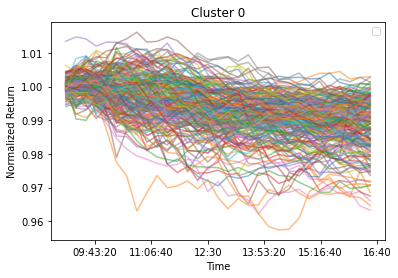

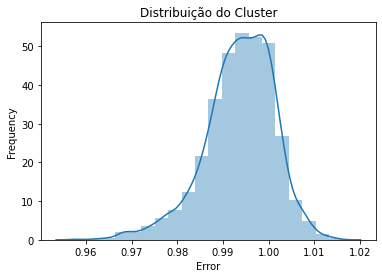

#------------------------------//------------------------------#
Cluster 1
Have 164 days
Representation: 29.87
Accumulated Representation: 67.94
Absolute Error: 0.0212
Mean Square Error: 0.0007
Upward Trend 09:15:00


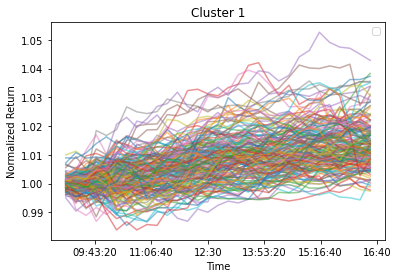

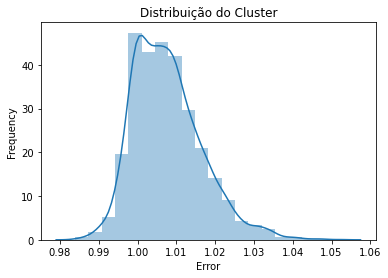

#------------------------------//------------------------------#
Cluster 2
Have 24 days
Representation: 4.37
Accumulated Representation: 72.31
Absolute Error: 0.0747
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 10:45:00
Downtrend 12:45:00


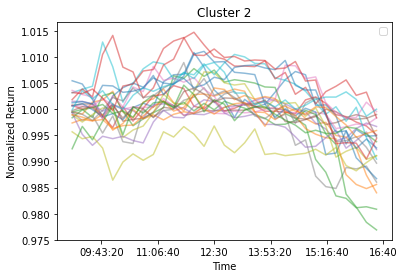

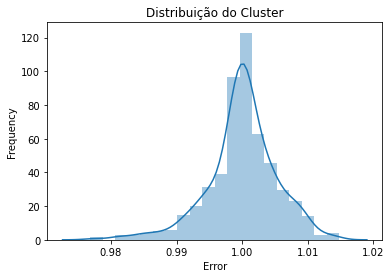

#------------------------------//------------------------------#
Cluster 3
Have 23 days
Representation: 4.19
Accumulated Representation: 76.50
Absolute Error: 0.0849
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 12:00:00


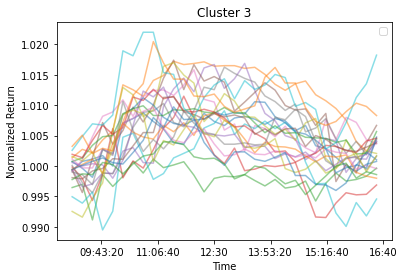

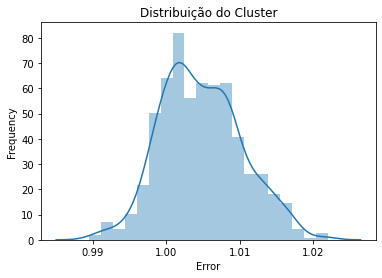

#------------------------------//------------------------------#
Cluster 4
Have 22 days
Representation: 4.01
Accumulated Representation: 80.51
Absolute Error: 0.0675
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


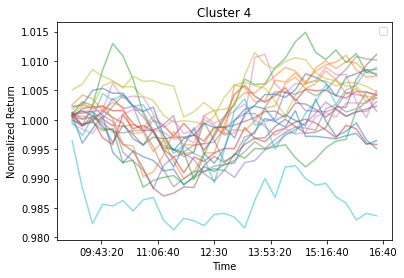

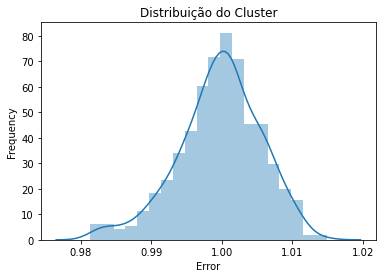

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1403
----------//----------
Studied Month:  2016-05-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  569
Plot the Clusters Formed
Cluster 0
Have 215 days
Representation: 37.79
Accumulated Representation: 37.79
Absolute Error: 0.0236
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


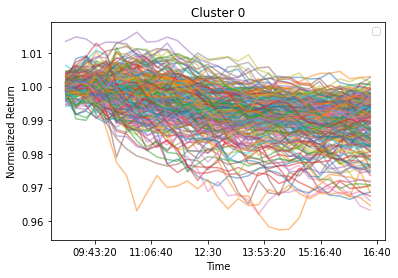

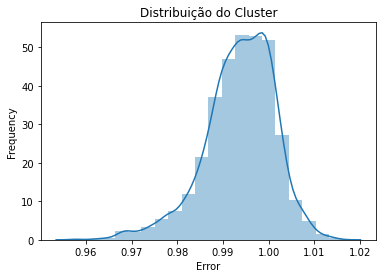

#------------------------------//------------------------------#
Cluster 1
Have 169 days
Representation: 29.70
Accumulated Representation: 67.49
Absolute Error: 0.0224
Mean Square Error: 0.0007
Upward Trend 09:15:00


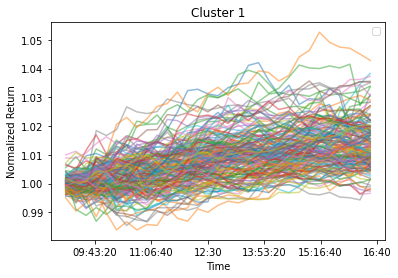

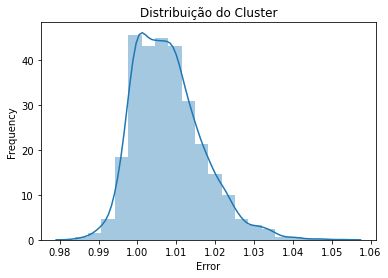

#------------------------------//------------------------------#
Cluster 2
Have 31 days
Representation: 5.45
Accumulated Representation: 72.93
Absolute Error: 0.0907
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:15:00


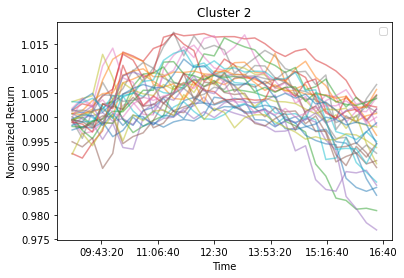

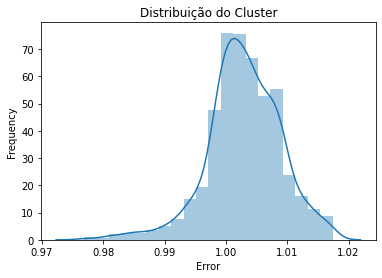

#------------------------------//------------------------------#
Cluster 3
Have 17 days
Representation: 2.99
Accumulated Representation: 75.92
Absolute Error: 0.0686
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:00:00
Upward Trend 13:30:00


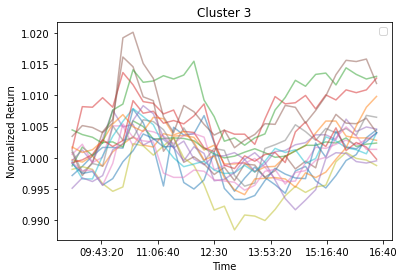

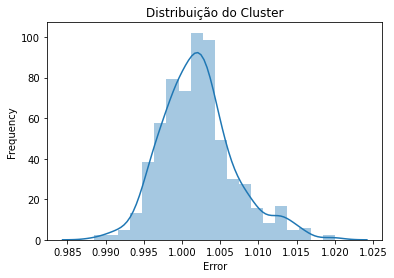

#------------------------------//------------------------------#
Cluster 4
Have 16 days
Representation: 2.81
Accumulated Representation: 78.73
Absolute Error: 0.0748
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 10:30:00
Upward Trend 12:30:00


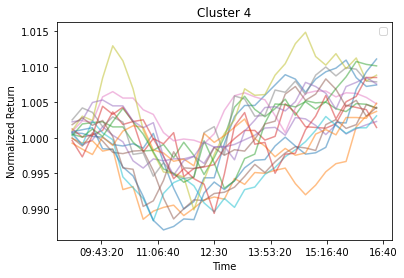

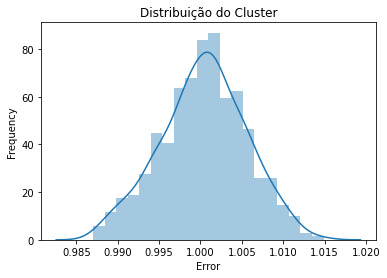

#------------------------------//------------------------------#
Cluster 5
Have 11 days
Representation: 1.93
Accumulated Representation: 80.67
Absolute Error: 0.0675
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:30:00
Upward Trend 15:15:00


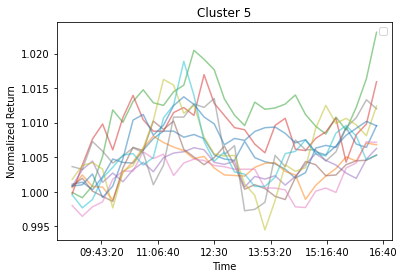

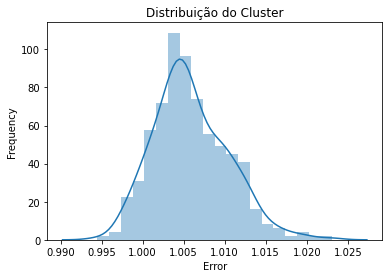

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -67
----------//----------
Studied Month:  2016-06-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  590
Plot the Clusters Formed
Cluster 0
Have 217 days
Representation: 36.78
Accumulated Representation: 36.78
Absolute Error: 0.0231
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


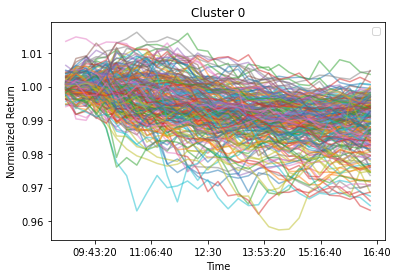

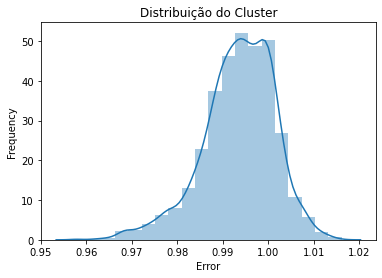

#------------------------------//------------------------------#
Cluster 1
Have 169 days
Representation: 28.64
Accumulated Representation: 65.42
Absolute Error: 0.0235
Mean Square Error: 0.0008
Upward Trend 09:15:00


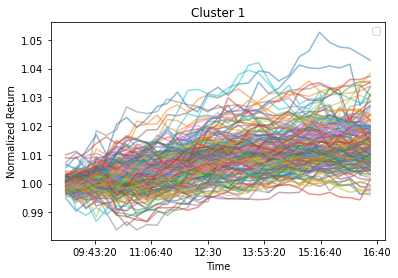

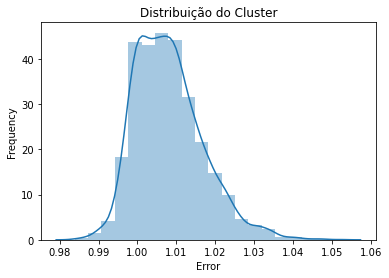

#------------------------------//------------------------------#
Cluster 2
Have 34 days
Representation: 5.76
Accumulated Representation: 71.19
Absolute Error: 0.0908
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


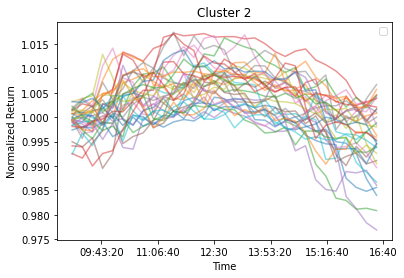

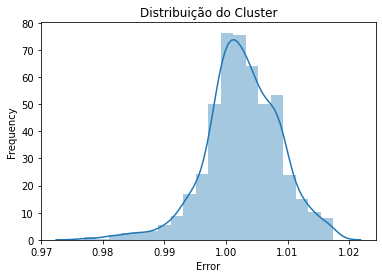

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 4.41
Accumulated Representation: 75.59
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


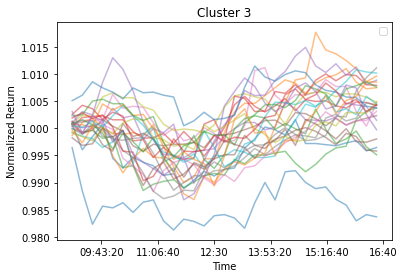

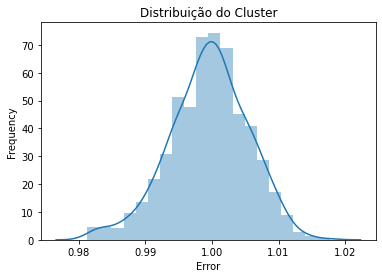

#------------------------------//------------------------------#
Cluster 4
Have 15 days
Representation: 2.54
Accumulated Representation: 78.14
Absolute Error: 0.0606
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 14:45:00


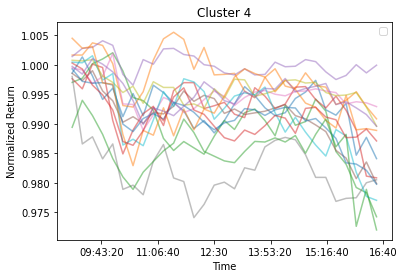

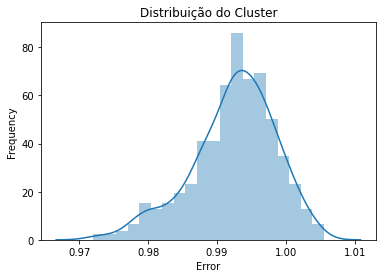

#------------------------------//------------------------------#
Cluster 5
Have 10 days
Representation: 1.69
Accumulated Representation: 79.83
Absolute Error: 0.0687
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:30:00
Upward Trend 15:15:00


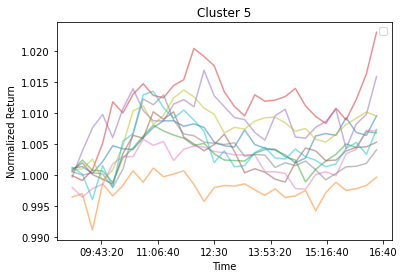

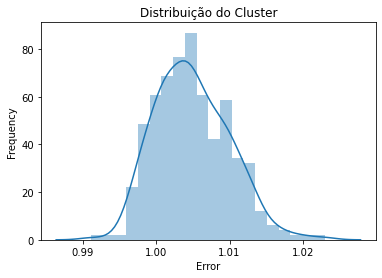

#------------------------------//------------------------------#
Cluster 6
Have 10 days
Representation: 1.69
Accumulated Representation: 81.53
Absolute Error: 0.0403
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00
Downtrend 13:15:00


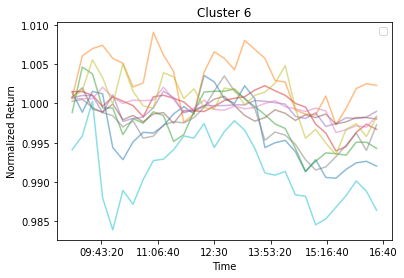

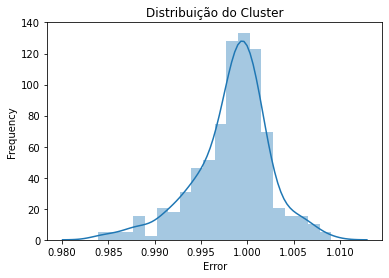

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  712
----------//----------
Studied Month:  2016-07-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  612
Plot the Clusters Formed
Cluster 0
Have 219 days
Representation: 35.78
Accumulated Representation: 35.78
Absolute Error: 0.0261
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


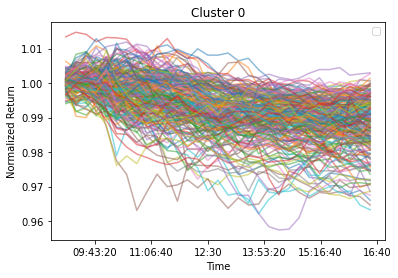

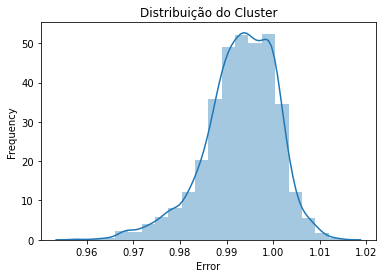

#------------------------------//------------------------------#
Cluster 1
Have 178 days
Representation: 29.08
Accumulated Representation: 64.87
Absolute Error: 0.0233
Mean Square Error: 0.0008
Upward Trend 09:15:00


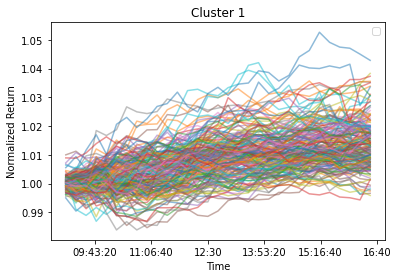

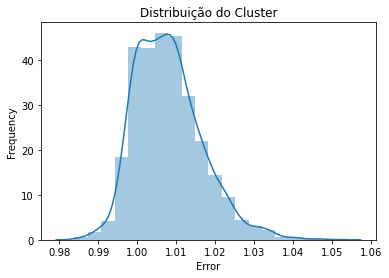

#------------------------------//------------------------------#
Cluster 2
Have 33 days
Representation: 5.39
Accumulated Representation: 70.26
Absolute Error: 0.0734
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 12:15:00


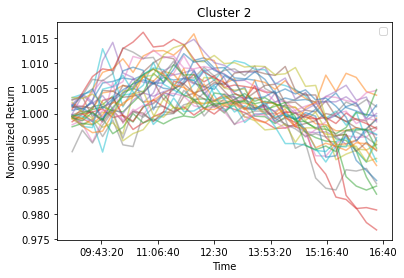

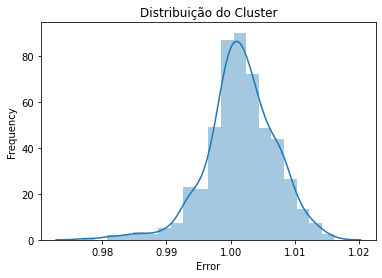

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 4.25
Accumulated Representation: 74.51
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


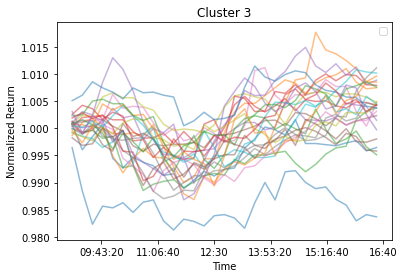

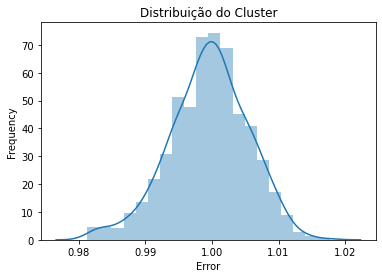

#------------------------------//------------------------------#
Cluster 4
Have 20 days
Representation: 3.27
Accumulated Representation: 77.78
Absolute Error: 0.1000
Mean Square Error: 0.0032
Upward Trend 09:15:00
Downtrend 13:45:00


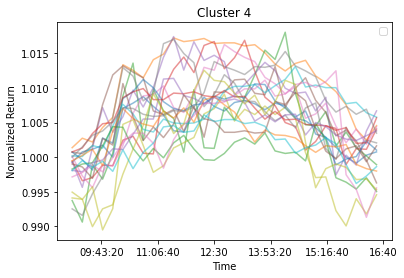

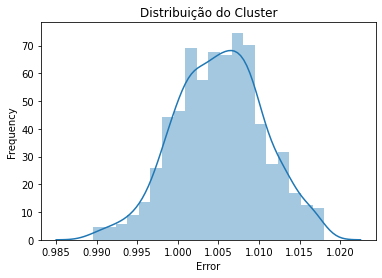

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.12
Accumulated Representation: 79.90
Absolute Error: 0.0499
Mean Square Error: 0.0016
Downtrend 09:15:00
Upward Trend 11:15:00
Downtrend 12:15:00
Upward Trend 13:30:00


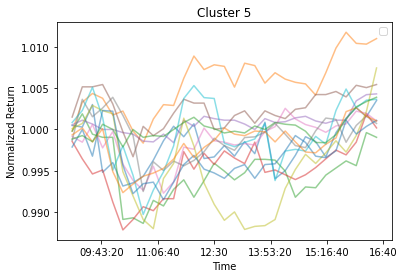

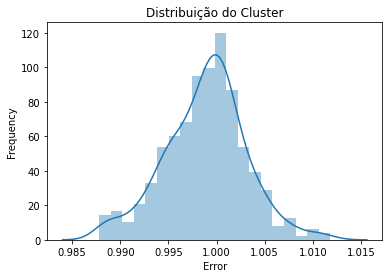

#------------------------------//------------------------------#
Cluster 6
Have 12 days
Representation: 1.96
Accumulated Representation: 81.86
Absolute Error: 0.0707
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:45:00
Downtrend 15:30:00


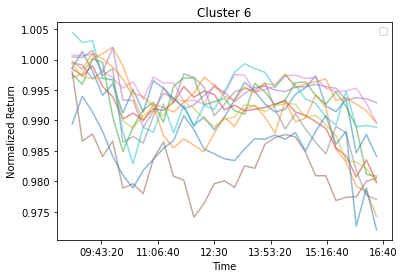

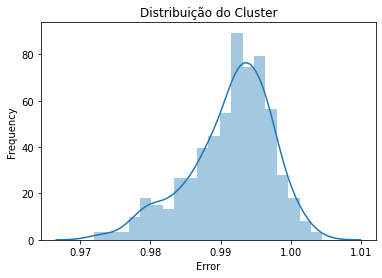

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2049
----------//----------
Studied Month:  2016-08-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  633
Plot the Clusters Formed
Cluster 0
Have 223 days
Representation: 35.23
Accumulated Representation: 35.23
Absolute Error: 0.0262
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


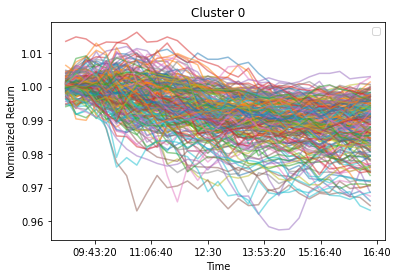

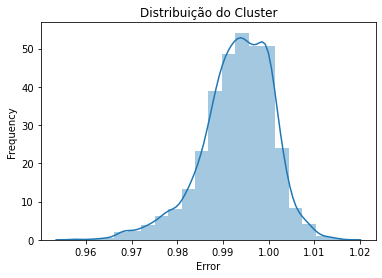

#------------------------------//------------------------------#
Cluster 1
Have 189 days
Representation: 29.86
Accumulated Representation: 65.09
Absolute Error: 0.0214
Mean Square Error: 0.0007
Upward Trend 09:15:00


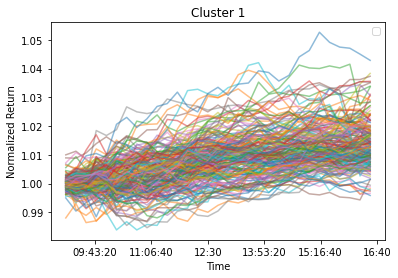

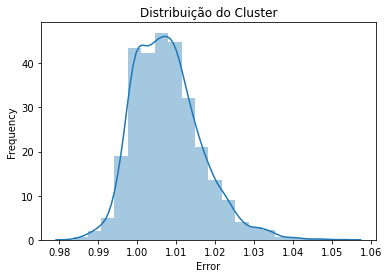

#------------------------------//------------------------------#
Cluster 2
Have 38 days
Representation: 6.00
Accumulated Representation: 71.09
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:15:00


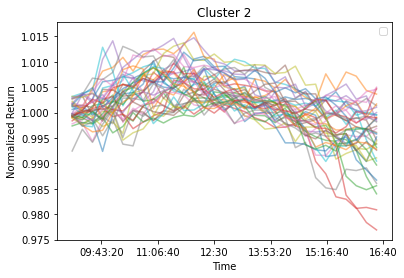

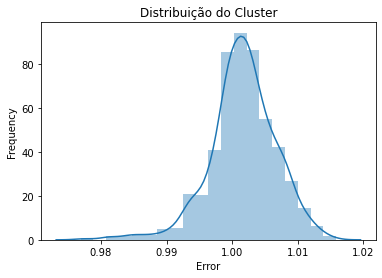

#------------------------------//------------------------------#
Cluster 3
Have 20 days
Representation: 3.16
Accumulated Representation: 74.25
Absolute Error: 0.1000
Mean Square Error: 0.0032
Upward Trend 09:15:00
Downtrend 13:45:00


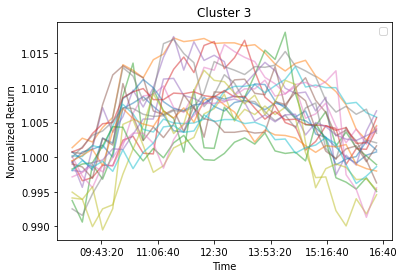

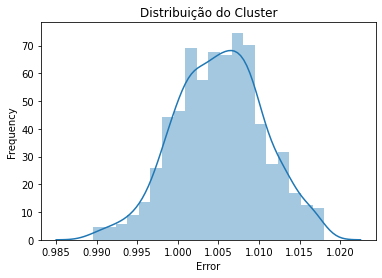

#------------------------------//------------------------------#
Cluster 4
Have 16 days
Representation: 2.53
Accumulated Representation: 76.78
Absolute Error: 0.0699
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00
Downtrend 16:15:00


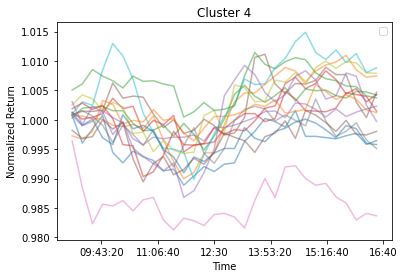

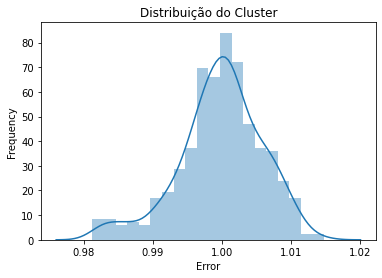

#------------------------------//------------------------------#
Cluster 5
Have 15 days
Representation: 2.37
Accumulated Representation: 79.15
Absolute Error: 0.0863
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 13:15:00


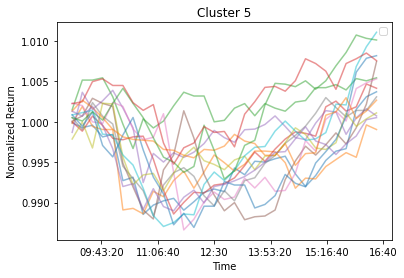

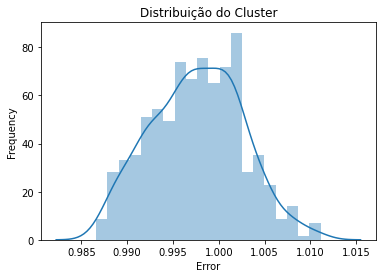

#------------------------------//------------------------------#
Cluster 6
Have 12 days
Representation: 1.90
Accumulated Representation: 81.04
Absolute Error: 0.0640
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 12:00:00
Upward Trend 15:45:00


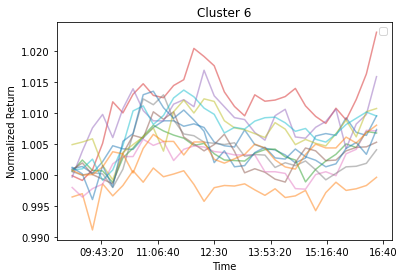

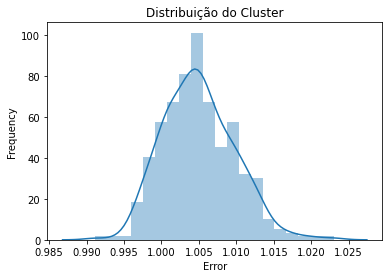

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1779
----------//----------
Studied Month:  2016-09-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  656
Plot the Clusters Formed
Cluster 0
Have 196 days
Representation: 29.88
Accumulated Representation: 29.88
Absolute Error: 0.0325
Mean Square Error: 0.0010
Upward Trend 09:15:00
Downtrend 10:00:00


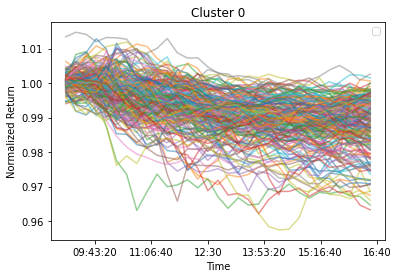

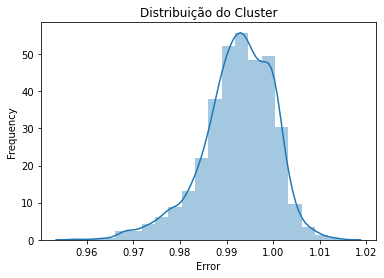

#------------------------------//------------------------------#
Cluster 1
Have 180 days
Representation: 27.44
Accumulated Representation: 57.32
Absolute Error: 0.0199
Mean Square Error: 0.0006
Upward Trend 09:15:00


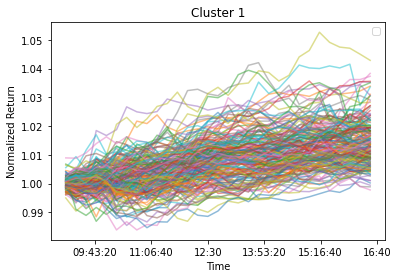

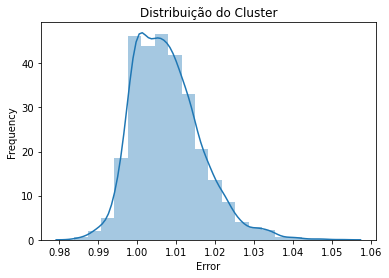

#------------------------------//------------------------------#
Cluster 2
Have 58 days
Representation: 8.84
Accumulated Representation: 66.16
Absolute Error: 0.0531
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 12:00:00


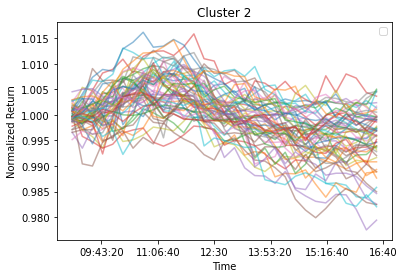

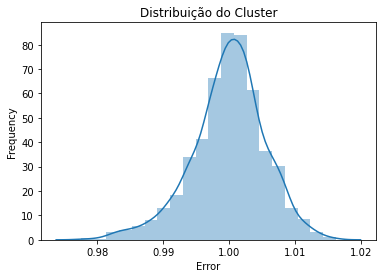

#------------------------------//------------------------------#
Cluster 3
Have 36 days
Representation: 5.49
Accumulated Representation: 71.65
Absolute Error: 0.0891
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


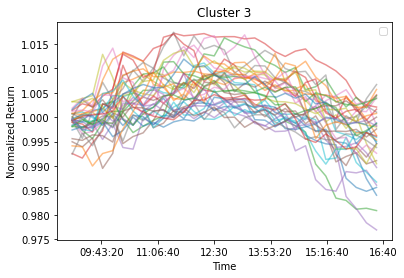

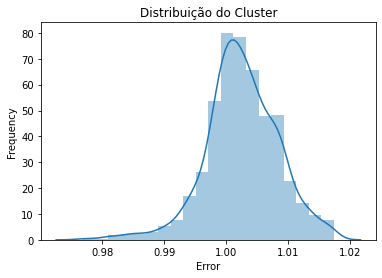

#------------------------------//------------------------------#
Cluster 4
Have 23 days
Representation: 3.51
Accumulated Representation: 75.15
Absolute Error: 0.0639
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 12:15:00
Downtrend 15:30:00


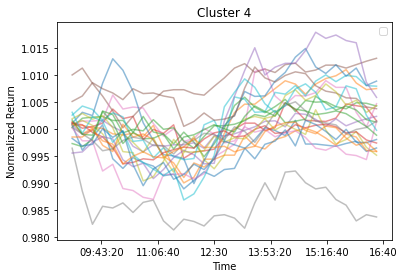

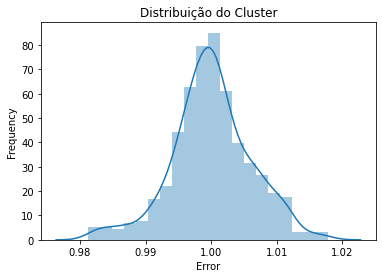

#------------------------------//------------------------------#
Cluster 5
Have 20 days
Representation: 3.05
Accumulated Representation: 78.20
Absolute Error: 0.0787
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 14:00:00


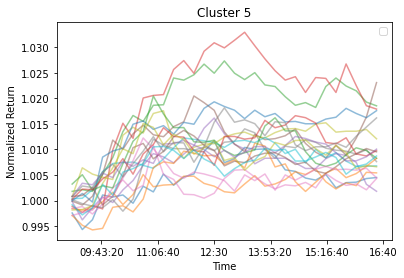

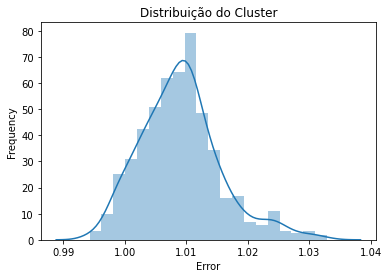

#------------------------------//------------------------------#
Cluster 6
Have 17 days
Representation: 2.59
Accumulated Representation: 80.79
Absolute Error: 0.0719
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 11:15:00
Upward Trend 13:45:00


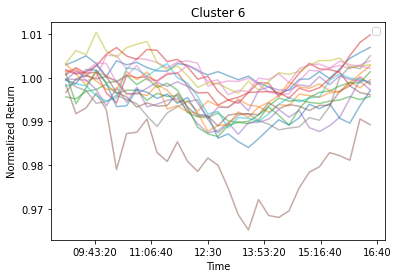

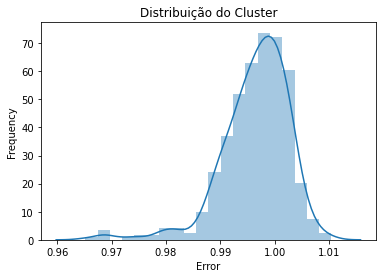

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1811
----------//----------
Studied Month:  2016-10-03
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  677
Plot the Clusters Formed
Cluster 0
Have 233 days
Representation: 34.42
Accumulated Representation: 34.42
Absolute Error: 0.0246
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


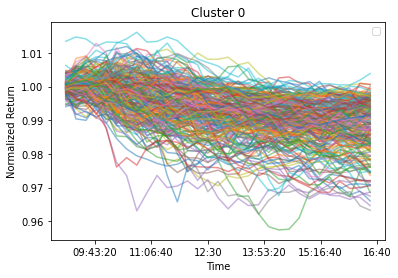

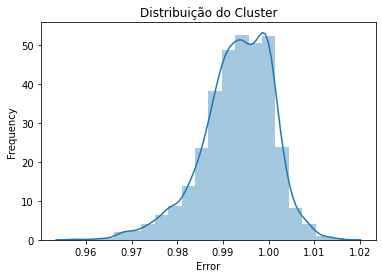

#------------------------------//------------------------------#
Cluster 1
Have 212 days
Representation: 31.31
Accumulated Representation: 65.73
Absolute Error: 0.0200
Mean Square Error: 0.0006
Upward Trend 09:15:00


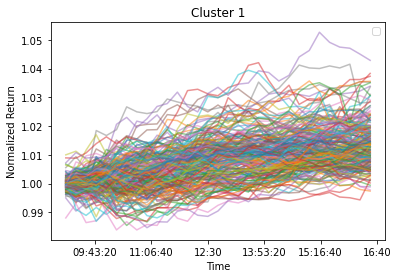

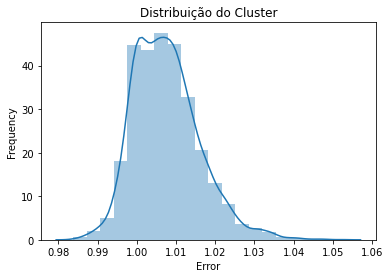

#------------------------------//------------------------------#
Cluster 2
Have 54 days
Representation: 7.98
Accumulated Representation: 73.71
Absolute Error: 0.0796
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 12:15:00


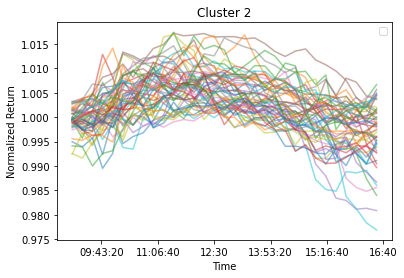

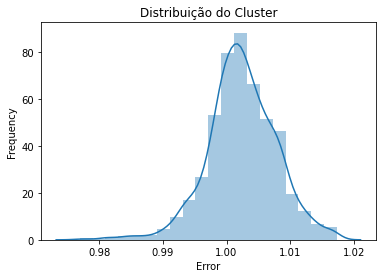

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.69
Accumulated Representation: 77.40
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


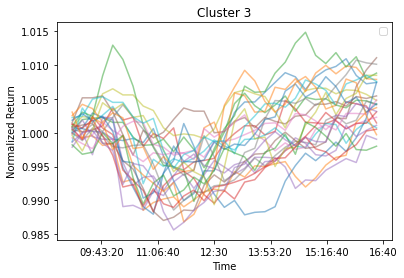

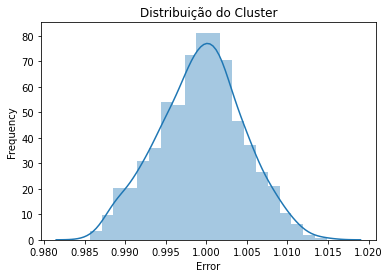

#------------------------------//------------------------------#
Cluster 4
Have 20 days
Representation: 2.95
Accumulated Representation: 80.35
Absolute Error: 0.0792
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:00:00
Upward Trend 15:00:00


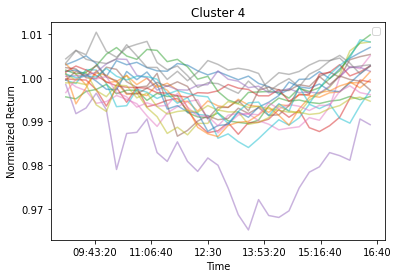

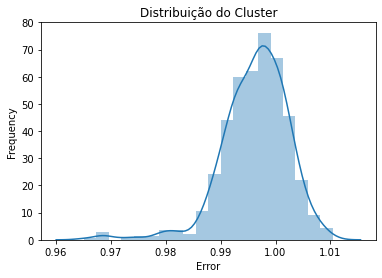

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2187
----------//----------
Studied Month:  2016-11-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  697
Plot the Clusters Formed
Cluster 0
Have 243 days
Representation: 34.86
Accumulated Representation: 34.86
Absolute Error: 0.0272
Mean Square Error: 0.0009
Upward Trend 09:15:00
Downtrend 10:00:00


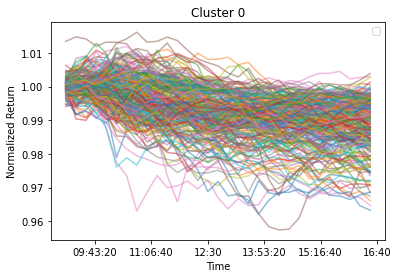

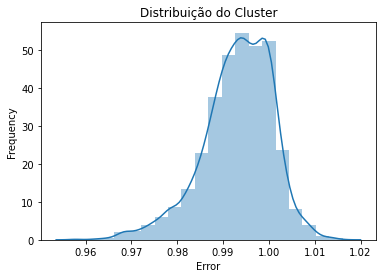

#------------------------------//------------------------------#
Cluster 1
Have 217 days
Representation: 31.13
Accumulated Representation: 66.00
Absolute Error: 0.0209
Mean Square Error: 0.0007
Upward Trend 09:15:00


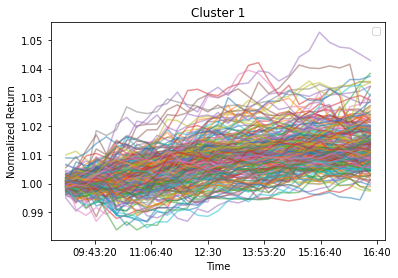

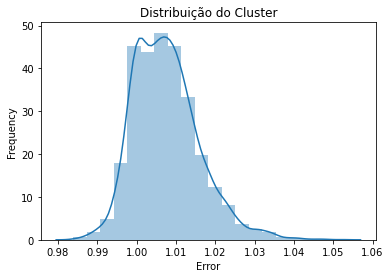

#------------------------------//------------------------------#
Cluster 2
Have 56 days
Representation: 8.03
Accumulated Representation: 74.03
Absolute Error: 0.0789
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:30:00


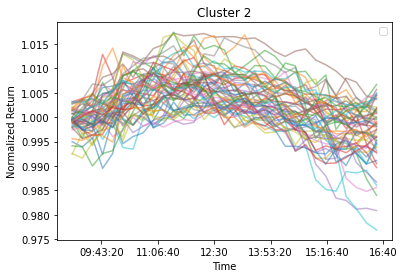

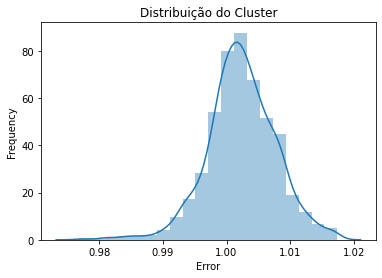

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.59
Accumulated Representation: 77.62
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


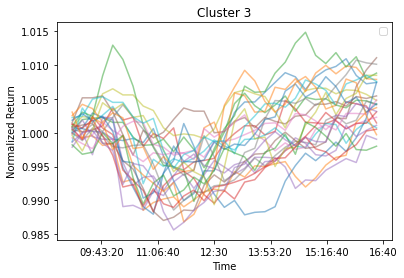

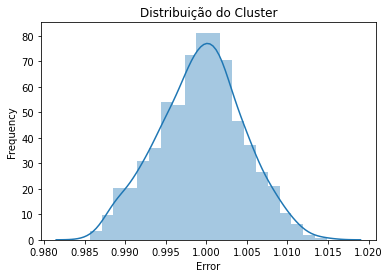

#------------------------------//------------------------------#
Cluster 4
Have 21 days
Representation: 3.01
Accumulated Representation: 80.63
Absolute Error: 0.0500
Mean Square Error: 0.0016
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 12:15:00


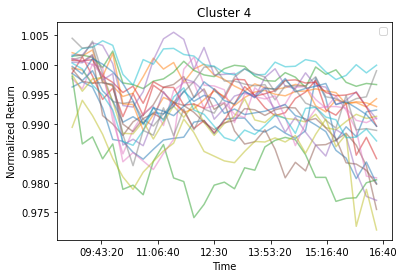

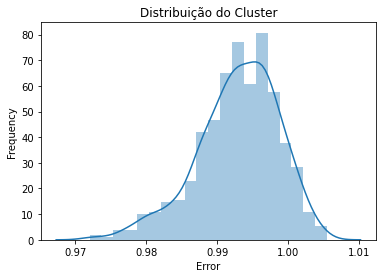

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2133
----------//----------
Studied Month:  2016-12-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  717
Plot the Clusters Formed
Cluster 0
Have 263 days
Representation: 36.68
Accumulated Representation: 36.68
Absolute Error: 0.0238
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


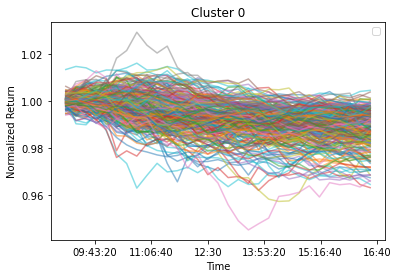

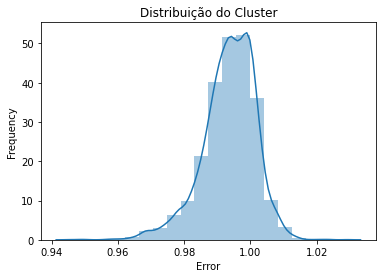

#------------------------------//------------------------------#
Cluster 1
Have 222 days
Representation: 30.96
Accumulated Representation: 67.64
Absolute Error: 0.0209
Mean Square Error: 0.0007
Upward Trend 09:15:00


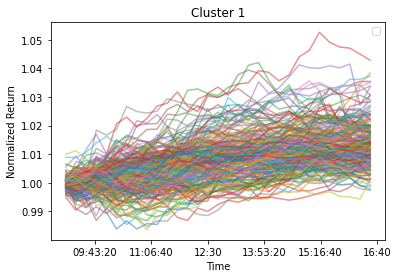

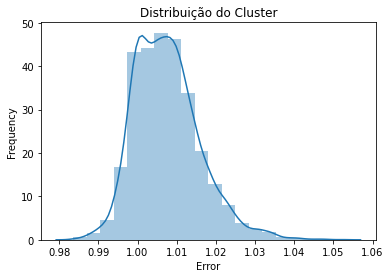

#------------------------------//------------------------------#
Cluster 2
Have 38 days
Representation: 5.30
Accumulated Representation: 72.94
Absolute Error: 0.0893
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


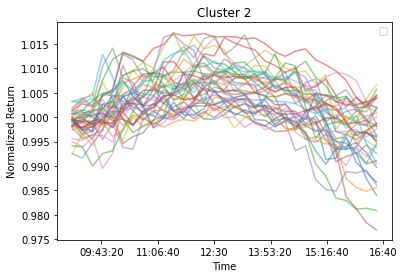

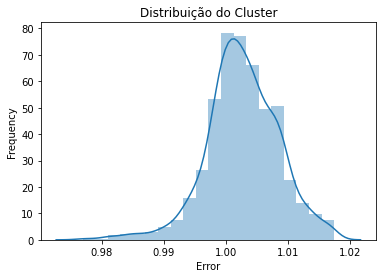

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.49
Accumulated Representation: 76.43
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


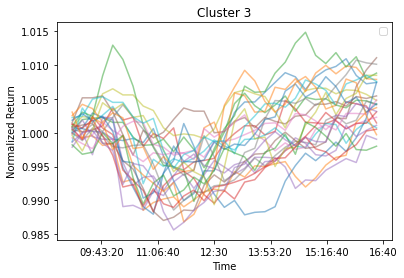

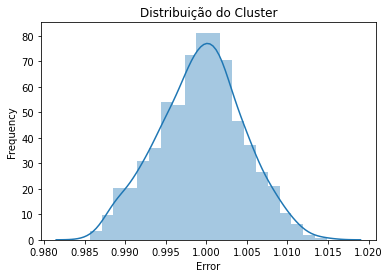

#------------------------------//------------------------------#
Cluster 4
Have 19 days
Representation: 2.65
Accumulated Representation: 79.08
Absolute Error: 0.0579
Mean Square Error: 0.0019
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:45:00
Upward Trend 15:30:00


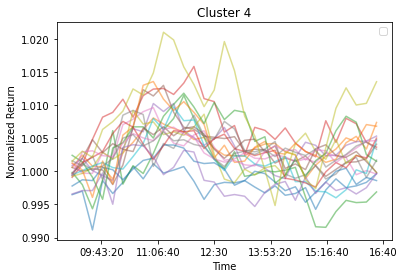

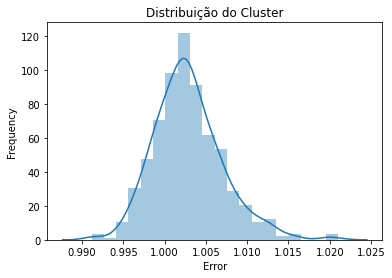

#------------------------------//------------------------------#
Cluster 5
Have 16 days
Representation: 2.23
Accumulated Representation: 81.31
Absolute Error: 0.0516
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 15:00:00


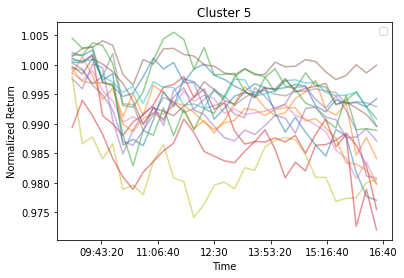

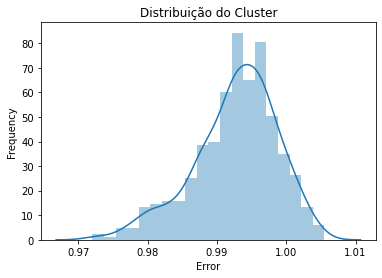

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  577
----------//----------
Studied Month:  2017-01-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  738
Plot the Clusters Formed
Cluster 0
Have 246 days
Representation: 33.33
Accumulated Representation: 33.33
Absolute Error: 0.0301
Mean Square Error: 0.0010
Upward Trend 09:15:00
Downtrend 10:00:00


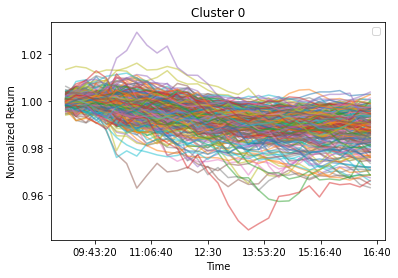

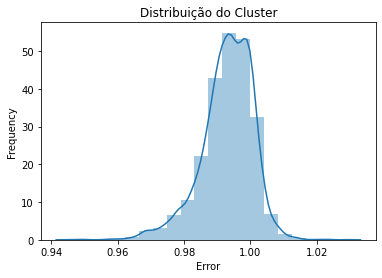

#------------------------------//------------------------------#
Cluster 1
Have 230 days
Representation: 31.17
Accumulated Representation: 64.50
Absolute Error: 0.0213
Mean Square Error: 0.0007
Upward Trend 09:15:00


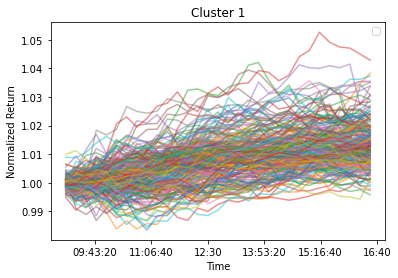

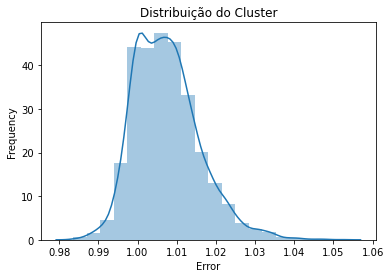

#------------------------------//------------------------------#
Cluster 2
Have 70 days
Representation: 9.49
Accumulated Representation: 73.98
Absolute Error: 0.0783
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:15:00


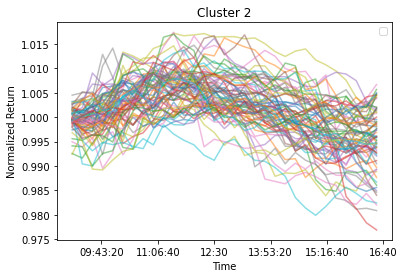

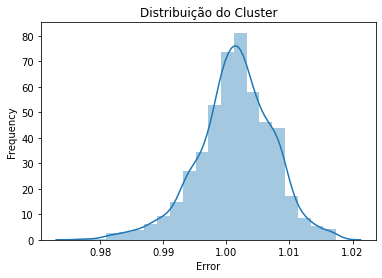

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 3.52
Accumulated Representation: 77.51
Absolute Error: 0.0406
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 13:45:00


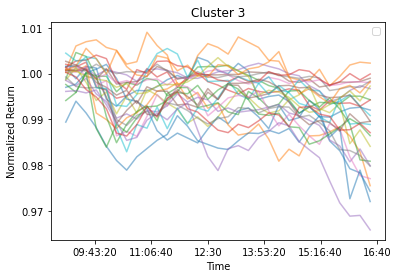

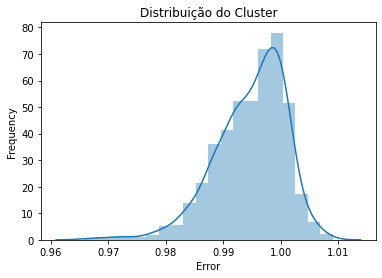

#------------------------------//------------------------------#
Cluster 4
Have 25 days
Representation: 3.39
Accumulated Representation: 80.89
Absolute Error: 0.0697
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


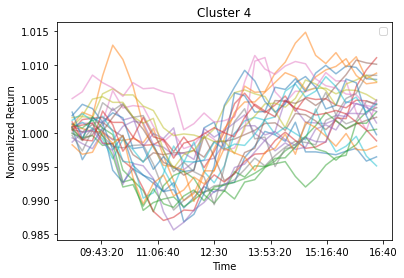

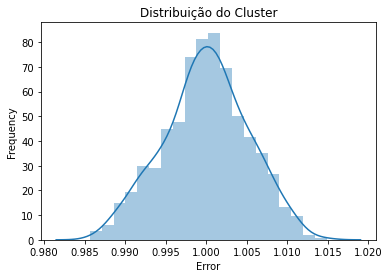

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  587
----------//----------
Studied Month:  2017-02-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  759
Plot the Clusters Formed
Cluster 0
Have 253 days
Representation: 33.33
Accumulated Representation: 33.33
Absolute Error: 0.0310
Mean Square Error: 0.0010
Upward Trend 09:15:00
Downtrend 10:00:00


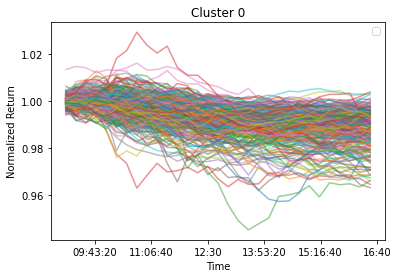

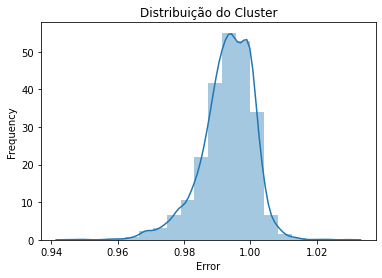

#------------------------------//------------------------------#
Cluster 1
Have 240 days
Representation: 31.62
Accumulated Representation: 64.95
Absolute Error: 0.0203
Mean Square Error: 0.0007
Upward Trend 09:15:00


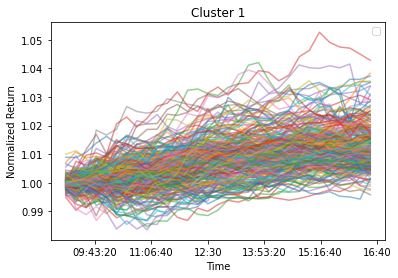

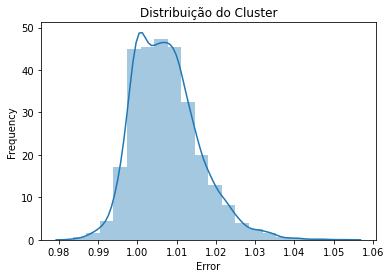

#------------------------------//------------------------------#
Cluster 2
Have 70 days
Representation: 9.22
Accumulated Representation: 74.18
Absolute Error: 0.0783
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:15:00


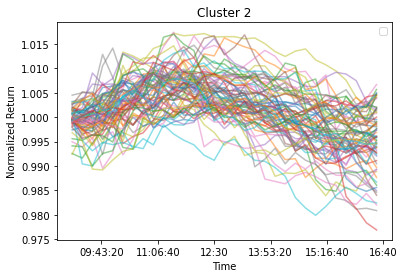

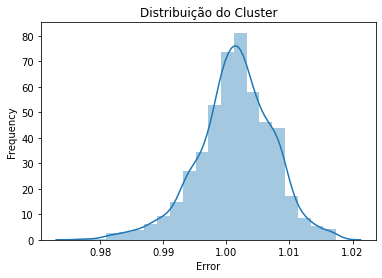

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.29
Accumulated Representation: 77.47
Absolute Error: 0.0412
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 13:45:00


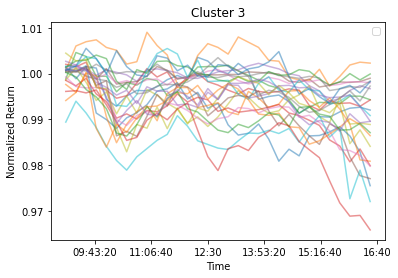

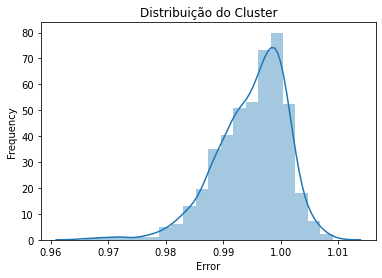

#------------------------------//------------------------------#
Cluster 4
Have 25 days
Representation: 3.29
Accumulated Representation: 80.76
Absolute Error: 0.0697
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


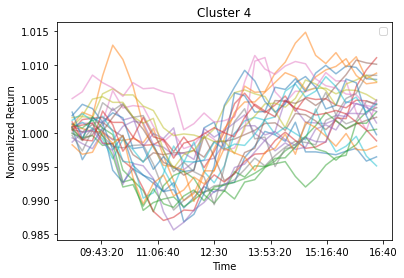

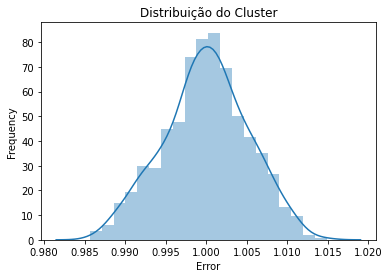

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2222
----------//----------
Studied Month:  2017-03-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  777
Plot the Clusters Formed
Cluster 0
Have 256 days
Representation: 32.95
Accumulated Representation: 32.95
Absolute Error: 0.0217
Mean Square Error: 0.0007
Upward Trend 09:15:00


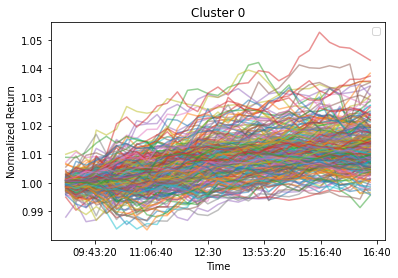

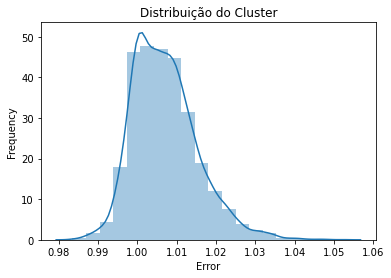

#------------------------------//------------------------------#
Cluster 1
Have 233 days
Representation: 29.99
Accumulated Representation: 62.93
Absolute Error: 0.0176
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


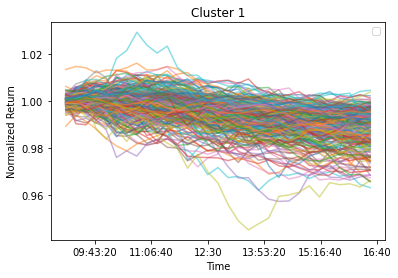

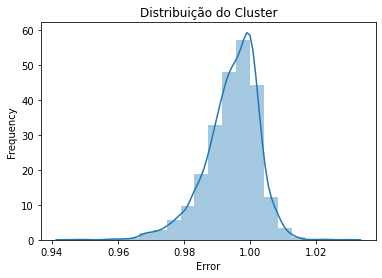

#------------------------------//------------------------------#
Cluster 2
Have 98 days
Representation: 12.61
Accumulated Representation: 75.55
Absolute Error: 0.0673
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 14:00:00


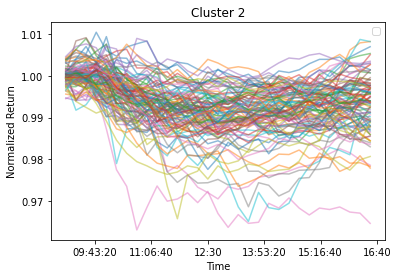

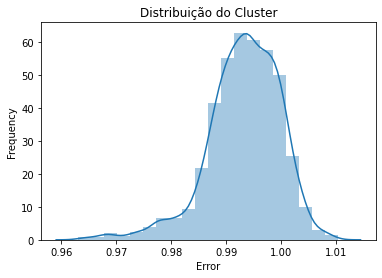

#------------------------------//------------------------------#
Cluster 3
Have 47 days
Representation: 6.05
Accumulated Representation: 81.60
Absolute Error: 0.0825
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 13:45:00


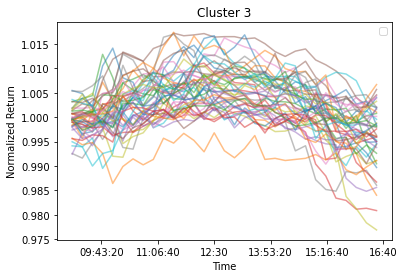

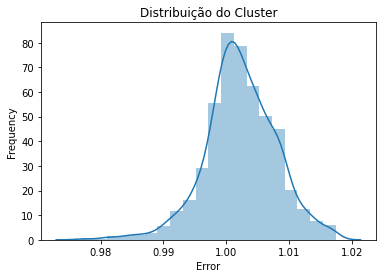

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  173
----------//----------
Studied Month:  2017-04-03
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  799
Plot the Clusters Formed
Cluster 0
Have 243 days
Representation: 30.41
Accumulated Representation: 30.41
Absolute Error: 0.0190
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


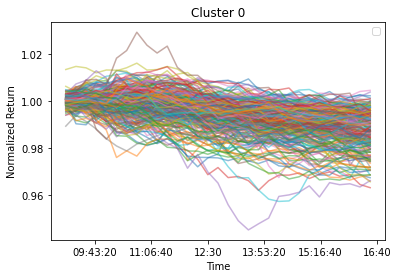

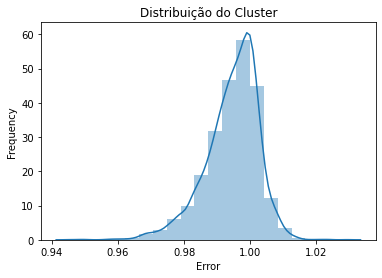

#------------------------------//------------------------------#
Cluster 1
Have 243 days
Representation: 30.41
Accumulated Representation: 60.83
Absolute Error: 0.0178
Mean Square Error: 0.0006
Upward Trend 09:15:00


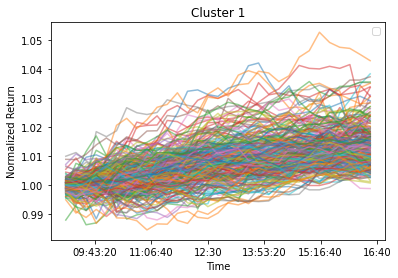

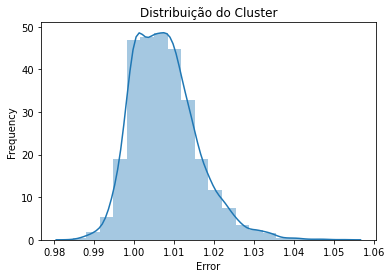

#------------------------------//------------------------------#
Cluster 2
Have 92 days
Representation: 11.51
Accumulated Representation: 72.34
Absolute Error: 0.0702
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 14:00:00


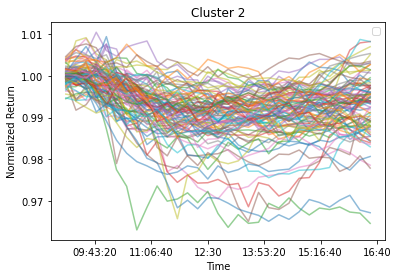

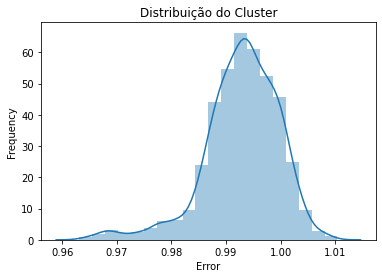

#------------------------------//------------------------------#
Cluster 3
Have 41 days
Representation: 5.13
Accumulated Representation: 77.47
Absolute Error: 0.0883
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:00:00


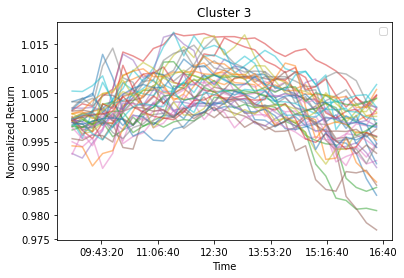

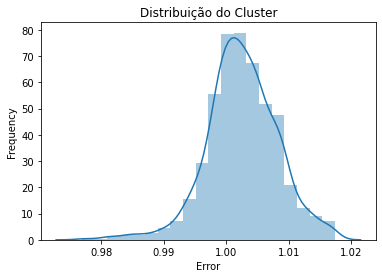

#------------------------------//------------------------------#
Cluster 4
Have 29 days
Representation: 3.63
Accumulated Representation: 81.10
Absolute Error: 0.0653
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


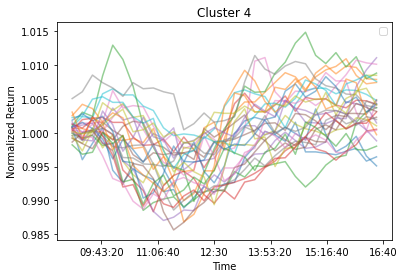

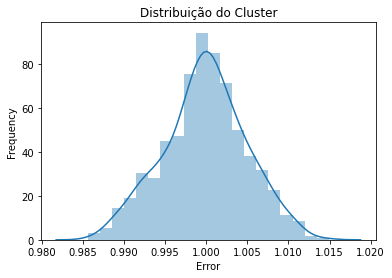

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  902
----------//----------
Studied Month:  2017-05-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  817
Plot the Clusters Formed
Cluster 0
Have 322 days
Representation: 39.41
Accumulated Representation: 39.41
Absolute Error: 0.0225
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


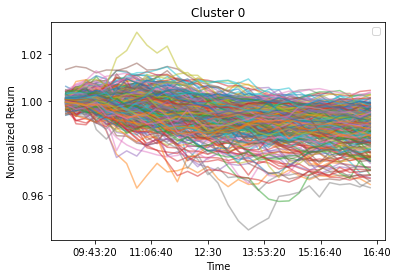

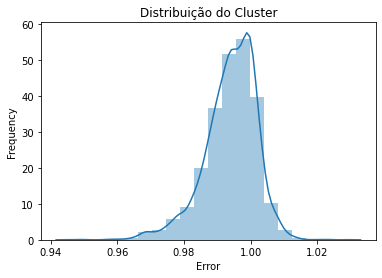

#------------------------------//------------------------------#
Cluster 1
Have 246 days
Representation: 30.11
Accumulated Representation: 69.52
Absolute Error: 0.0179
Mean Square Error: 0.0006
Upward Trend 09:15:00


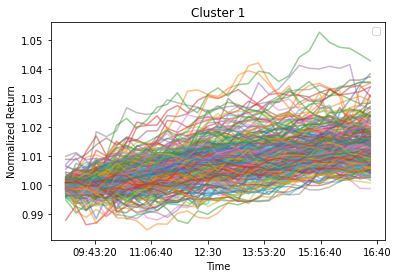

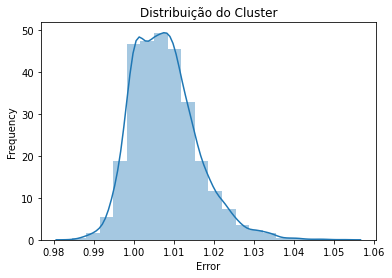

#------------------------------//------------------------------#
Cluster 2
Have 42 days
Representation: 5.14
Accumulated Representation: 74.66
Absolute Error: 0.0894
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


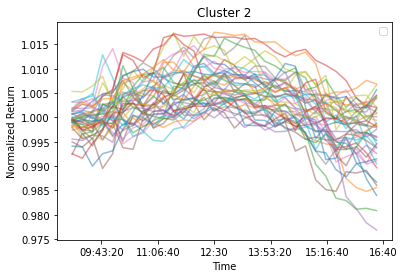

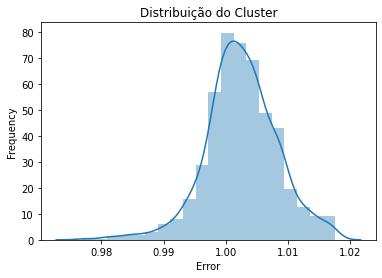

#------------------------------//------------------------------#
Cluster 3
Have 31 days
Representation: 3.79
Accumulated Representation: 78.46
Absolute Error: 0.0657
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


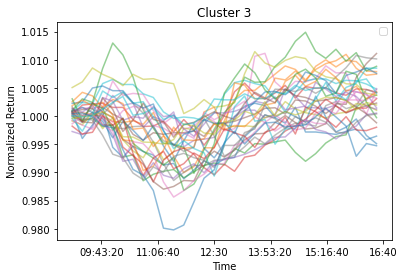

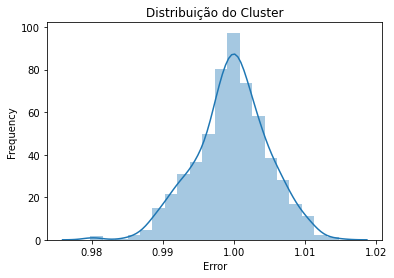

#------------------------------//------------------------------#
Cluster 4
Have 24 days
Representation: 2.94
Accumulated Representation: 81.40
Absolute Error: 0.0646
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:15:00
Downtrend 14:15:00


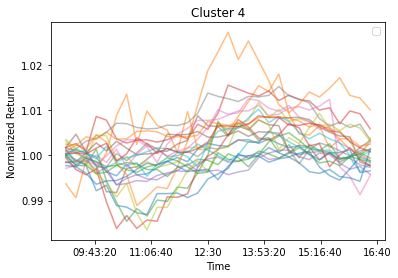

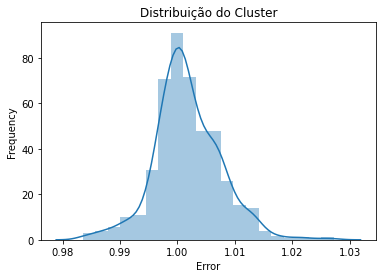

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -404
----------//----------
Studied Month:  2017-06-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  839
Plot the Clusters Formed
Cluster 0
Have 299 days
Representation: 35.64
Accumulated Representation: 35.64
Absolute Error: 0.0172
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


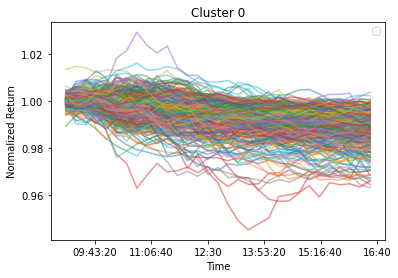

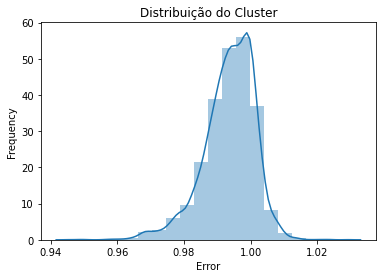

#------------------------------//------------------------------#
Cluster 1
Have 251 days
Representation: 29.92
Accumulated Representation: 65.55
Absolute Error: 0.0187
Mean Square Error: 0.0006
Upward Trend 09:15:00


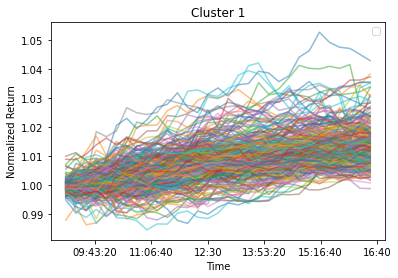

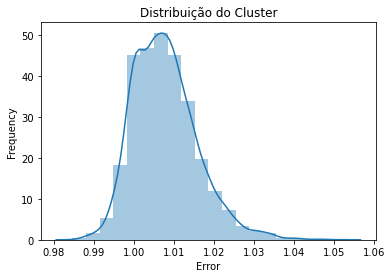

#------------------------------//------------------------------#
Cluster 2
Have 55 days
Representation: 6.56
Accumulated Representation: 72.11
Absolute Error: 0.0666
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


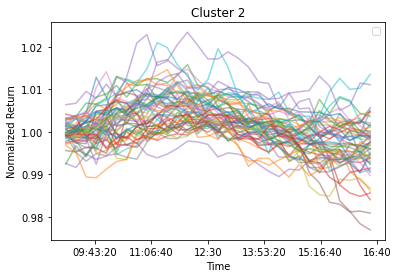

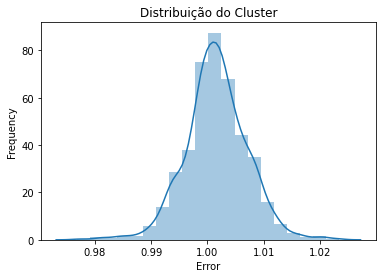

#------------------------------//------------------------------#
Cluster 3
Have 44 days
Representation: 5.24
Accumulated Representation: 77.35
Absolute Error: 0.0612
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:00:00


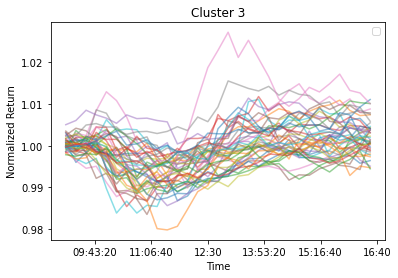

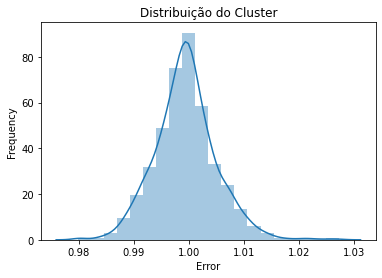

#------------------------------//------------------------------#
Cluster 4
Have 42 days
Representation: 5.01
Accumulated Representation: 82.36
Absolute Error: 0.0798
Mean Square Error: 0.0026
Downtrend 09:15:00
Upward Trend 14:00:00


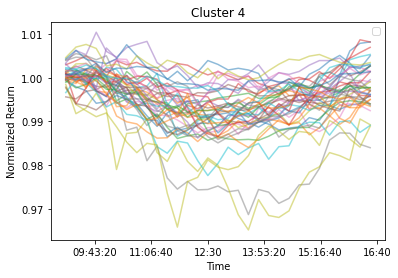

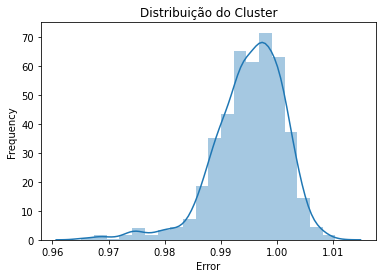

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1133
----------//----------
Studied Month:  2017-07-03
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  860
Plot the Clusters Formed
Cluster 0
Have 301 days
Representation: 35.00
Accumulated Representation: 35.00
Absolute Error: 0.0194
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


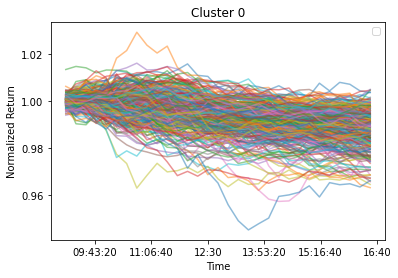

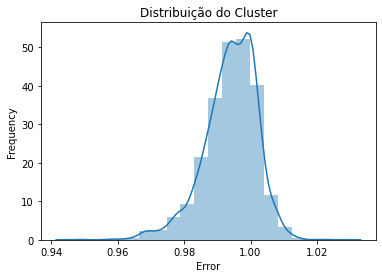

#------------------------------//------------------------------#
Cluster 1
Have 266 days
Representation: 30.93
Accumulated Representation: 65.93
Absolute Error: 0.0200
Mean Square Error: 0.0006
Upward Trend 09:15:00


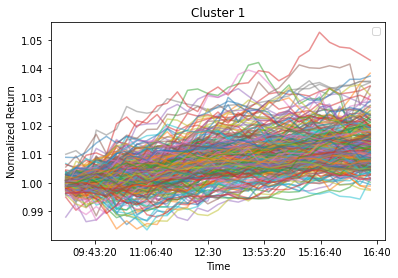

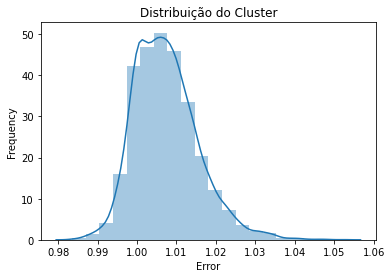

#------------------------------//------------------------------#
Cluster 2
Have 43 days
Representation: 5.00
Accumulated Representation: 70.93
Absolute Error: 0.0783
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 12:45:00


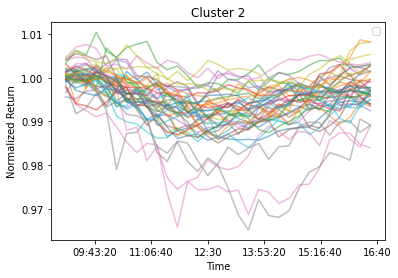

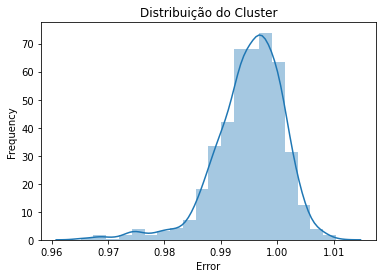

#------------------------------//------------------------------#
Cluster 3
Have 34 days
Representation: 3.95
Accumulated Representation: 74.88
Absolute Error: 0.0634
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 13:15:00


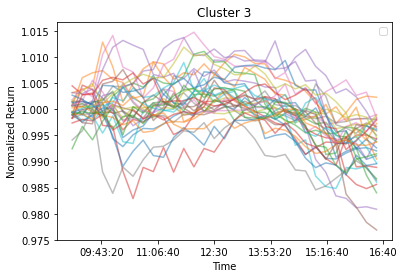

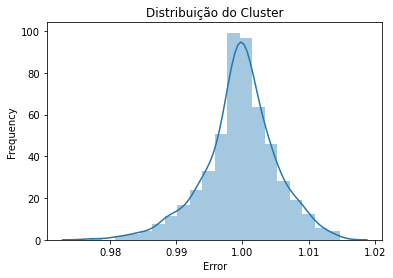

#------------------------------//------------------------------#
Cluster 4
Have 29 days
Representation: 3.37
Accumulated Representation: 78.26
Absolute Error: 0.0875
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:00:00


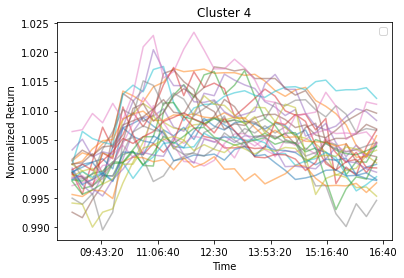

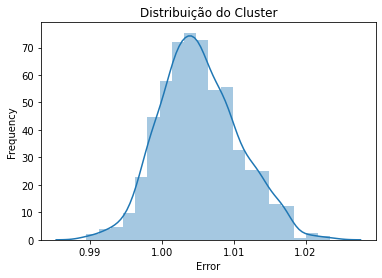

#------------------------------//------------------------------#
Cluster 5
Have 27 days
Representation: 3.14
Accumulated Representation: 81.40
Absolute Error: 0.0729
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00


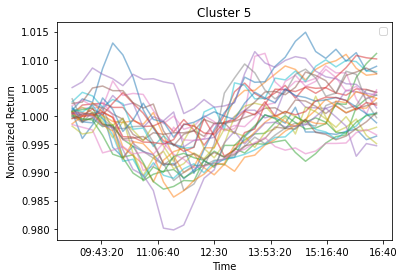

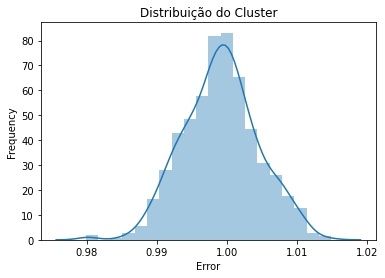

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -151
----------//----------
Studied Month:  2017-08-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  881
Plot the Clusters Formed
Cluster 0
Have 330 days
Representation: 37.46
Accumulated Representation: 37.46
Absolute Error: 0.0219
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


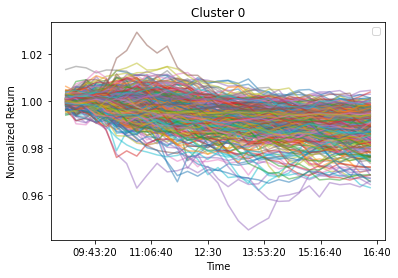

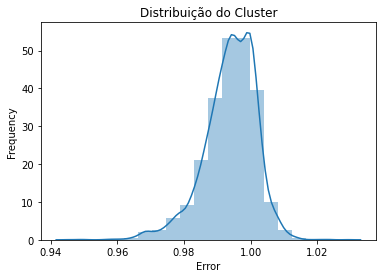

#------------------------------//------------------------------#
Cluster 1
Have 309 days
Representation: 35.07
Accumulated Representation: 72.53
Absolute Error: 0.0186
Mean Square Error: 0.0006
Upward Trend 09:15:00


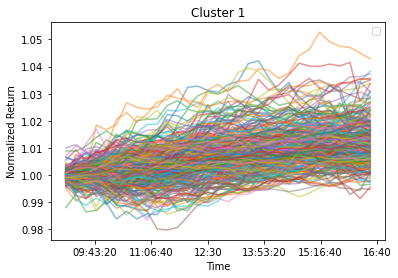

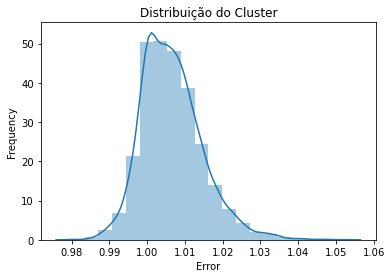

#------------------------------//------------------------------#
Cluster 2
Have 46 days
Representation: 5.22
Accumulated Representation: 77.75
Absolute Error: 0.0864
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:15:00


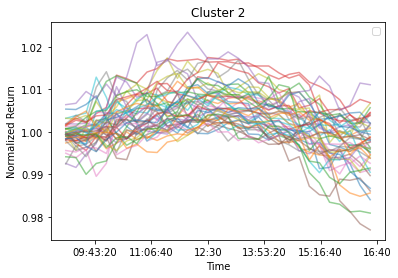

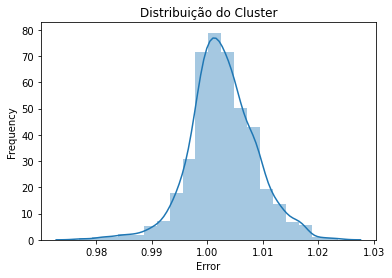

#------------------------------//------------------------------#
Cluster 3
Have 18 days
Representation: 2.04
Accumulated Representation: 79.80
Absolute Error: 0.0538
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:00:00


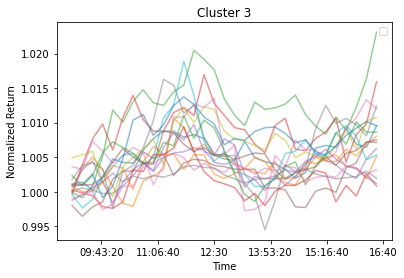

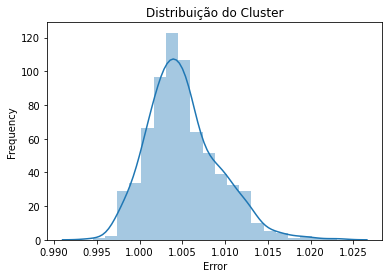

#------------------------------//------------------------------#
Cluster 4
Have 18 days
Representation: 2.04
Accumulated Representation: 81.84
Absolute Error: 0.0566
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:00:00
Upward Trend 14:00:00


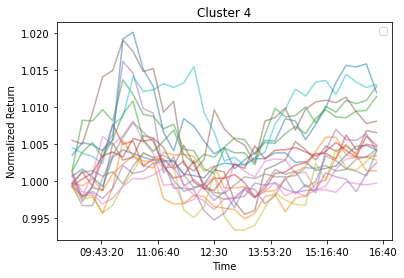

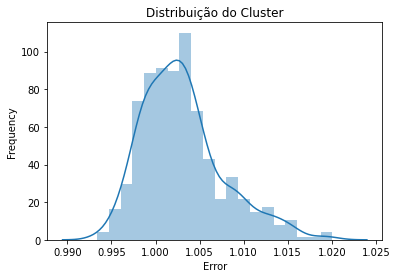

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  432
----------//----------
Studied Month:  2017-09-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  904
Plot the Clusters Formed
Cluster 0
Have 304 days
Representation: 33.63
Accumulated Representation: 33.63
Absolute Error: 0.0223
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


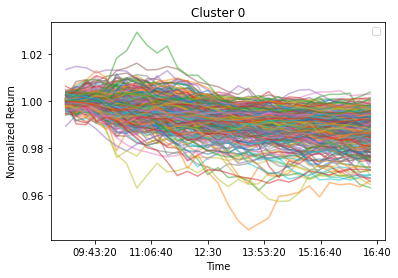

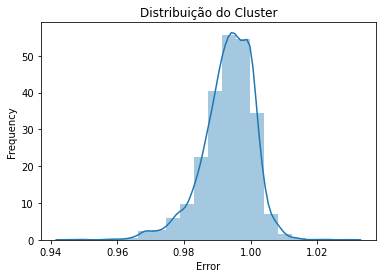

#------------------------------//------------------------------#
Cluster 1
Have 279 days
Representation: 30.86
Accumulated Representation: 64.49
Absolute Error: 0.0197
Mean Square Error: 0.0006
Upward Trend 09:15:00


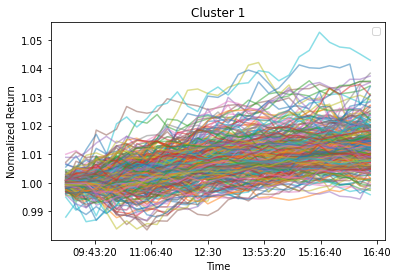

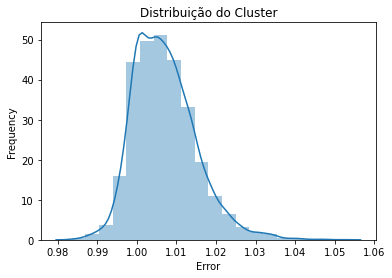

#------------------------------//------------------------------#
Cluster 2
Have 61 days
Representation: 6.75
Accumulated Representation: 71.24
Absolute Error: 0.0647
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


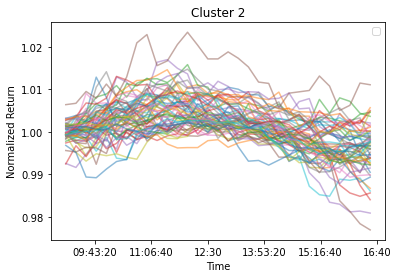

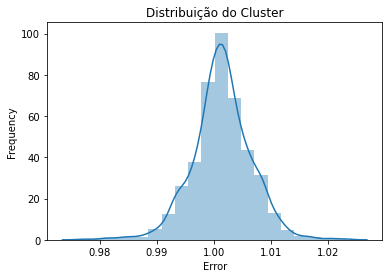

#------------------------------//------------------------------#
Cluster 3
Have 44 days
Representation: 4.87
Accumulated Representation: 76.11
Absolute Error: 0.0794
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 14:15:00


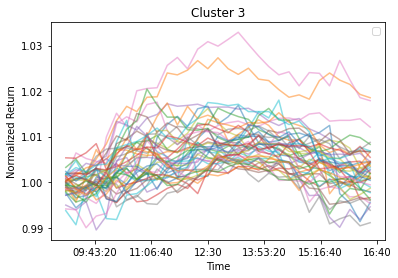

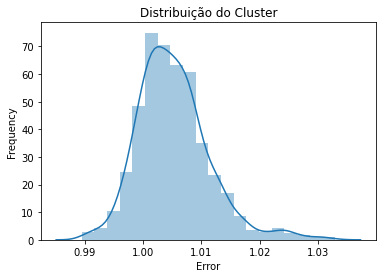

#------------------------------//------------------------------#
Cluster 4
Have 37 days
Representation: 4.09
Accumulated Representation: 80.20
Absolute Error: 0.0704
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


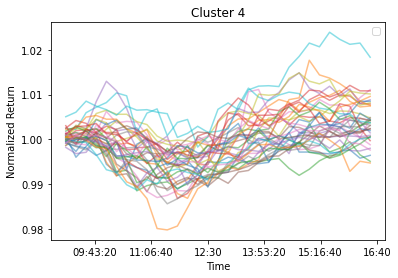

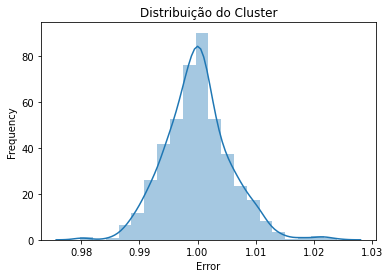

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -1126
----------//----------
Studied Month:  2017-10-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  924
Plot the Clusters Formed
Cluster 0
Have 297 days
Representation: 32.14
Accumulated Representation: 32.14
Absolute Error: 0.0188
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


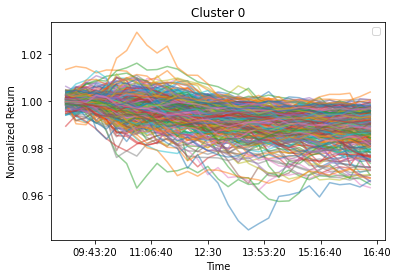

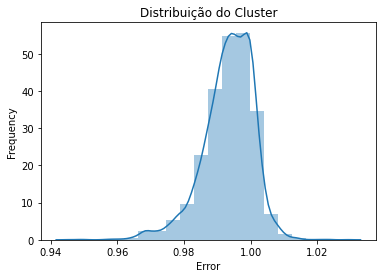

#------------------------------//------------------------------#
Cluster 1
Have 287 days
Representation: 31.06
Accumulated Representation: 63.20
Absolute Error: 0.0185
Mean Square Error: 0.0006
Upward Trend 09:15:00


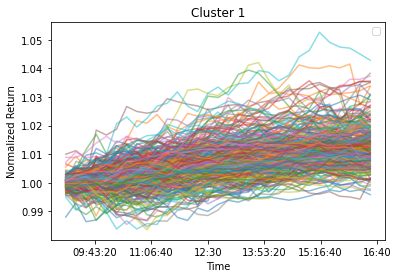

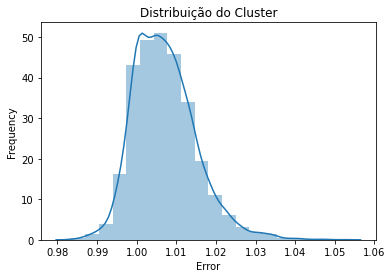

#------------------------------//------------------------------#
Cluster 2
Have 62 days
Representation: 6.71
Accumulated Representation: 69.91
Absolute Error: 0.0619
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00


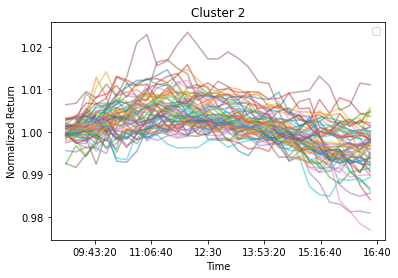

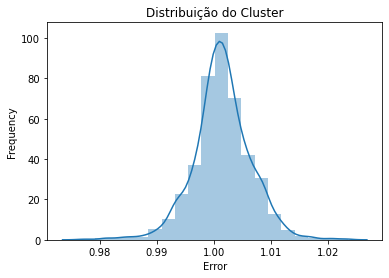

#------------------------------//------------------------------#
Cluster 3
Have 52 days
Representation: 5.63
Accumulated Representation: 75.54
Absolute Error: 0.0771
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 13:15:00


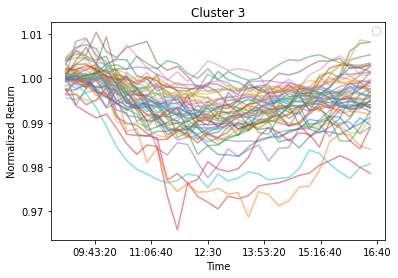

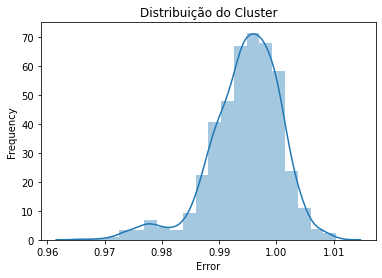

#------------------------------//------------------------------#
Cluster 4
Have 43 days
Representation: 4.65
Accumulated Representation: 80.19
Absolute Error: 0.0796
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 13:45:00


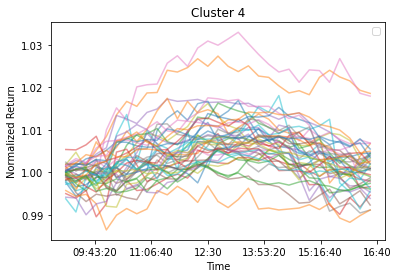

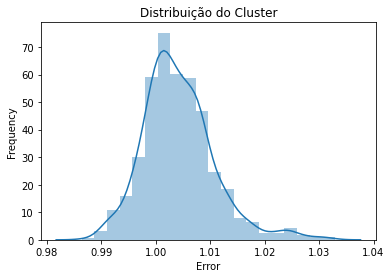

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -297
----------//----------
Studied Month:  2017-11-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  945
Plot the Clusters Formed
Cluster 0
Have 301 days
Representation: 31.85
Accumulated Representation: 31.85
Absolute Error: 0.0210
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


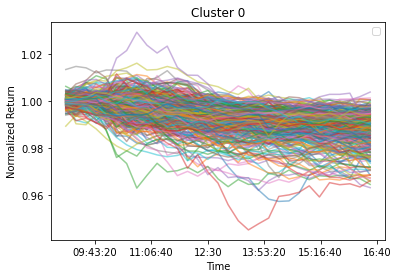

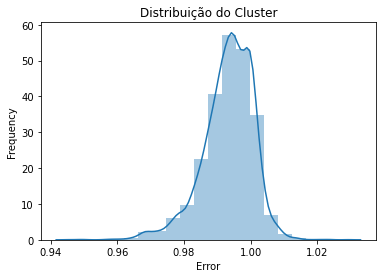

#------------------------------//------------------------------#
Cluster 1
Have 301 days
Representation: 31.85
Accumulated Representation: 63.70
Absolute Error: 0.0183
Mean Square Error: 0.0006
Upward Trend 09:15:00


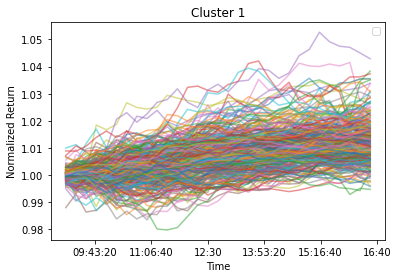

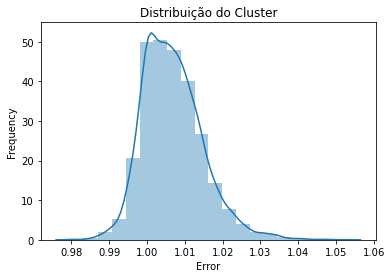

#------------------------------//------------------------------#
Cluster 2
Have 72 days
Representation: 7.62
Accumulated Representation: 71.32
Absolute Error: 0.0618
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00


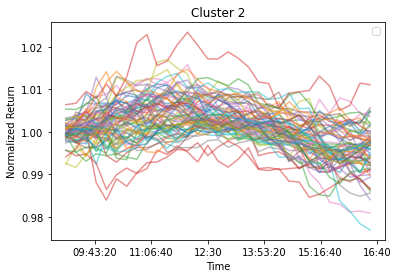

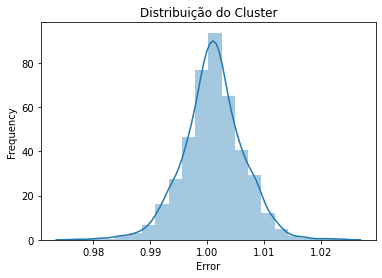

#------------------------------//------------------------------#
Cluster 3
Have 60 days
Representation: 6.35
Accumulated Representation: 77.67
Absolute Error: 0.0765
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 13:15:00


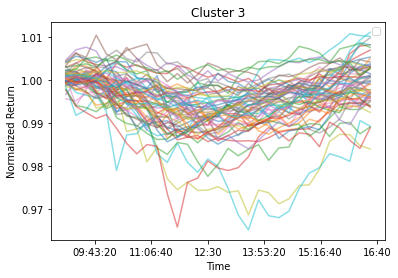

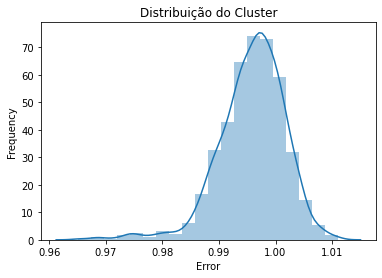

#------------------------------//------------------------------#
Cluster 4
Have 47 days
Representation: 4.97
Accumulated Representation: 82.65
Absolute Error: 0.0758
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 14:15:00


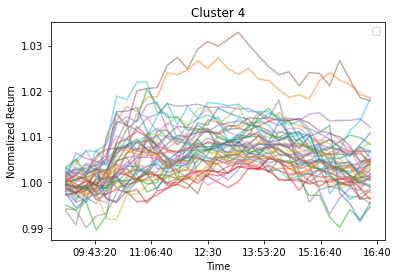

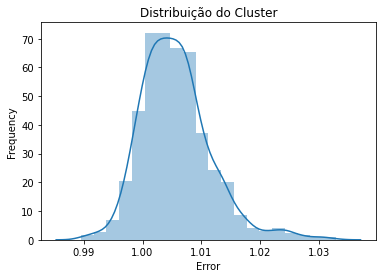

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  -241
----------//----------
Studied Month:  2017-12-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  964
Plot the Clusters Formed
Cluster 0
Have 373 days
Representation: 38.69
Accumulated Representation: 38.69
Absolute Error: 0.0137
Mean Square Error: 0.0004
Upward Trend 09:15:00
Downtrend 10:00:00


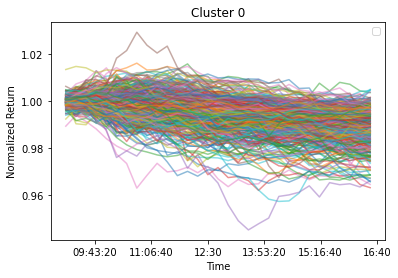

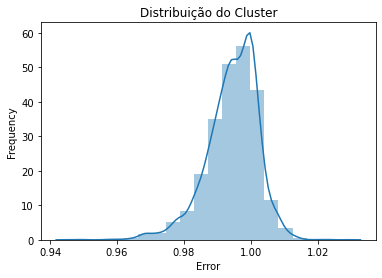

#------------------------------//------------------------------#
Cluster 1
Have 333 days
Representation: 34.54
Accumulated Representation: 73.24
Absolute Error: 0.0183
Mean Square Error: 0.0006
Upward Trend 09:15:00


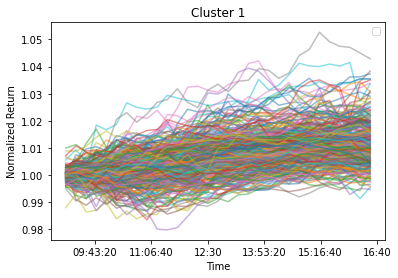

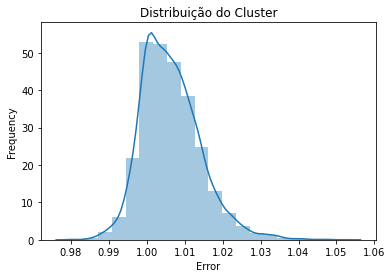

#------------------------------//------------------------------#
Cluster 2
Have 46 days
Representation: 4.77
Accumulated Representation: 78.01
Absolute Error: 0.0797
Mean Square Error: 0.0026
Downtrend 09:15:00
Upward Trend 14:00:00


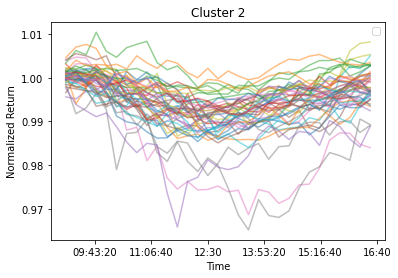

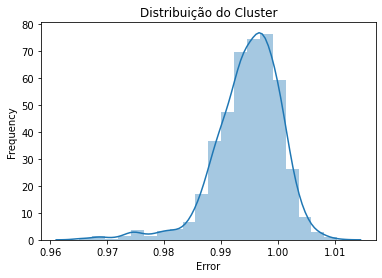

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.67
Accumulated Representation: 82.68
Absolute Error: 0.0826
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 13:45:00


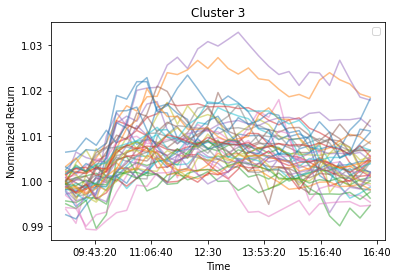

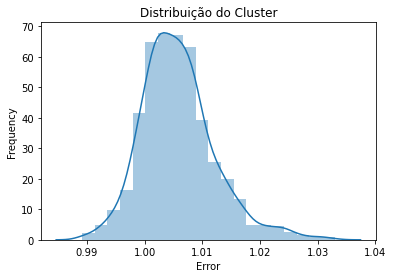

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  854
----------//----------
Studied Month:  2018-01-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  983
Plot the Clusters Formed
Cluster 0
Have 334 days
Representation: 33.98
Accumulated Representation: 33.98
Absolute Error: 0.0194
Mean Square Error: 0.0006
Upward Trend 09:15:00


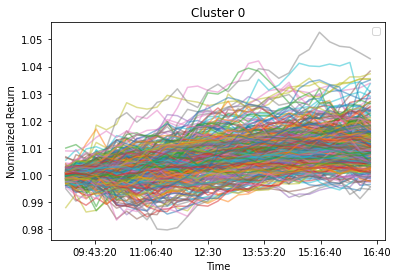

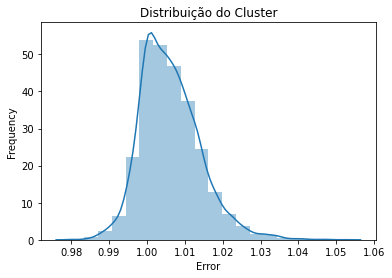

#------------------------------//------------------------------#
Cluster 1
Have 281 days
Representation: 28.59
Accumulated Representation: 62.56
Absolute Error: 0.0259
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


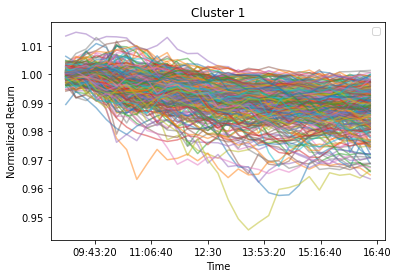

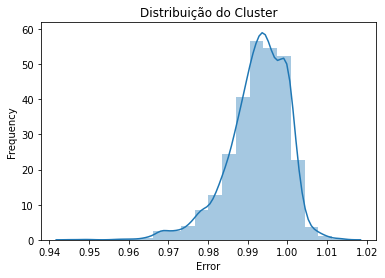

#------------------------------//------------------------------#
Cluster 2
Have 110 days
Representation: 11.19
Accumulated Representation: 73.75
Absolute Error: 0.0551
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 12:00:00


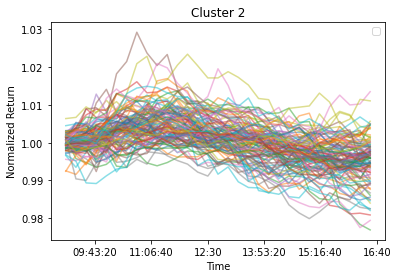

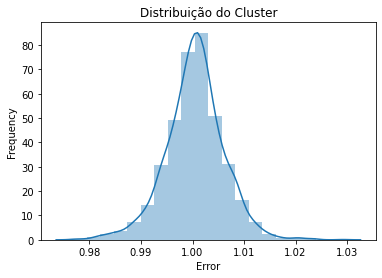

#------------------------------//------------------------------#
Cluster 3
Have 48 days
Representation: 4.88
Accumulated Representation: 78.64
Absolute Error: 0.0758
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


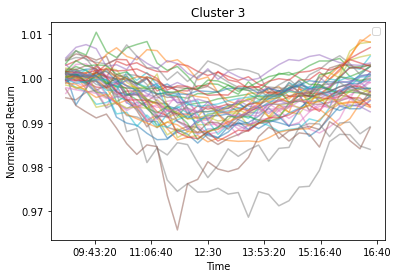

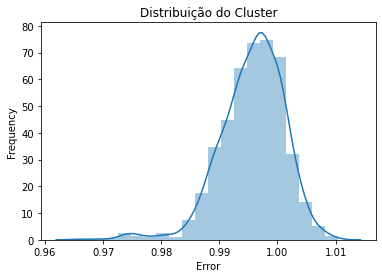

#------------------------------//------------------------------#
Cluster 4
Have 38 days
Representation: 3.87
Accumulated Representation: 82.50
Absolute Error: 0.0807
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


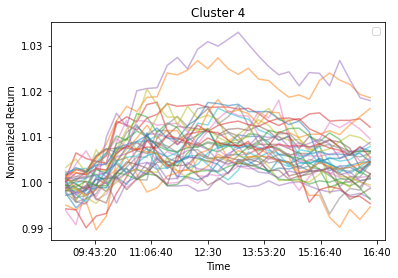

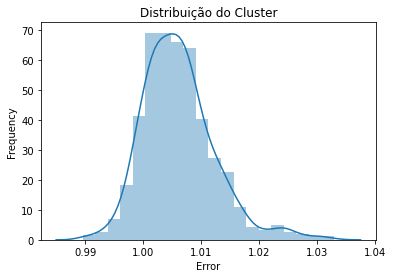

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2339
----------//----------
Studied Month:  2018-02-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1004
Plot the Clusters Formed
Cluster 0
Have 335 days
Representation: 33.37
Accumulated Representation: 33.37
Absolute Error: 0.0188
Mean Square Error: 0.0006
Upward Trend 09:15:00


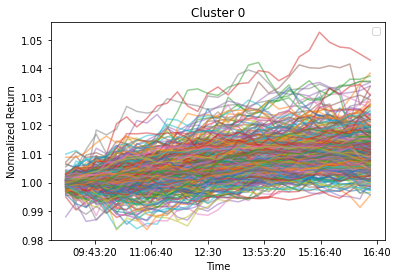

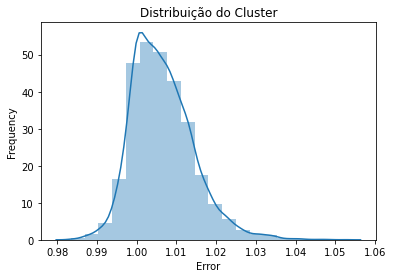

#------------------------------//------------------------------#
Cluster 1
Have 282 days
Representation: 28.09
Accumulated Representation: 61.45
Absolute Error: 0.0258
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


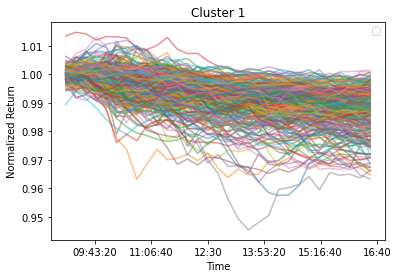

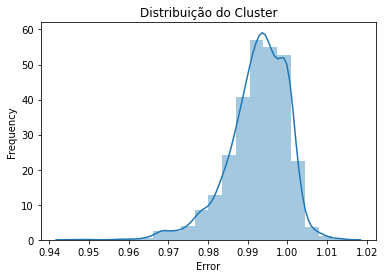

#------------------------------//------------------------------#
Cluster 2
Have 113 days
Representation: 11.25
Accumulated Representation: 72.71
Absolute Error: 0.0544
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 12:00:00


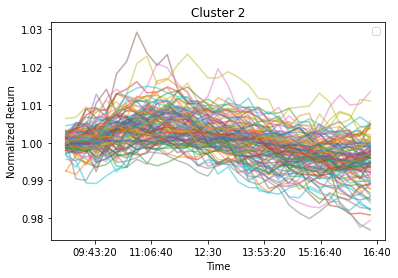

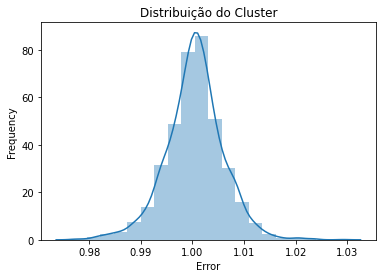

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.48
Accumulated Representation: 77.19
Absolute Error: 0.0757
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


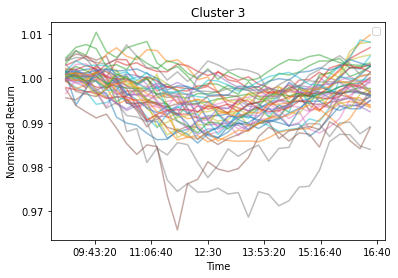

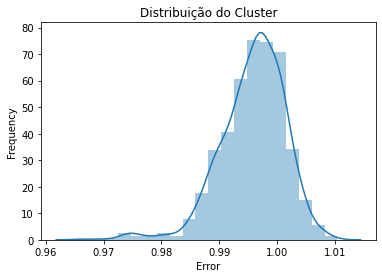

#------------------------------//------------------------------#
Cluster 4
Have 37 days
Representation: 3.69
Accumulated Representation: 80.88
Absolute Error: 0.0823
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


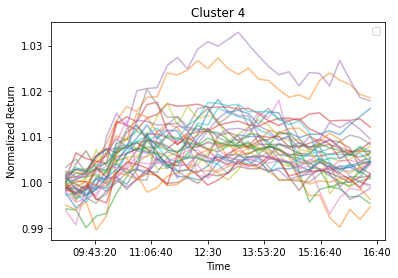

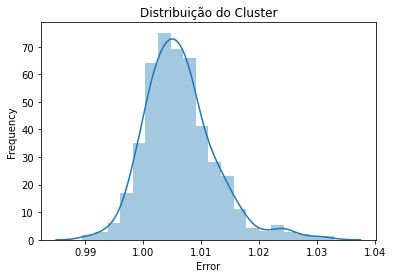

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  596
----------//----------
Studied Month:  2018-03-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1021
Plot the Clusters Formed
Cluster 0
Have 343 days
Representation: 33.59
Accumulated Representation: 33.59
Absolute Error: 0.0193
Mean Square Error: 0.0006
Upward Trend 09:15:00


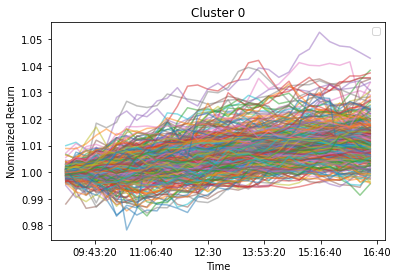

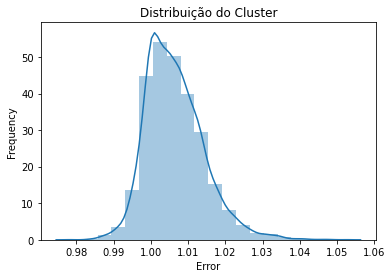

#------------------------------//------------------------------#
Cluster 1
Have 311 days
Representation: 30.46
Accumulated Representation: 64.05
Absolute Error: 0.0316
Mean Square Error: 0.0010
Upward Trend 09:15:00
Downtrend 10:00:00


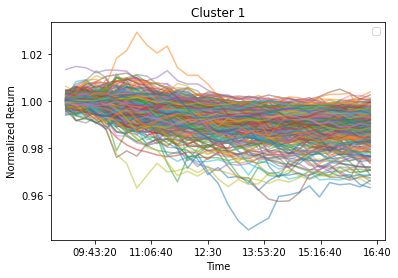

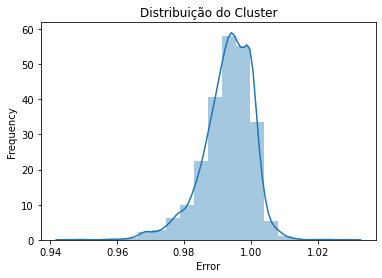

#------------------------------//------------------------------#
Cluster 2
Have 93 days
Representation: 9.11
Accumulated Representation: 73.16
Absolute Error: 0.0627
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:00:00


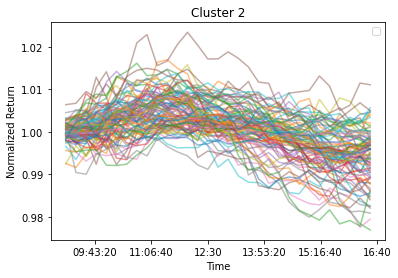

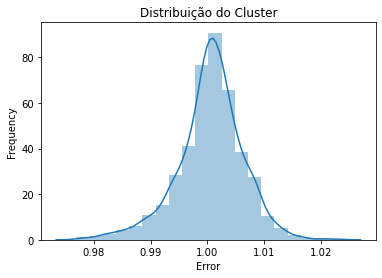

#------------------------------//------------------------------#
Cluster 3
Have 39 days
Representation: 3.82
Accumulated Representation: 76.98
Absolute Error: 0.0804
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


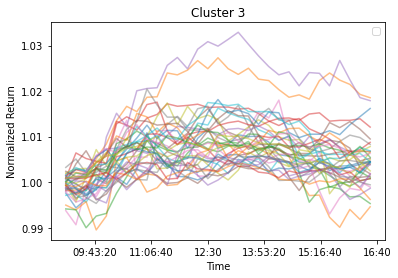

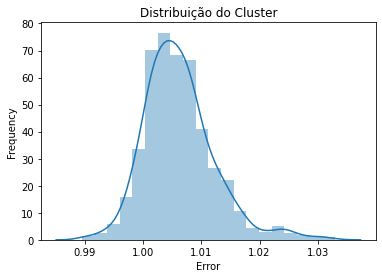

#------------------------------//------------------------------#
Cluster 4
Have 32 days
Representation: 3.13
Accumulated Representation: 80.12
Absolute Error: 0.0630
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00


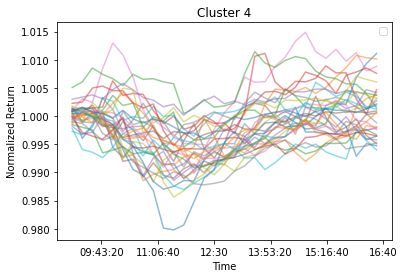

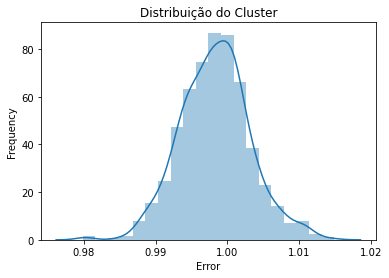

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  946
----------//----------
Studied Month:  2018-04-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1042
Plot the Clusters Formed
Cluster 0
Have 359 days
Representation: 34.45
Accumulated Representation: 34.45
Absolute Error: 0.0188
Mean Square Error: 0.0006
Upward Trend 09:15:00


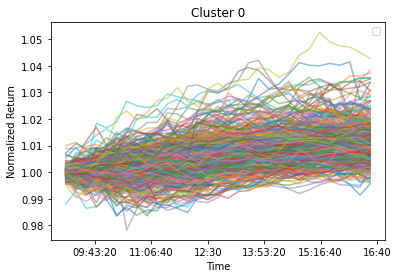

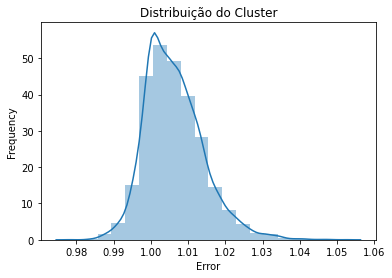

#------------------------------//------------------------------#
Cluster 1
Have 297 days
Representation: 28.50
Accumulated Representation: 62.96
Absolute Error: 0.0288
Mean Square Error: 0.0009
Upward Trend 09:15:00
Downtrend 10:00:00


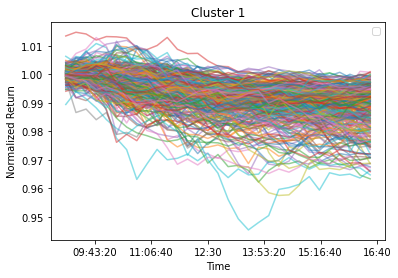

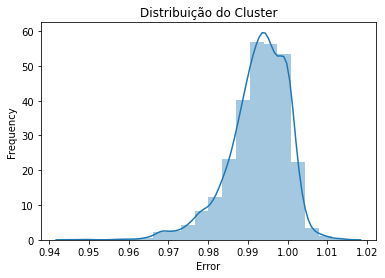

#------------------------------//------------------------------#
Cluster 2
Have 127 days
Representation: 12.19
Accumulated Representation: 75.14
Absolute Error: 0.0550
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:45:00


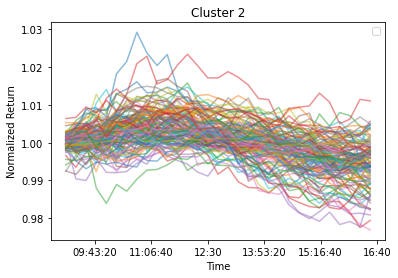

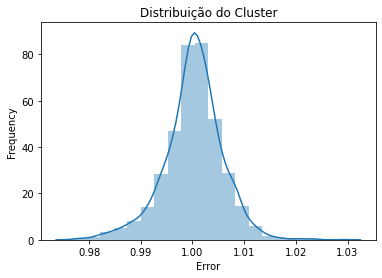

#------------------------------//------------------------------#
Cluster 3
Have 41 days
Representation: 3.93
Accumulated Representation: 79.08
Absolute Error: 0.0691
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 13:15:00


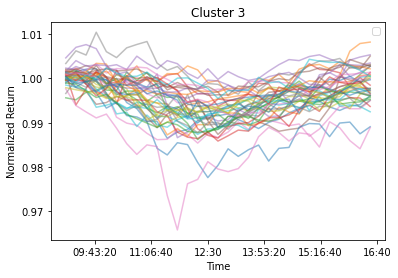

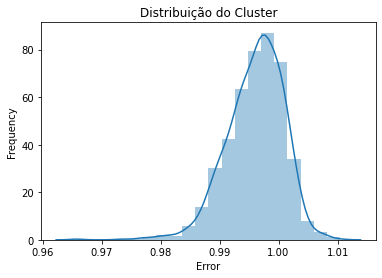

#------------------------------//------------------------------#
Cluster 4
Have 38 days
Representation: 3.65
Accumulated Representation: 82.73
Absolute Error: 0.0744
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 14:15:00


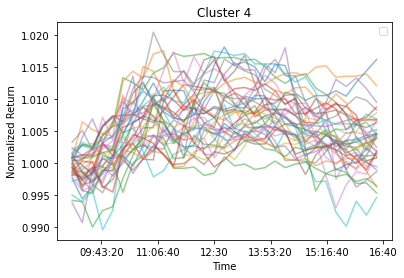

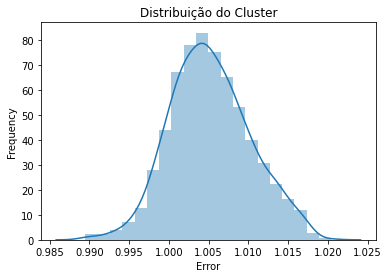

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2880
----------//----------
Studied Month:  2018-05-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1063
Plot the Clusters Formed
Cluster 0
Have 416 days
Representation: 39.13
Accumulated Representation: 39.13
Absolute Error: 0.0135
Mean Square Error: 0.0004
Upward Trend 09:15:00
Downtrend 10:00:00


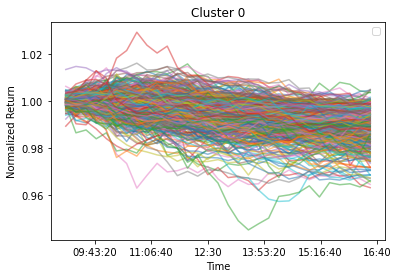

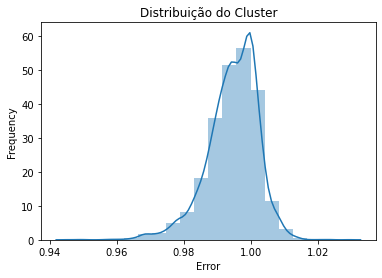

#------------------------------//------------------------------#
Cluster 1
Have 341 days
Representation: 32.08
Accumulated Representation: 71.21
Absolute Error: 0.0231
Mean Square Error: 0.0007
Upward Trend 09:15:00


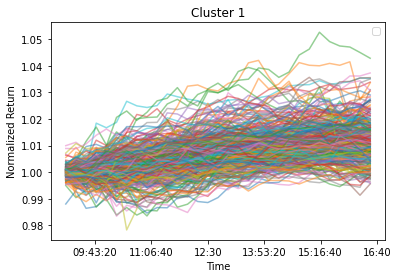

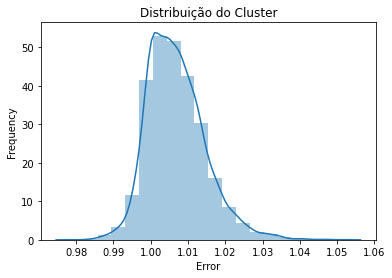

#------------------------------//------------------------------#
Cluster 2
Have 76 days
Representation: 7.15
Accumulated Representation: 78.36
Absolute Error: 0.0732
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


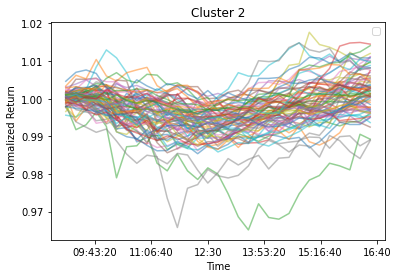

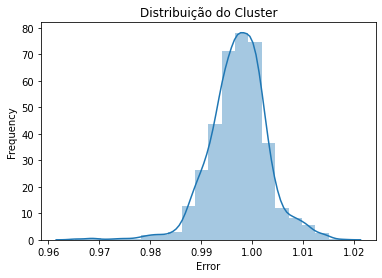

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.23
Accumulated Representation: 82.60
Absolute Error: 0.0733
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:30:00


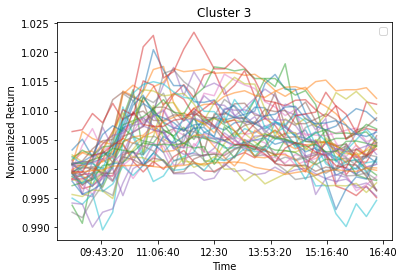

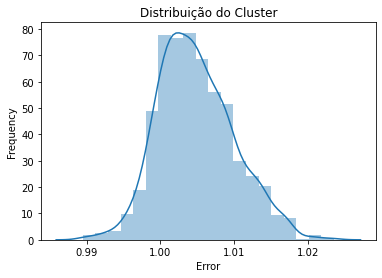

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  435
----------//----------
Studied Month:  2018-06-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1084
Plot the Clusters Formed
Cluster 0
Have 382 days
Representation: 35.24
Accumulated Representation: 35.24
Absolute Error: 0.0183
Mean Square Error: 0.0006
Upward Trend 09:15:00


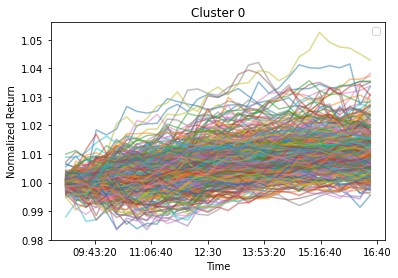

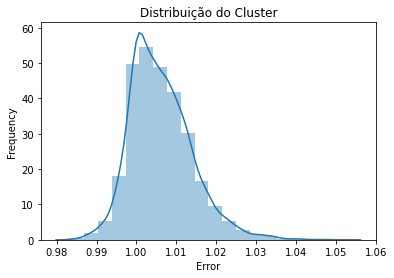

#------------------------------//------------------------------#
Cluster 1
Have 371 days
Representation: 34.23
Accumulated Representation: 69.46
Absolute Error: 0.0216
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


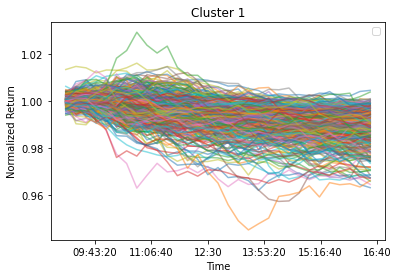

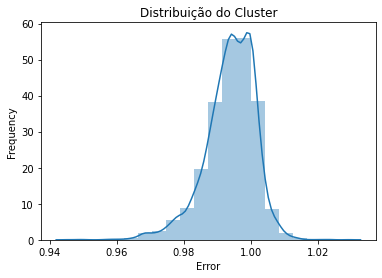

#------------------------------//------------------------------#
Cluster 2
Have 55 days
Representation: 5.07
Accumulated Representation: 74.54
Absolute Error: 0.0648
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 13:30:00


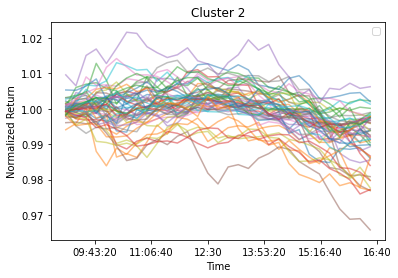

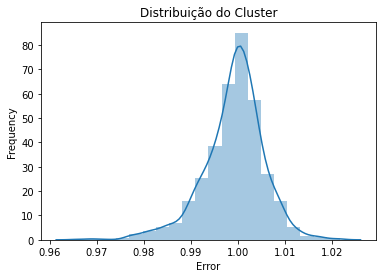

#------------------------------//------------------------------#
Cluster 3
Have 50 days
Representation: 4.61
Accumulated Representation: 79.15
Absolute Error: 0.0694
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 13:15:00


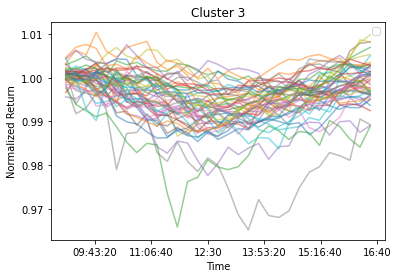

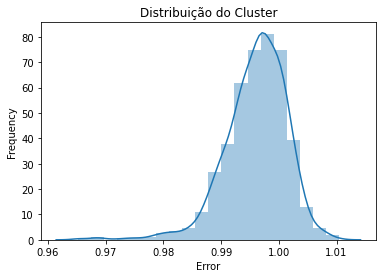

#------------------------------//------------------------------#
Cluster 4
Have 36 days
Representation: 3.32
Accumulated Representation: 82.47
Absolute Error: 0.0775
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 14:15:00


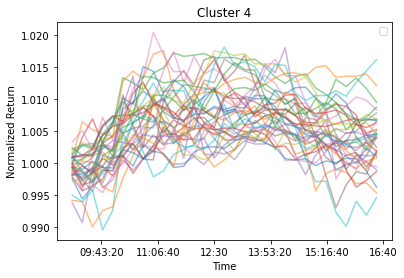

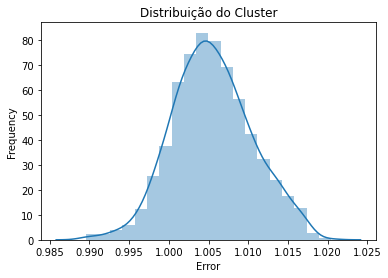

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  54
----------//----------
Studied Month:  2018-07-02
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1105
Plot the Clusters Formed
Cluster 0
Have 412 days
Representation: 37.29
Accumulated Representation: 37.29
Absolute Error: 0.0150
Mean Square Error: 0.0005
Upward Trend 09:15:00
Downtrend 10:00:00


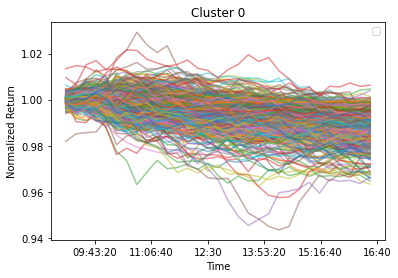

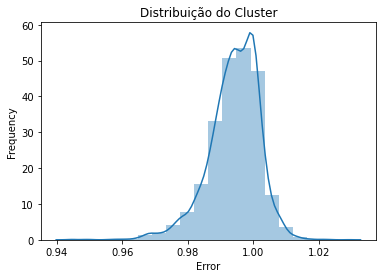

#------------------------------//------------------------------#
Cluster 1
Have 386 days
Representation: 34.93
Accumulated Representation: 72.22
Absolute Error: 0.0186
Mean Square Error: 0.0006
Upward Trend 09:15:00


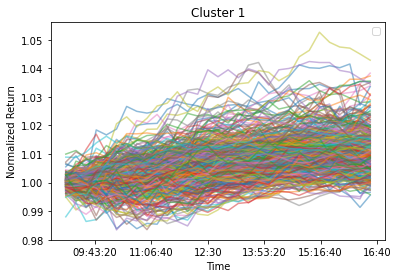

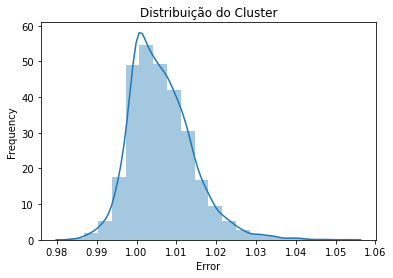

#------------------------------//------------------------------#
Cluster 2
Have 67 days
Representation: 6.06
Accumulated Representation: 78.28
Absolute Error: 0.0676
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 12:45:00


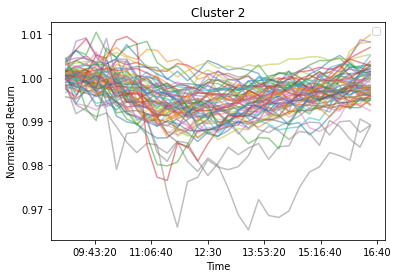

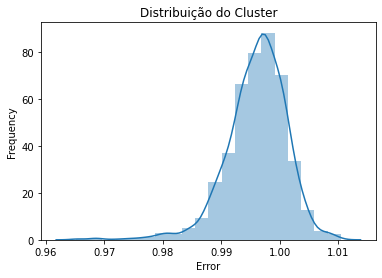

#------------------------------//------------------------------#
Cluster 3
Have 62 days
Representation: 5.61
Accumulated Representation: 83.89
Absolute Error: 0.0696
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 13:15:00


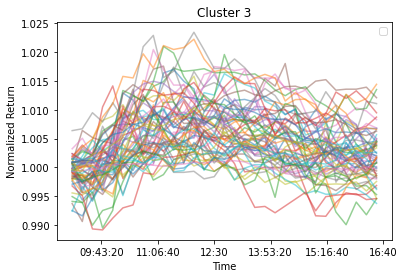

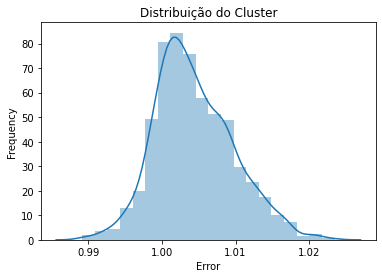

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2002
----------//----------
Studied Month:  2018-08-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1126
Plot the Clusters Formed
Cluster 0
Have 395 days
Representation: 35.08
Accumulated Representation: 35.08
Absolute Error: 0.0182
Mean Square Error: 0.0006
Upward Trend 09:15:00


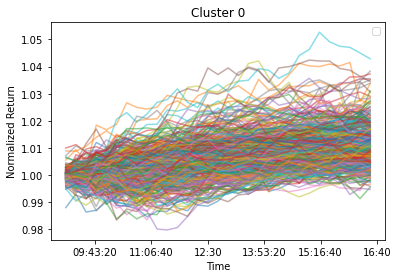

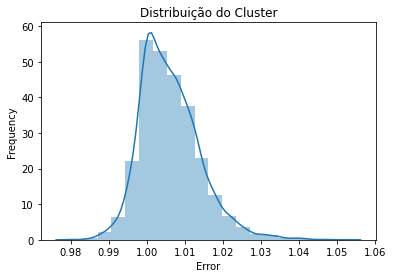

#------------------------------//------------------------------#
Cluster 1
Have 369 days
Representation: 32.77
Accumulated Representation: 67.85
Absolute Error: 0.0237
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


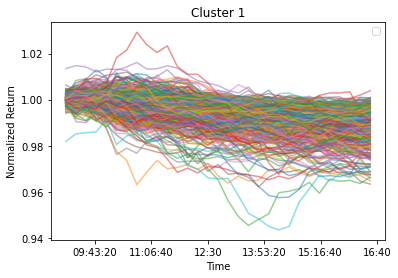

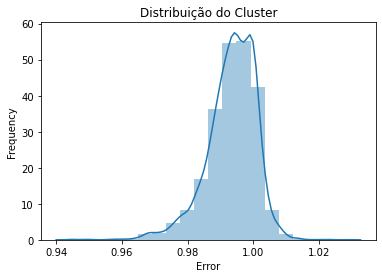

#------------------------------//------------------------------#
Cluster 2
Have 114 days
Representation: 10.12
Accumulated Representation: 77.98
Absolute Error: 0.0670
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:45:00


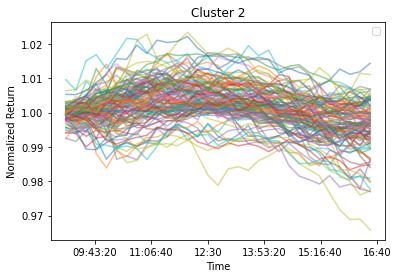

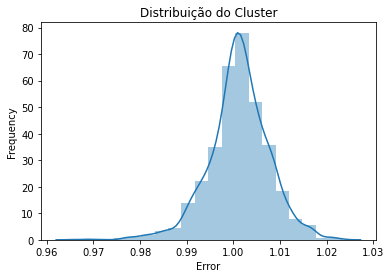

#------------------------------//------------------------------#
Cluster 3
Have 53 days
Representation: 4.71
Accumulated Representation: 82.68
Absolute Error: 0.0721
Mean Square Error: 0.0023
Downtrend 09:15:00
Upward Trend 13:15:00


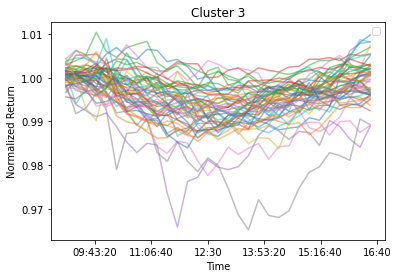

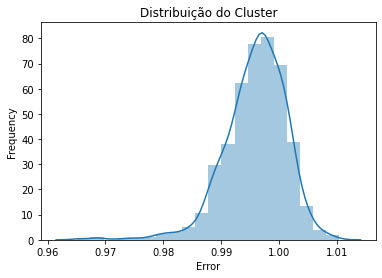

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  226
----------//----------
Studied Month:  2018-09-03
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1149
Plot the Clusters Formed
Cluster 0
Have 403 days
Representation: 35.07
Accumulated Representation: 35.07
Absolute Error: 0.0208
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


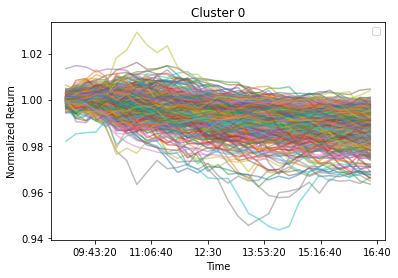

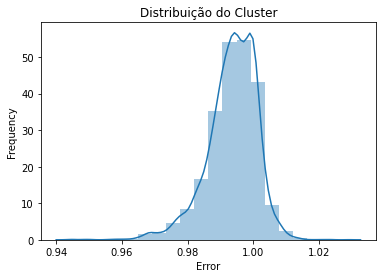

#------------------------------//------------------------------#
Cluster 1
Have 341 days
Representation: 29.68
Accumulated Representation: 64.75
Absolute Error: 0.0227
Mean Square Error: 0.0007
Upward Trend 09:15:00


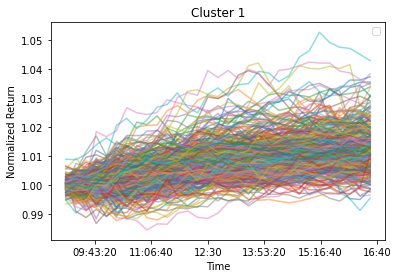

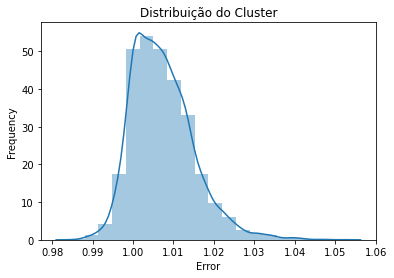

#------------------------------//------------------------------#
Cluster 2
Have 74 days
Representation: 6.44
Accumulated Representation: 71.19
Absolute Error: 0.0563
Mean Square Error: 0.0018
Downtrend 09:15:00
Upward Trend 12:15:00
Downtrend 16:15:00


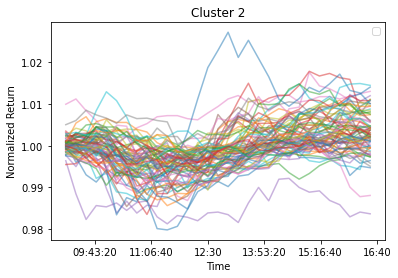

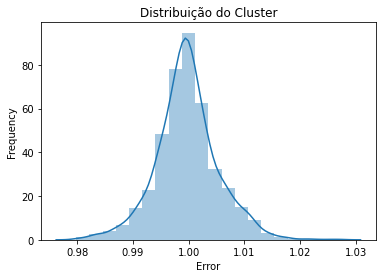

#------------------------------//------------------------------#
Cluster 3
Have 72 days
Representation: 6.27
Accumulated Representation: 77.46
Absolute Error: 0.0748
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 13:00:00


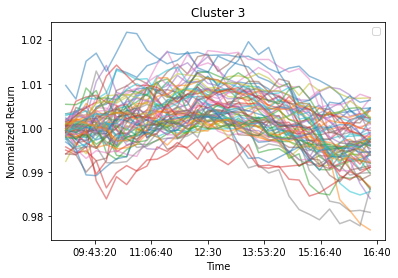

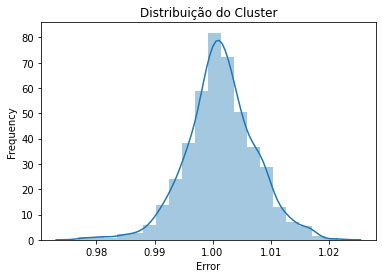

#------------------------------//------------------------------#
Cluster 4
Have 52 days
Representation: 4.53
Accumulated Representation: 81.98
Absolute Error: 0.0566
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:45:00
Upward Trend 15:15:00


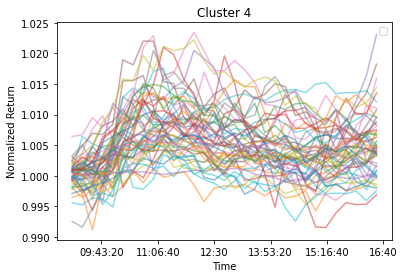

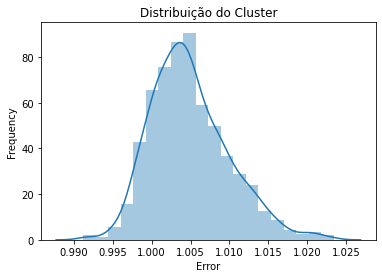

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1275
----------//----------
Studied Month:  2018-10-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1168
Plot the Clusters Formed
Cluster 0
Have 406 days
Representation: 34.76
Accumulated Representation: 34.76
Absolute Error: 0.0213
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


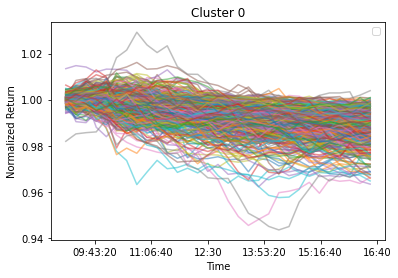

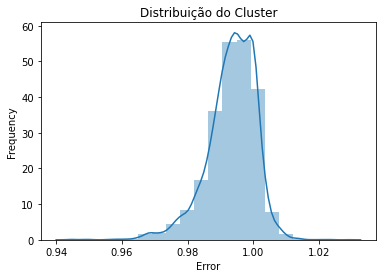

#------------------------------//------------------------------#
Cluster 1
Have 398 days
Representation: 34.08
Accumulated Representation: 68.84
Absolute Error: 0.0141
Mean Square Error: 0.0005
Upward Trend 09:15:00


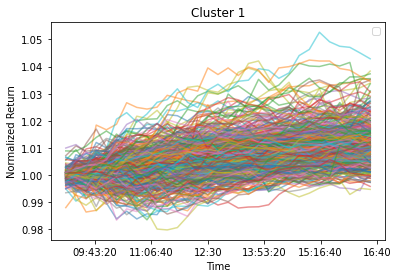

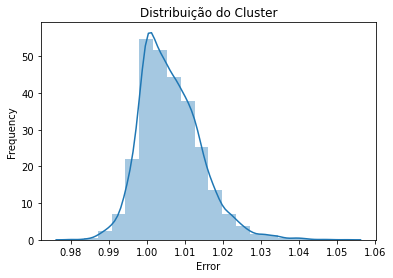

#------------------------------//------------------------------#
Cluster 2
Have 76 days
Representation: 6.51
Accumulated Representation: 75.34
Absolute Error: 0.0655
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


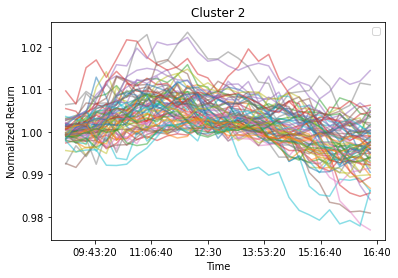

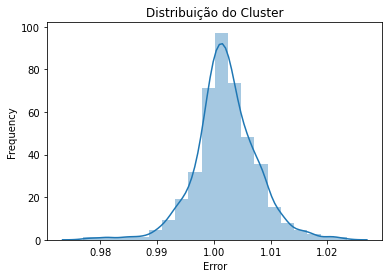

#------------------------------//------------------------------#
Cluster 3
Have 52 days
Representation: 4.45
Accumulated Representation: 79.79
Absolute Error: 0.0717
Mean Square Error: 0.0023
Downtrend 09:15:00
Upward Trend 13:15:00


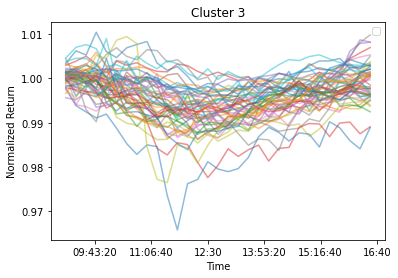

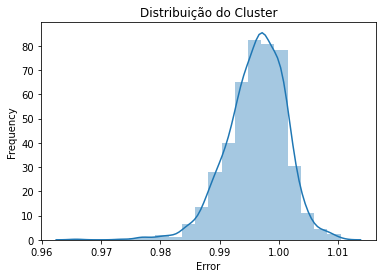

#------------------------------//------------------------------#
Cluster 4
Have 46 days
Representation: 3.94
Accumulated Representation: 83.73
Absolute Error: 0.0772
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 13:45:00


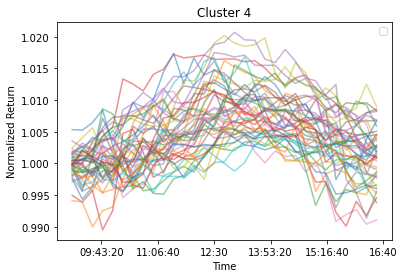

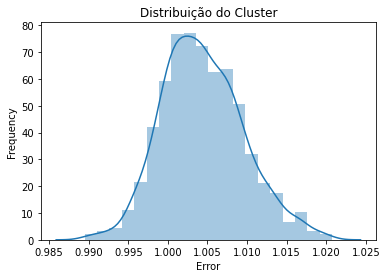

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  961
----------//----------
Studied Month:  2018-11-01
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1190
Plot the Clusters Formed
Cluster 0
Have 403 days
Representation: 33.87
Accumulated Representation: 33.87
Absolute Error: 0.0170
Mean Square Error: 0.0005
Upward Trend 09:15:00


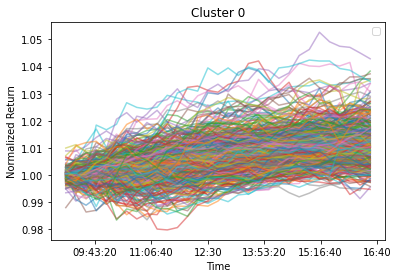

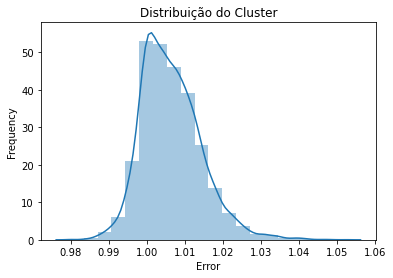

#------------------------------//------------------------------#
Cluster 1
Have 378 days
Representation: 31.76
Accumulated Representation: 65.63
Absolute Error: 0.0169
Mean Square Error: 0.0005
Upward Trend 09:15:00
Downtrend 10:00:00


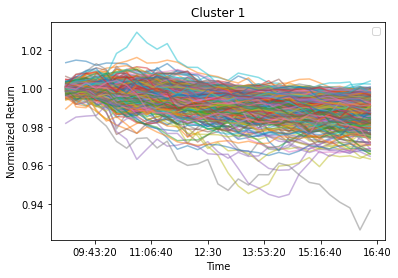

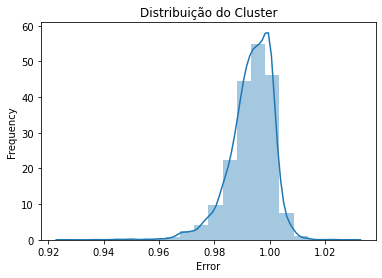

#------------------------------//------------------------------#
Cluster 2
Have 116 days
Representation: 9.75
Accumulated Representation: 75.38
Absolute Error: 0.0638
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 13:15:00


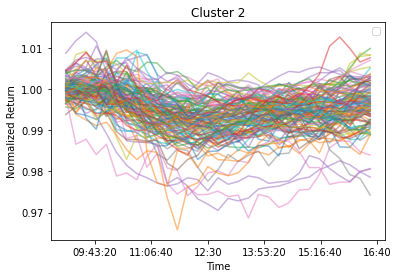

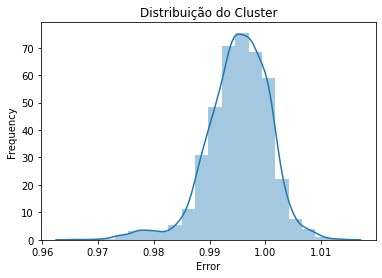

#------------------------------//------------------------------#
Cluster 3
Have 73 days
Representation: 6.13
Accumulated Representation: 81.51
Absolute Error: 0.0663
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


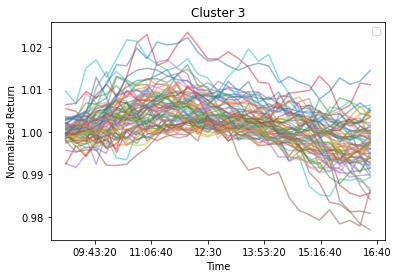

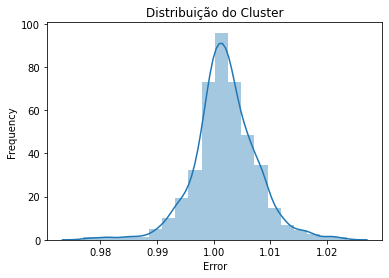

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  2917
----------//----------
Studied Month:  2018-12-03
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  1209
Plot the Clusters Formed
Cluster 0
Have 459 days
Representation: 37.97
Accumulated Representation: 37.97
Absolute Error: 0.0207
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


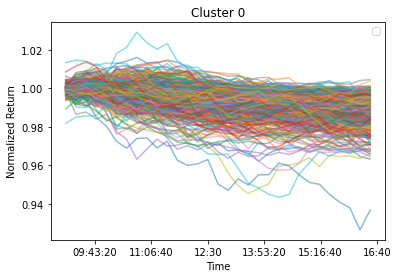

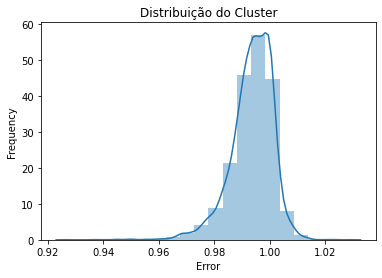

#------------------------------//------------------------------#
Cluster 1
Have 443 days
Representation: 36.64
Accumulated Representation: 74.61
Absolute Error: 0.0162
Mean Square Error: 0.0005
Upward Trend 09:15:00


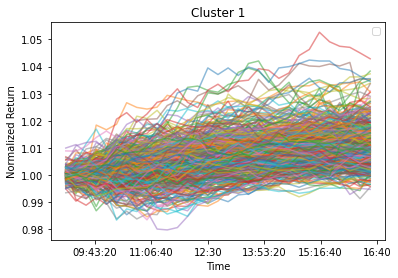

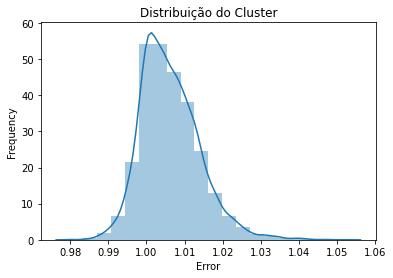

#------------------------------//------------------------------#
Cluster 2
Have 102 days
Representation: 8.44
Accumulated Representation: 83.04
Absolute Error: 0.0693
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:45:00


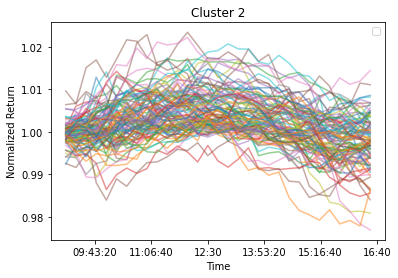

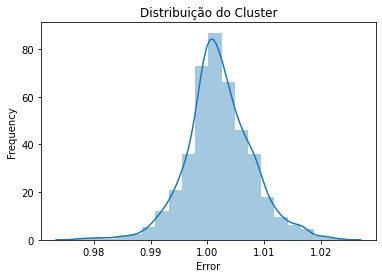

#------------------------------//------------------------------#
-VALIDATION-
-TEST-
Accumulated Month:  1131


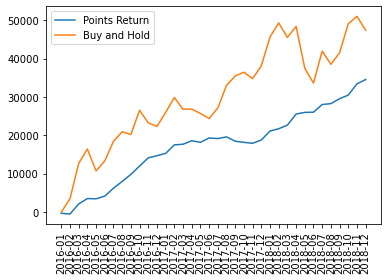

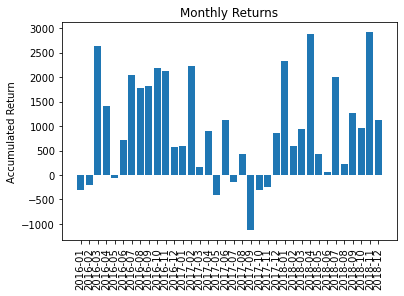

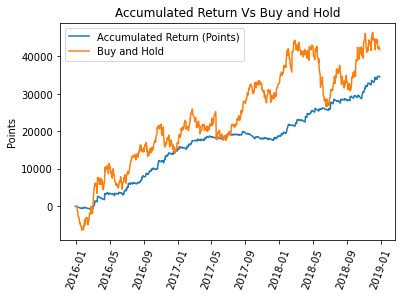

------------------------------//------------------------------


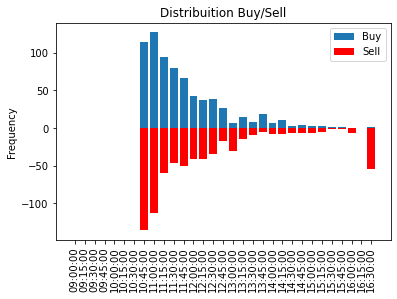

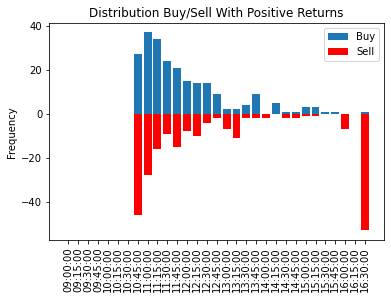

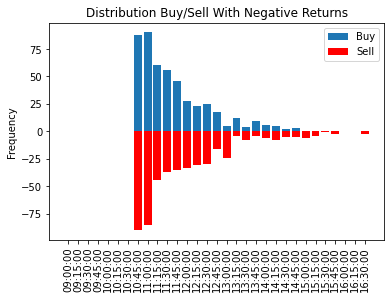

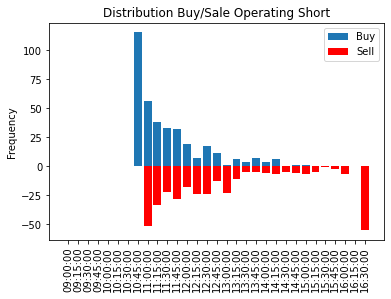

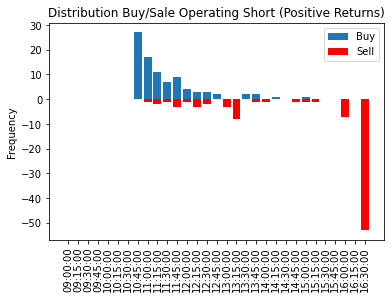

...

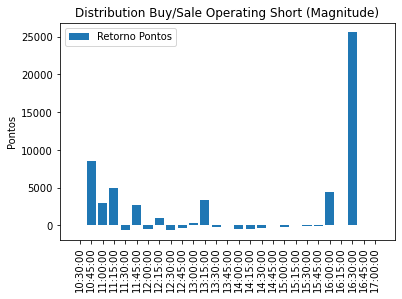

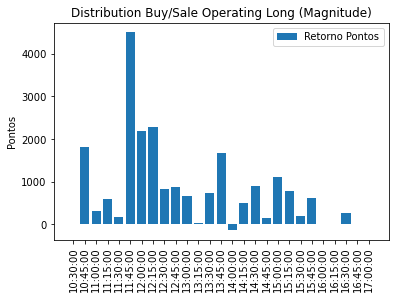

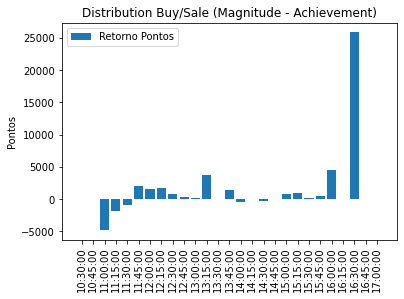

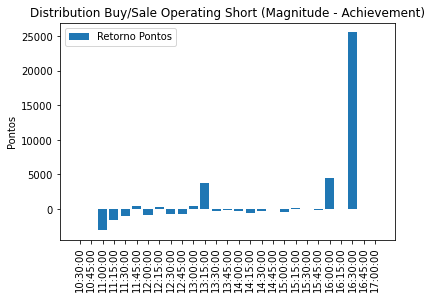

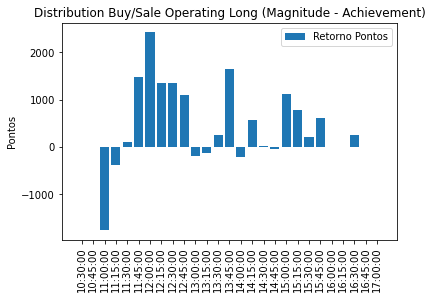

In [5]:
## NORMALIZA OS DADOS DO LOG RETORNO
#LogAux = DadosTratados.T.apply(zscore)
#LogRetornoNormalizado = LogAux.T

hora= sorted(Dados.hora.unique())

#Dados
DadosTratados = logRetornoTratado
#DadosTratados = DadosFiltrados
#DadosTratados = LogRetornoNormalizado


#K - Tamanho do Cluster
K = 30

# Controla o ganho em todos os períodos
ganhoPeriodo = []
ganhoPeriodo.append(0)

ganhoDiario = []
ganhoDiario.append(0)

ganhoMensal = []
ganhoMensal.append(0)

ValorAtivoFinalMes = []

EstudadosDatas = []

FinalMesValor = []
FinalDiaValor = []

listaGanhoCompradoHoraCompra = []  
listaGanhoCompradoHoraVenda = []
listaGanhoVendidoHoraCompra = []
listaGanhoVendidoHoraVenda = []
listaPerdaCompradoHoraCompra = []  
listaPerdaCompradoHoraVenda = []
listaPerdaVendidoHoraCompra = []
listaPerdaVendidoHoraVenda = []
listDaysGain = []
listDaysLoss = []
listDaysNoOperate = []
listaGanhoCompradoHoraCompraMagnitude = {} 
listaGanhoCompradoHoraVendaMagnitude = {}
listaGanhoVendidoHoraCompraMagnitude = {}
listaGanhoVendidoHoraVendaMagnitude = {}
listaPerdaCompradoHoraCompraMagnitude = {}  
listaPerdaCompradoHoraVendaMagnitude = {}
listaPerdaVendidoHoraCompraMagnitude = {}
listaPerdaVendidoHoraVendaMagnitude = {}
for tempo in hora:
    listaGanhoCompradoHoraCompraMagnitude[str(tempo)] = 0
    listaGanhoCompradoHoraVendaMagnitude[str(tempo)] = 0
    listaGanhoVendidoHoraCompraMagnitude[str(tempo)] = 0
    listaGanhoVendidoHoraVendaMagnitude[str(tempo)] = 0
    listaPerdaCompradoHoraCompraMagnitude[str(tempo)] = 0
    listaPerdaCompradoHoraVendaMagnitude[str(tempo)] = 0
    listaPerdaVendidoHoraCompraMagnitude[str(tempo)] = 0
    listaPerdaVendidoHoraVendaMagnitude[str(tempo)] = 0


# Setting for entering the repeat loop
if Windowing == 1:
    temp = range(18,54);
    intervalo = 6;
if Windowing == 2:
    temp = range(12,48)
    intervalo = 12
if Windowing == 3:
    temp = range(0,36)
    intervalo = 24
if Windowing == 4:
    temp = range(24,60)
    intervalo = 0
    
#Two years
 ## range(0,36)
 ## intervalo = 24
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
#One years
 ## range(12,48)
 ## intervalo = 12
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
#Six months
 ## range(18,54)
 ## intervalo = 6
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
 ##inicio = dt_idx.get_loc(DatasIniciaisMes[i])
#Acumulativo
 ## range(24,60)
 ## intervalo = 0
 ##EstudadosDatas.append(DatasIniciaisMes[0][0:7])
 ##inicio = dt_idx.get_loc(DatasIniciaisMes[0])
for i in temp: 
    #intervalo = 24
    print("----------//----------")
    print("Studied Month: ", DatasIniciaisMes[i+intervalo])
    EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
    #Formação dos Cluster (Treinamento)
    print("-TRAINING-")
    print('Formation of Clusters (Training)')
    inicio = dt_idx.get_loc(DatasIniciaisMes[0])
    fim = dt_idx.get_loc(DatasIniciaisMes[i+intervalo])
    
    DadosAux = DadosTratados.T
    DadosTreinamento = DadosAux[inicio:fim]
    Z = estruturaDados.DadosToCluster(DadosTreinamento, False) # Ultimo parametro é o plot(True or False)
    listaCluster = estruturaDados.segmentaCluster(Z, K, False) # Ultimo parametro é o plot(True or False)

    [listaOrdenada, QuantidadeDias, Representacao]  = estruturaDados.ordenacaoTamanhoCluster(DadosTreinamento, listaCluster)
    if PlotClusters:
        print("Plot the Clusters Formed")
        estruturaDados.printClusters(listaCluster,QuantidadeDias, Representacao, listaOrdenada, DadosTreinamento)

      
    #Validação
    print('-VALIDATION-')
    [listaCurvas, listaMedias] = estruturaDados.CurvasClusters2(DadosTreinamento, listaCluster, listaOrdenada)
    
    
    lista = []
    lista.append(0.002)
    lista.append(0.8)
    lista.append(0.7)
    lista.append(0)
    
    
    #Otimization - Execute Differential Evolution
    if Otimization:
        parametrosNegociacao = estruturaDados.EvolucaoDiferencial(10, 70, 1.5, DadosTreinamento, listaMedias, Representacao, Dados)
    else:
        parametrosNegociacao = pd.DataFrame([lista],columns=['MGanhoPadrao', 'MGanhoCorrelacao', 'MRiscoCorrelacao', 'MRiscoPadrao'], index=[0])
        
    
    #Test
    print('-TEST-')
    inicio = dt_idx.get_loc(DatasIniciaisMes[i+intervalo])
    fim = dt_idx.get_loc(DatasIniciaisMes[i+intervalo+1])


    #Dados Não Normalizados
    DadosAux = DadosFiltrados
    DadosTeste = DadosAux[inicio:fim]
    
    FinalMesValor.append(DadosTeste.iloc[len(DadosTeste)-1][30])
    
    stoplossAux = 0.001

    ganhoAcumuladoMes = 0;
                               
    
    
    for dia in range(0,len(DadosTeste)):
        [ganho, CompradoHoraCompra, CompradoHoraVenda, VendidoHoraCompra, VendidoHoraVenda] = estruturaDados.SimulacaoEstrategiaII(dia, False, stoplossAux, DadosTeste, listaMedias, Representacao,parametrosNegociacao, Dados)
        if ganho > 0:
            listDaysGain.append(dia)
            if CompradoHoraCompra != 0:
                listaGanhoCompradoHoraCompra.append(CompradoHoraCompra)
                listaGanhoCompradoHoraCompraMagnitude[str(CompradoHoraCompra)] = listaGanhoCompradoHoraCompraMagnitude[str(CompradoHoraCompra)]+ganho
            if CompradoHoraVenda != 0:
                listaGanhoCompradoHoraVenda.append(CompradoHoraVenda)
                listaGanhoCompradoHoraVendaMagnitude[str(CompradoHoraVenda)] = listaGanhoCompradoHoraVendaMagnitude[str(CompradoHoraVenda)]+ganho
            if VendidoHoraCompra != 0:
                listaGanhoVendidoHoraCompra.append(VendidoHoraCompra)
                listaGanhoVendidoHoraCompraMagnitude[str(VendidoHoraCompra)] = listaGanhoVendidoHoraCompraMagnitude[str(VendidoHoraCompra)]+ganho
            if VendidoHoraVenda != 0:
                listaGanhoVendidoHoraVenda.append(VendidoHoraVenda)
                listaGanhoVendidoHoraVendaMagnitude[str(VendidoHoraVenda)] = listaGanhoVendidoHoraVendaMagnitude[str(VendidoHoraVenda)]+ganho
        if ganho < 0:
            listDaysLoss.append(dia)
            if CompradoHoraCompra != 0:
                listaPerdaCompradoHoraCompra.append(CompradoHoraCompra)
                listaPerdaCompradoHoraCompraMagnitude[str(CompradoHoraCompra)] = listaPerdaCompradoHoraCompraMagnitude[str(CompradoHoraCompra)]+ganho
            if CompradoHoraVenda != 0:
                listaPerdaCompradoHoraVenda.append(CompradoHoraVenda)
                listaPerdaCompradoHoraVendaMagnitude[str(CompradoHoraVenda)] = listaPerdaCompradoHoraVendaMagnitude[str(CompradoHoraVenda)]+ganho
            if VendidoHoraCompra != 0:
                listaPerdaVendidoHoraCompra.append(VendidoHoraCompra)
                listaPerdaVendidoHoraCompraMagnitude[str(VendidoHoraCompra)] = listaPerdaVendidoHoraCompraMagnitude[str(VendidoHoraCompra)]+ganho
            if VendidoHoraVenda != 0:
                listaPerdaVendidoHoraVenda.append(VendidoHoraVenda)
                listaPerdaVendidoHoraVendaMagnitude[str(VendidoHoraVenda)] = listaPerdaVendidoHoraVendaMagnitude[str(VendidoHoraVenda)]+ganho
        if ganho == 0:
            listDaysNoOperate.append(dia)
        
        ganhoDiario.append(ganho) 
        ganhoAcumuladoMes = ganhoDiario[-1] + ganhoAcumuladoMes
        FinalDiaValor.append(DadosTeste.iloc[dia][30])
    
    print("Accumulated Month: ", ganhoAcumuladoMes)
    ganhoPeriodo.append(ganhoAcumuladoMes + ganhoPeriodo[-1])
    ganhoMensal.append(ganhoAcumuladoMes)
    ValorAtivoFinalMes.append(FinalMesValor[-1]-FinalMesValor[0])
    

#--------//--------#
#plot os ganhos em termos mensais
plt.plot(EstudadosDatas,ganhoPeriodo[1:])
plt.plot(EstudadosDatas,ValorAtivoFinalMes)
plt.xticks(rotation=90);
plt.legend(["Points Return", "Buy and Hold"])
plt.show()

plt.bar(EstudadosDatas,ganhoMensal[1:])
plt.title("Monthly Returns")
plt.ylabel("Accumulated Return")
plt.xticks(rotation=90);
plt.show()

#--------//--------#
#plot o ganho em termos diários
acumula = []
acumula.append(0)
for i in ganhoDiario:
    acumula.append(acumula[-1]+i)

real = []
for i in FinalDiaValor:
    real.append(i-FinalDiaValor[0])
    
plt.plot(DiasAnalisados[fim-len(acumula):fim], acumula)
plt.plot(DiasAnalisados[fim-len(FinalDiaValor):fim], real)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()
print("------------------------------//------------------------------")
#Plota as Figuras em Barra referente ao horário de negociações
hora = hora[6:-7]
FigureBar()
FigureBarMagnitude()



In [17]:
i = 1
lista = listaCluster[listaOrdenada[i]]
print(lista)

Int64Index([  1,   6,  11,  12,  19,  23,  25,  30,  33,  42,
            ...
            944, 946, 949, 951, 952, 954, 963, 964, 973, 977],
           dtype='int64', length=281)


In [ ]:
 def SimulacaoEstrategiaII(dia, plot, stoplossAux, DadosEntrada, listaMedias, Representacao, parametrosNegociacao, Dados):

        hora = sorted(Dados.hora.unique())
        hora = hora[0:31]

        if (plot):
            fig = plt.figure()
            ax = fig.add_subplot(1, 1, 1)
            ax.plot(DadosEntrada.iloc[dia])

        ## Estrutura Correlação
        cabecalho = ['curva']

        # Teste Apenas os 7 primeiros clusters
        cabecalho.extend([*range(0, 7)])

        # cabecalho.extend(list(range(0,len(listaMedias)))) ---- TODOS OS CLUSTERS
        correlacaoMomento = pd.DataFrame(columns=cabecalho);
        ##

        ultimoNegocio = 30  # Indice limite para negociacao
        valorCompraVenda = DadosEntrada.iloc[dia][ultimoNegocio]
        inicio = DadosEntrada.iloc[dia][0]
        stopLossCoberto = inicio * 2
        stopLossDescoberto = 0

        posCorrelacao = 0

        controleCompra = 0  # Controla de quanto em quanto tempo irá efetuar uma nova compra

        plotVerificaCompra = False  # Esse plot imprime variáveis enquanto roda o Modelo

        ## Controlam a quantidade de ativos vendidos e comprados
        compras = 0
        vendas = 0

        op = 0  # Controla a quantidade de Operações
        ##

        ganhoTotal = 0
        CompradoHoraCompra = 0
        CompradoHoraVenda = 0
        VendidoHoraCompra = 0
        VendidoHoraVenda = 0
        if inicio == 0:
            print("Day With Data Problem", dia)
        else:
            for i in range(0, len(DadosEntrada.iloc[dia]) - 1):
                correlacaoPontos = []
                correlacaoPontos.append(1 + (math.log(DadosEntrada.iloc[dia][i] / inicio)))
                # Apensa os 7 primeiros clusters
                # for j in range(0,len(listaMedias)): #---- TODOS OS CLUSTERS
                for j in range(0, 7):
                    correlacaoPontos.append(listaMedias[j][i - 2])

                correlacaoMomento.loc[posCorrelacao] = correlacaoPontos
                if i > 6:
                    Correlacao = correlacaoMomento.corr('pearson')
                    # print(Correlacao['curva'][1:])
                    if plot:
                        print("Hora: ", hora[i])

                    if (i < ultimoNegocio) & (controleCompra >= 0):
                        Negocio = estruturaDados.verificaCompra(Representacao, Correlacao['curva'][1:], listaMedias, i, ultimoNegocio,
                                                 plotVerificaCompra, compras, vendas, parametrosNegociacao);
                        if Negocio == 1:
                            if compras == 0:
                                # Simulação de Compra

                                valorAtivo = DadosEntrada.iloc[dia][i]
                                if (valorAtivo != 0):
                                    # [quantidade, totalCapital] = simulaCompra(totalCapital, valorAtivo, lote, custoOperacao, emolumentosTaxaDayTrade)
                                    valorCompra = valorAtivo
                                    stopLossCoberto = valorCompra * (1 - stoplossAux)
                                    op = op + 1;
                                    compras = compras + 1;
                                    CompradoHoraCompra = hora[i]

                                    HoraCompra = hora[i]

                                if (plot):
                                    ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='b', marker="^")
                                    print('Buy: %.2f' % valorAtivo)

                        if Negocio == -1:
                            if compras > 0:
                                # Simulação de Venda
                                ganhoTotal = ganhoTotal + (DadosEntrada.iloc[dia][i] - valorCompra)
                                # retorno = retorno + (DadosDiaSemana.iloc[dia][i] - Valorcompra);
                                compras = compras - 1;
                                HoraVenda = hora[i]
                                CompradoHoraVenda = hora[i]
                                if (plot):
                                    print('Sold: %.2f' % DadosEntrada.iloc[dia][i])
                                    ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='r', marker="v")

                                # print('venda: %.2f' %DadosDiaSemana.iloc[dia][i])
                                # print('retorno: %.2f' %retorno)
                                valorCompraVenda = DadosEntrada.iloc[dia][i]

                                controleCompra = -1
                        # StopLoss Comprado
                        if (DadosEntrada.iloc[dia][i] < stopLossCoberto):
                            if compras > 0:
                                valorAtivo = DadosEntrada.iloc[dia][i]
                                ganhoTotal = ganhoTotal + (int(stopLossCoberto) - valorCompra)
                                CompradoHoraVenda = hora[i]

                                HoraVenda = hora[i]

                                if (plot):
                                    ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='k', marker="v")
                                    print('Sold: %.2f' % DadosEntrada.iloc[dia][i])
                                compras = compras - 1;
                                valorCompraVenda = DadosEntrada.iloc[dia][i]
                                controleCompra = -1

                        # --------------------//--------------------
                        # Venda / Compra
                        if Negocio == 2:  # Venda Descoberda
                            if vendas == 0:
                                if DadosEntrada.iloc[dia][i] != 0:
                                    valorVenda = DadosEntrada.iloc[dia][i]
                                    stopLossDescoberto = valorVenda * (1 + stoplossAux)
                                    op = op + 1;
                                    vendas = vendas + 1;

                                    VendidoHoraVenda = hora[i]

                                    HoraCompra = hora[i]
                                    if (plot):
                                        ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='yellowgreen', marker="^")
                                        print('Short Sold: %.2f' % valorVenda)

                        if Negocio == -2:
                            if vendas == 1:
                                ganhoTotal = ganhoTotal + (valorVenda - DadosEntrada.iloc[dia][i])
                                HoraVenda = hora[i]
                                VendidoHoraCompra = hora[i]
                                if (plot):
                                    ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='orange', marker="v")
                                    print('Short Buy: %.2f' % DadosEntrada.iloc[dia][i])
                                vendas = vendas - 1;
                                #valorVendaCompra = DadosDiaSemana.iloc[dia][i] #MUDEI LEMBRAR
                                valorVendaCompra = DadosEntrada.iloc[dia][i]
                                controleCompra = -1

                        if (DadosEntrada.iloc[dia][i] > stopLossDescoberto):
                            if vendas == 1:
                                vendas = vendas - 1
                                valorAtivo = DadosEntrada.iloc[dia][i]
                                ganhoTotal = ganhoTotal + (valorVenda - int(stopLossDescoberto))
                                VendidoHoraCompra = hora[i]
                                HoraVenda = hora[i]
                                if (plot):
                                    ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='orangered', marker="v")
                                    print('Compra Descoberta: %.2f' % DadosEntrada.iloc[dia][i])
                                valorCompraVenda = DadosEntrada.iloc[dia][i]
                                controleCompra = -1

                    if (i == ultimoNegocio):
                        if (compras > 0):
                            ganhoTotal = ganhoTotal + (DadosEntrada.iloc[dia][i] - valorCompra)
                            compras = compras - 1;
                            HoraVenda = hora[i]
                            CompradoHoraVenda = hora[i]

                            if (plot):
                                ax.plot(hora[i], DadosEntrada.iloc[dia][i], color='m', marker="v")
                                print('Sold: %.2f' % DadosEntrada.iloc[dia][i])

                        if vendas != 0:
                            ganhoTotal = ganhoTotal + (valorVenda - DadosEntrada.iloc[dia][i])
                            HoraVenda = hora[i]
                            if (plot):
                                plt.plot(hora[i], DadosEntrada.iloc[dia][i], color='orange', marker="v")
                                print('Sold: %.2f' % DadosEntrada.iloc[dia][i])
                            compras = 0
                            valorVendaCompra = DadosEntrada.iloc[dia][i]
                            VendidoHoraCompra = hora[i]

                # Controla a Entrada dos DAdos para a correlação a cada iteraçao
                posCorrelacao = posCorrelacao + 1

            if (plot):
                plt.show()

        return ganhoTotal, CompradoHoraCompra, CompradoHoraVenda, VendidoHoraCompra, VendidoHoraVenda

Quantity Days:  983
Int64Index([  9,  10,  15,  22,  24,  26,  29,  31,  32,  35,
            ...
            962, 966, 969, 972, 976, 978, 979, 980, 981, 982],
           dtype='int64', length=334)


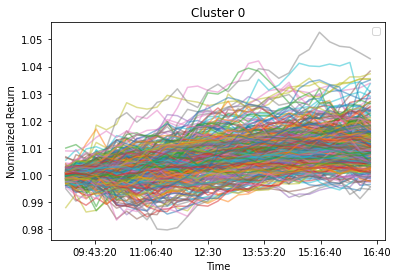

Int64Index([  1,   6,  11,  12,  19,  23,  25,  30,  33,  42,
            ...
            944, 946, 949, 951, 952, 954, 963, 964, 973, 977],
           dtype='int64', length=281)


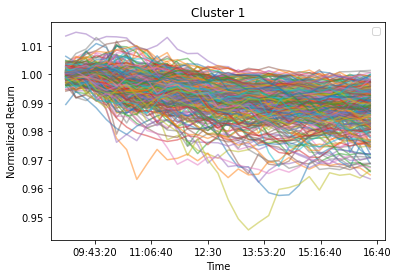

Int64Index([  0,   4,   5,   8,  13,  16,  17,  28,  34,  39,
            ...
            849, 853, 871, 879, 896, 927, 928, 934, 950, 967],
           dtype='int64', length=110)


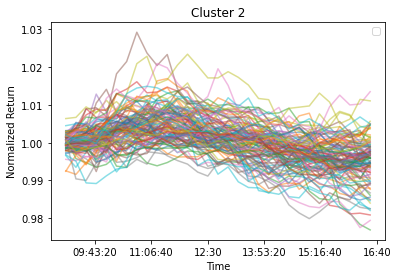

Int64Index([ 61,  68,  77,  82, 120, 148, 179, 191, 236, 243, 282, 294, 301,
            354, 357, 383, 395, 401, 424, 431, 440, 457, 464, 486, 506, 575,
            597, 610, 629, 632, 638, 670, 693, 746, 747, 769, 805, 828, 845,
            850, 881, 916, 933, 936, 937, 947, 961, 971],
           dtype='int64')


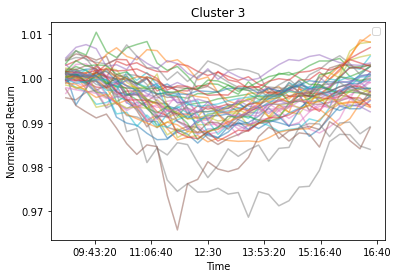

Int64Index([  7,  54,  79, 116, 175, 184, 197, 200, 201, 256, 279, 283, 313,
            321, 349, 352, 368, 392, 473, 543, 564, 572, 580, 582, 595, 604,
            665, 696, 777, 794, 804, 842, 892, 897, 938, 943, 965, 975],
           dtype='int64')


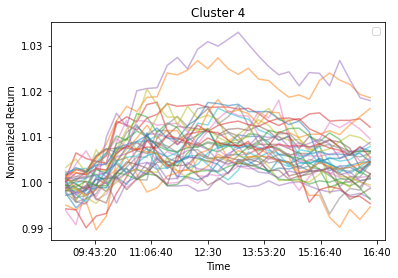

Int64Index([  2,  37, 156, 221, 250, 285, 311, 339, 385, 412, 442, 479, 562,
            574, 625, 709, 810, 815, 824, 851, 862, 913, 968],
           dtype='int64')


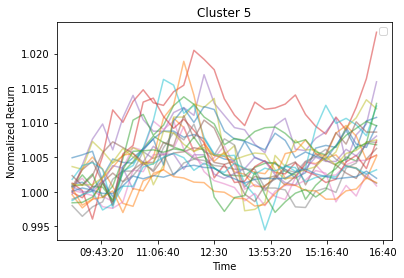

Int64Index([ 38, 143, 157, 160, 180, 271, 346, 444, 451, 461, 499, 533, 542,
            593, 697, 832, 931],
           dtype='int64')


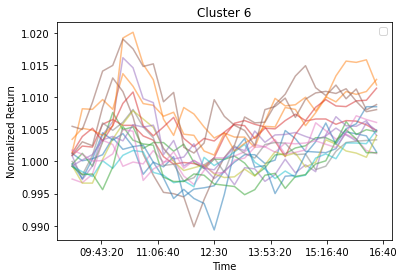

Int64Index([14, 70, 133, 177, 268, 317, 505, 558, 560, 561, 766, 786, 855, 919,
            958, 974],
           dtype='int64')


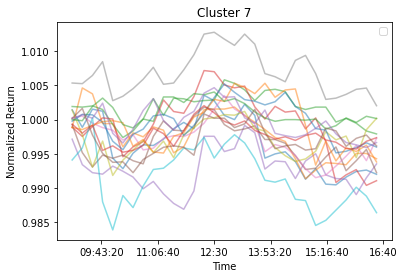

Int64Index([45, 168, 314, 330, 360, 490, 571, 609, 667, 669, 807, 841, 863,
            885, 945],
           dtype='int64')


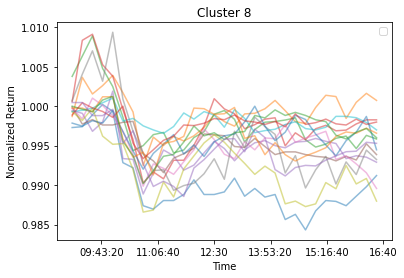

Int64Index([102, 172, 234, 334, 454, 458, 512, 623, 682, 800, 837, 876, 888,
            924, 925],
           dtype='int64')


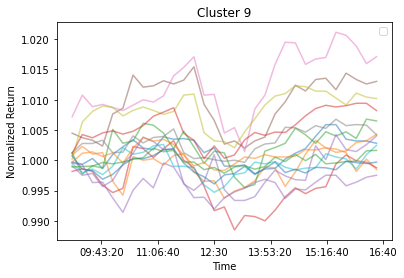

Int64Index([27, 74, 110, 152, 215, 399, 460, 525, 643, 683, 686, 822, 915], dtype='int64')


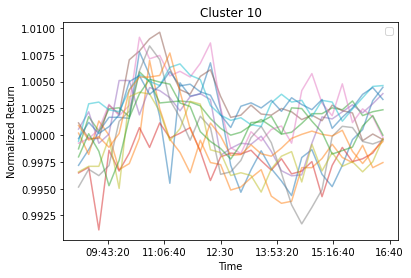

Int64Index([3, 67, 106, 210, 267, 273, 344, 508, 516, 626, 647, 948], dtype='int64')


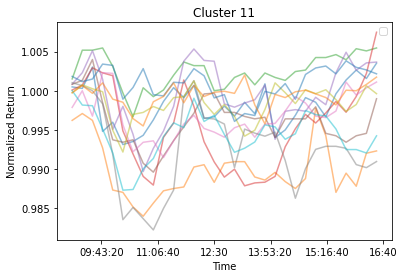

Int64Index([20, 132, 249, 266, 396, 487, 645, 893], dtype='int64')


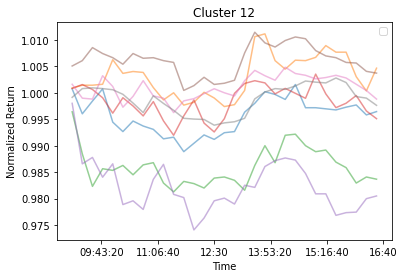

Int64Index([56, 150, 299, 459, 712, 727, 848, 861], dtype='int64')


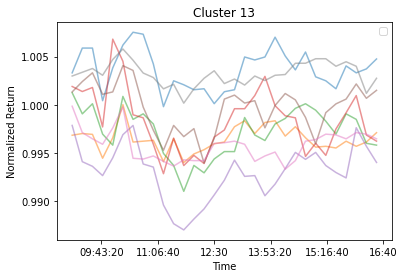

Int64Index([21, 94, 429, 480, 491, 783], dtype='int64')


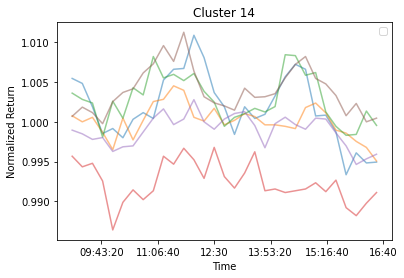

Int64Index([40, 751, 921, 953], dtype='int64')


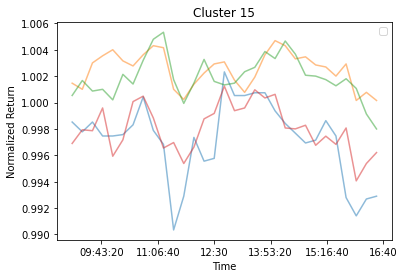

Int64Index([178, 286, 303, 970], dtype='int64')


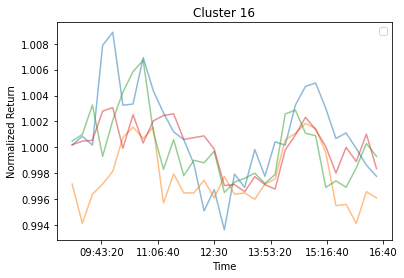

Int64Index([185, 536, 717, 830], dtype='int64')


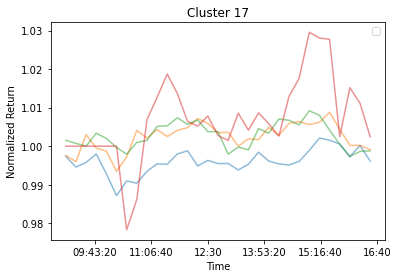

Int64Index([198, 468, 622, 753], dtype='int64')


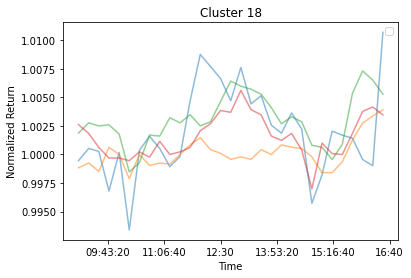

Int64Index([60, 435, 608], dtype='int64')


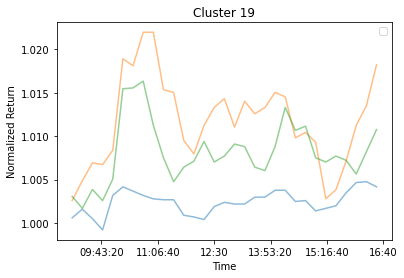

Int64Index([91, 309, 531], dtype='int64')


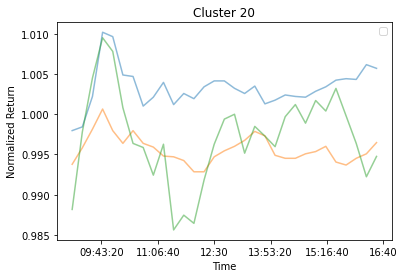

Int64Index([114, 755, 960], dtype='int64')


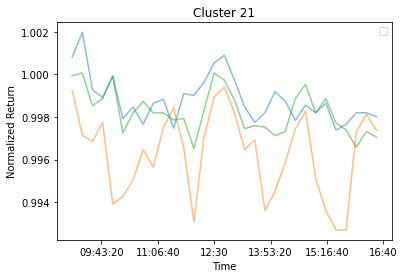

Int64Index([255, 338, 410], dtype='int64')


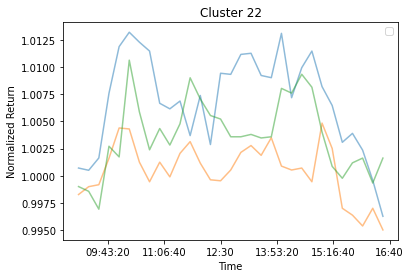

Int64Index([18, 757], dtype='int64')


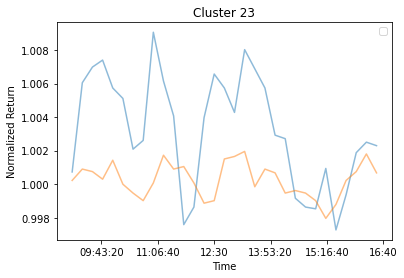

Int64Index([324, 520], dtype='int64')


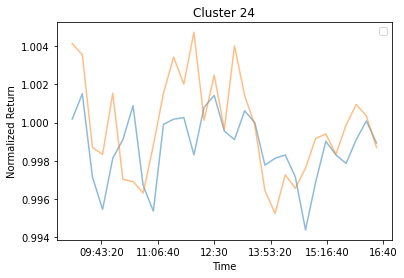

Int64Index([417, 929], dtype='int64')


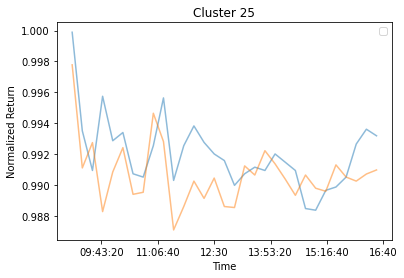

Int64Index([826, 877], dtype='int64')


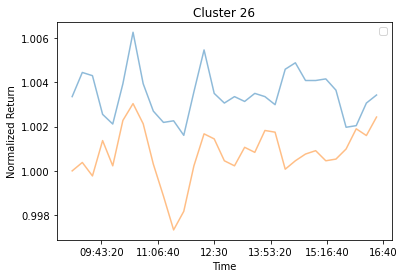

Int64Index([118], dtype='int64')


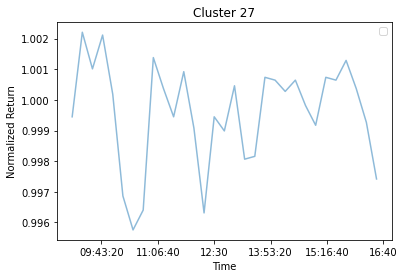

Int64Index([211], dtype='int64')


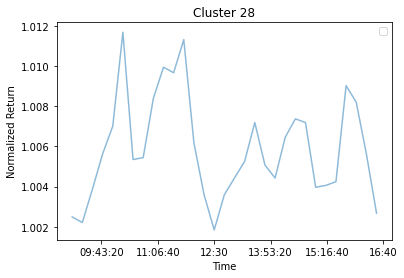

Int64Index([488], dtype='int64')


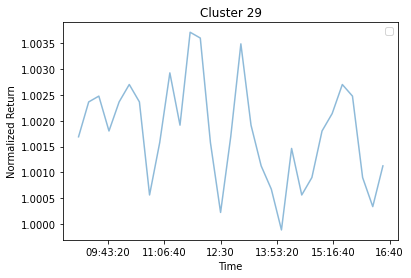

In [6]:
for i in range(24,25): 
    #lista = listaCluster[listaOrdenada[i]];
    inicio = dt_idx.get_loc(DatasIniciaisMes[0])
    fim = dt_idx.get_loc(DatasIniciaisMes[i+intervalo])
    DadosAux = DadosTratados.T;
    DadosTreinamento = DadosAux[inicio:fim];
    Z = estruturaDados.DadosToCluster(DadosTreinamento, False); # Ultimo parametro é o plot(True or False)
    listaCluster = estruturaDados.segmentaCluster(Z, K, False); # Ultimo parametro é o plot(True or False)

    [listaOrdenada, QuantidadeDias, Representacao]  = estruturaDados.ordenacaoTamanhoCluster(DadosTreinamento, listaCluster);
    for j in range(0, len(listaCluster)):
        lista = listaCluster[listaOrdenada[j]]
        print(lista)
        DadosAux = DadosTreinamento.iloc[lista]
        #print(DadosAux)
        DadosAux.T.plot(alpha=0.5)
        
        
        DadosPlot = DadosAux.T
        #print(DadosPlot)

        #fig = plt.figure()
        #ax = fig.add_subplot(1, 1, 1)
        #ax.plot(DadosAux.T, alpha=0.5)
        #ax.plot(DadosTestando, color='green', marker='o', label='Average', linewidth=3)
        #ax.legend()

        # DadosNorm.plot(y = lista, legend=False, alpha=0.5);
        # DadosNorm[lista].T.mean().plot(legend=True, color='green', marker='o', label='Média',  linewidth=3)
        plt.legend("")
        plt.title('Cluster %d' % (j))
        plt.xlabel('Time')
        plt.ylabel('Normalized Return')
        plt.show()
    
    #printClustersII(listaCluster,QuantidadeDias, Representacao, listaOrdenada, DadosTreinamento);

In [7]:
def printClustersII(listaCluster, Soma, Representacao, listaOrdenada, DadosTreinamento):
    Acumulado = 0
    for i in range(0, len(listaCluster)):
        lista = listaCluster[listaOrdenada[i]]
        Percentual = (len(lista) / Soma) * 100
        Representacao.append(Percentual)
        if (Acumulado <= 80) & (len(lista) > 4):
            print('Cluster %d' % (i))
            print('Have %d days' % len(lista))
            Acumulado = Percentual + Acumulado
            print('Representation: %.2f' % Percentual)
            print('Accumulated Representation: %.2f' % Acumulado)

            # ------------------------------//------------------------------#
            # Inclinação do Cluster
            # DadosTestando = pd.DataFrame(DadosTreinamento.[lista].T.mean(), columns=['Media'])
            DadosTestando = pd.DataFrame(DadosTreinamento.iloc[lista].mean(), columns=['Media'])
            # carregando dados hipotéticos, para fins didáticos apenas
            dataframe = pd.DataFrame()
            dataframe['x'] = np.linspace(0, len(DadosTestando['Media'].values), len(DadosTestando['Media'].values),
                                         endpoint=False)  # Entrada X
            dataframe['y'] = DadosTestando['Media'].values  # Média dos Valores do Cluster
            x_values = dataframe[['x']]
            y_values = dataframe[['y']]

            # treinando o modelo
            model = linear_model.LinearRegression()
            model.fit(x_values, y_values)

            # ------------------------------//------------------------------#
            # Modelo Linear com Erro
            predito = model.predict(x_values)
            ErroAbsoluto = abs(y_values - predito)  # Erro absoluto
            print('Absolute Error: %.4f' % ErroAbsoluto.sum());
            ErroQuadrático = pow(ErroAbsoluto, 2)  # Erro Quadrático
            MSE = ErroAbsoluto / len(ErroAbsoluto)  # Erro Quadrático Médio
            print('Mean Square Error: %.4f' % MSE.sum())

            [tendencias, pos] = estruturaDados.tendencia(DadosTestando, DadosTestando['Media'].values)

            for j in range(0, len(tendencias)):
                print(str(tendencias[j]), end=" ")
                print(str(DadosTestando.index[pos[j]]))

            # ------------------------------//------------------------------#
            # Plot Cluter
            DadosAux = DadosTreinamento.iloc[lista]
            DadosAux.T.plot(alpha=0.5)
            #DadosPlot = DadosAux.T
            #print(DadosPlot)
            #DadosPlot = DadosAux
            # DadosPlot.plot(legend=False, alpha = 0.5)
            # DadosTestando.plot(legend=True, color='green', marker='o', label='Média',  linewidth=3)

            #fig = plt.figure()
            #ax = fig.add_subplot(1, 1, 1)
            #ax.plot(DadosPlot, alpha=0.5)
            #ax.plot(DadosTestando, color='green', marker='o', label='Average', linewidth=3)
            #ax.legend()

            # DadosNorm.plot(y = lista, legend=False, alpha=0.5);
            # DadosNorm[lista].T.mean().plot(legend=True, color='green', marker='o', label='Média',  linewidth=3)
            plt.title('Cluster %d' % (i))
            plt.xlabel('Time')
            plt.ylabel('Normalized Return')
            plt.show()

            # ------------------------------//------------------------------#
            # Distribuição do Cluster
            listaDistribuicao = []
            for k in DadosTreinamento.iloc[lista]:
                for j in DadosTreinamento.iloc[lista][k]:
                    listaDistribuicao.append(j)

            # sns.distplot(DadosNorm[lista].T.mean(), hist=True, kde=True, bins=20).set_title("Distribuição do Cluster")
            sns.distplot(listaDistribuicao, hist=True, kde=True, bins=20).set_title("Distribuição do Cluster")
            plt.xlabel('Error')
            plt.ylabel('Frequency')
            plt.show()
            # ------------------------------//------------------------------#
            # Plot Regressão
            # plt.plot(DadosTestando.index, predito, color='blue', linewidth=3)
            # plt.scatter(x = DadosTestando.index, y=DadosTestando['Media'], color='red')
            # plt.title('Regressão Linear')
            # plt.xlabel('Hora')
            # plt.ylabel('Retorno Normalizado')

            # plt.show()

            # ------------------------------//------------------------------#
            # Plot Regressão

            # sns.distplot(y_values - predito, hist=True, kde=False).set_title('Distribuição do Erro Absoluto');
            # plt.xlabel('Erro')
            # plt.ylabel('Frequencia')
            # plt.show()

            print('#------------------------------//------------------------------#')

Drawdown of Operations Carried out by the Experiment


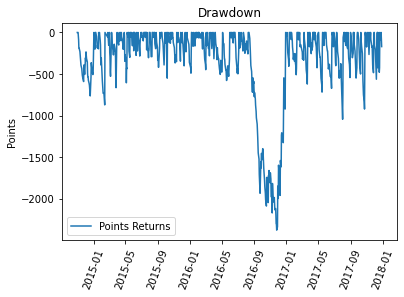

Longer Loss Sequence:  94
Largest Accumulated Loss:  -2380
Biggest Loss in a Day:  -485


In [8]:
print("Drawdown of Operations Carried out by the Experiment")
drawdownGeral = []

drawdownGeral.append(0)
for T in ganhoDiario:
    if drawdownGeral[-1]+T < 0:
        drawdownGeral.append(drawdownGeral[-1]+T)
    if drawdownGeral[-1]+T >= 0:
        drawdownGeral.append(0)

plt.plot(DiasAnalisados[fim-len(drawdownGeral):fim], drawdownGeral)
plt.xticks(rotation=70);

plt.title('Drawdown')
plt.ylabel('Points')
plt.legend(['Points Returns'])
    

plt.show()

MaxDiasPerdas = 0
auxPerdas = 0
for T in drawdownGeral:
    if T < 0:
        auxPerdas = auxPerdas + 1
        if auxPerdas > MaxDiasPerdas:
            MaxDiasPerdas = auxPerdas
    else:
        auxPerdas = 0


        
print("Longer Loss Sequence: ", MaxDiasPerdas)

print("Largest Accumulated Loss: ", min(drawdownGeral))

print("Biggest Loss in a Day: ", min(ganhoDiario) )

Drawdown of Real Data


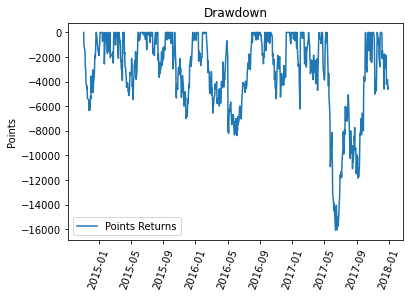

Longer Loss Sequence:  119
Largest Accumulated Loss:  -16080
Biggest Loss in a Day:  -485


In [9]:
print("Drawdown of Real Data")
drawdownGeral = []

diferenca = []
for i in range(1, len(real)):
        diferenca.append(real[i]-real[i-1])
    

drawdownGeral.append(0)
for T in diferenca:
    if drawdownGeral[-1]+T < 0:
        drawdownGeral.append(drawdownGeral[-1]+T)
    if drawdownGeral[-1]+T >= 0:
        drawdownGeral.append(0)

plt.plot(DiasAnalisados[fim-len(drawdownGeral):fim], drawdownGeral)
plt.xticks(rotation=70);

plt.title('Drawdown')
plt.ylabel('Points')
plt.legend(['Points Returns'])
    

plt.show()

MaxDiasPerdas = 0
auxPerdas = 0
for T in drawdownGeral:
    if T < 0:
        auxPerdas = auxPerdas + 1
        if auxPerdas > MaxDiasPerdas:
            MaxDiasPerdas = auxPerdas
    else:
        auxPerdas = 0


        
print("Longer Loss Sequence: ", MaxDiasPerdas)

print("Largest Accumulated Loss: ", min(drawdownGeral))

print("Biggest Loss in a Day: ", min(ganhoDiario) )

Example of Clusters and Representations
Cluster: 0 - Representation: 33.98
Cluster: 1 - Representation: 28.59
Cluster: 2 - Representation: 11.19
Cluster: 3 - Representation: 4.88
Cluster: 4 - Representation: 3.87


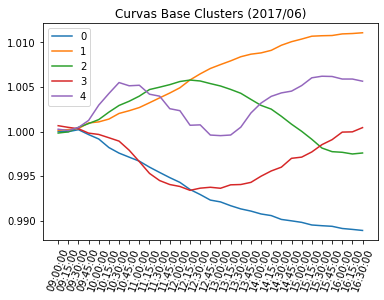

In [10]:
print("Example of Clusters and Representations")
legenda = []
listahora = []

hora= sorted(Dados.hora.unique())
for tempo in hora:
        listahora.append(str(tempo))
        
for i in range(5):
    print("Cluster: %d - Representation: %.2f" % (i,Representacao[i]))
    plt.plot(listahora[0:31], listaMedias[i])
    legenda.append(i)
plt.title('Curvas Base Clusters (2017/06)')
plt.xticks(rotation=70);
plt.legend(legenda)
plt.show()


ponto = 6

Ativados = [1, 2]
ganhoEstrategia = 0;
somaRepresentacao = 0
for i in Ativados:
    ganhoEstrategia = ganhoEstrategia + (listaMedias[i][30] - listaMedias[i][ponto])
    somaRepresentacao = somaRepresentacao + Representacao[i]


In [11]:
print("Experiment Results With the Configured Settings")
positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0
for T in ganhoDiario:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)

Experiment Results With the Configured Settings
Days:  738
Days Gain: 226
Magnitude Gain:  71934
Days Loss: 480
Magnitude Loss:  -37377
Average Gain:  318.2920353982301
Average Loss:  -77.86875
Average Overall Gain:  48.947592067988666
Gain / Loss Ratio:  0.32011331444759206
No Operate: 32


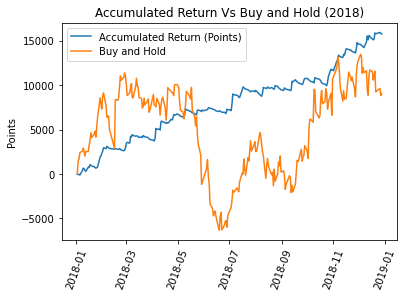

Days:  244
Days Gain: 77
Magnitude Gain:  29510
Days Loss: 155
Magnitude Loss:  -13748
Average Gain:  383.24675324675326
Average Loss:  -88.69677419354839
Average Overall Gain:  67.9396551724138
Gain / Loss Ratio:  0.33189655172413796
No Operate: 12


In [12]:
#DatasIniciaisMes = ['2014-01-02' , '2014-02-03' , '2014-03-06' , '2014-04-01' , '2014-05-02' , '2014-06-02' , '2014-07-01' , '2014-08-01' , '2014-09-01' , '2014-10-01' , '2014-11-03' , '2014-12-01' ,
#                    '2015-01-02' , '2015-02-02' , '2015-03-02' , '2015-04-01' , '2015-05-04' , '2015-06-01' , '2015-07-01' , '2015-08-03' , '2015-09-01' , '2015-10-01' , '2015-11-03' , '2015-12-01' ,
#                    '2016-01-04' , '2016-02-01' , '2016-03-01' , '2016-04-01' , '2016-05-02' , '2016-06-01' , '2016-07-01' , '2016-08-01' , '2016-09-01' , '2016-10-03' , '2016-11-01' , '2016-12-01' , 
#                    '2017-01-02' , '2017-02-01' , '2017-03-02' , '2017-04-03' , '2017-05-02' , '2017-06-01' , '2017-07-03' , '2017-08-01' , '2017-09-01' , '2017-10-02' , '2017-11-01' , '2017-12-01' , 
#                    '2018-01-02' , '2018-02-01' , '2018-03-01' , '2018-04-02' , '2018-05-02' , '2018-06-01' , '2018-07-02' , '2018-08-01' , '2018-09-03' , '2018-10-01' , '2018-11-01' , '2018-12-03' , 
#                    '2019-01-02' , '2019-02-01' , '2019-03-01' , '2019-04-01']

#PLOT 2018
inicioplot = dt_idx.get_loc(DatasIniciaisMes[48])
fimplot = dt_idx.get_loc(DatasIniciaisMes[60])
inicioplotAcumula = fimplot-inicioplot


auxTempReal = []
auxTempAcumula = []

for i in acumula[-inicioplotAcumula:]:
    auxTempAcumula.append(i-acumula[-inicioplotAcumula])
for i in real[-inicioplotAcumula:]:
    auxTempReal.append(i-real[-inicioplotAcumula])
    
    

    
plt.plot(DiasAnalisados[inicioplot:fimplot], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplot:fimplot], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2018)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

# Dados 2018 - Rodar somente depois da celula de dados de 2018
positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[-inicioplotAcumula:]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)

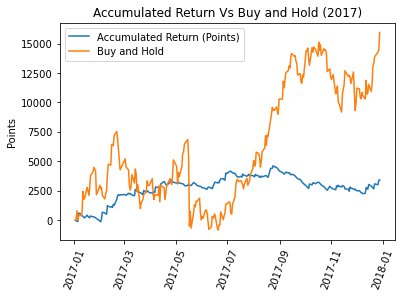

Days:  245
Days Gain: 71
Magnitude Gain:  15475
Days Loss: 164
Magnitude Loss:  -12071
Average Gain:  217.95774647887325
Average Loss:  -73.60365853658537
Average Overall Gain:  14.485106382978723
Gain / Loss Ratio:  0.3021276595744681
No Operate: 10


In [13]:
#PLOT 2017

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[36])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[48])


fimplot = len(acumula)-inicioplotAcumula
inicioplot = fimplot-(fimplotData-inicioplotData)


auxTempAcumula = []
auxTempReal = []
for i in acumula[inicioplot:fimplot]:
    auxTempAcumula.append(i-acumula[inicioplot])
for i in real[inicioplot:fimplot]:
    auxTempReal.append(i-real[inicioplot])


    

    
    
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2017)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)


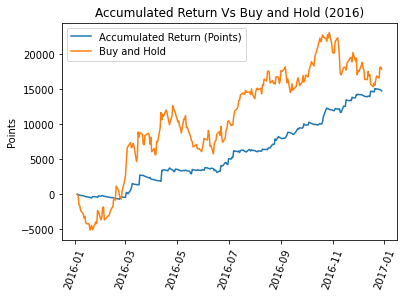

Days:  248
Days Gain: 78
Magnitude Gain:  26949
Days Loss: 161
Magnitude Loss:  -11518
Average Gain:  345.5
Average Loss:  -71.54037267080746
Average Overall Gain:  64.56485355648536
Gain / Loss Ratio:  0.3263598326359833
No Operate: 9


In [14]:
#PLOT 2016

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[24])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[36])


fimplot = inicioplot
inicioplot = fimplot-(fimplotData-inicioplotData)


auxTempAcumula = []
auxTempReal = []
for i in acumula[inicioplot:fimplot]:
    auxTempAcumula.append(i-acumula[inicioplot])
for i in real[inicioplot:fimplot]:
    auxTempReal.append(i-real[inicioplot])
    
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2016)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)


Worst period of execution - Change in behavior mentioned in the paper


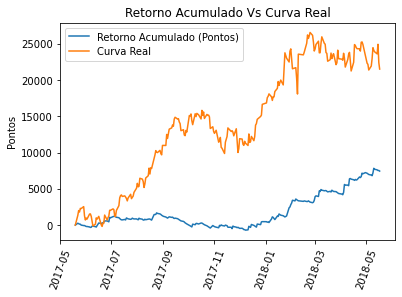

Days:  245
Days Gain: 79
Magnitude Gain:  19625
Days Loss: 156
Magnitude Loss:  -12264
Average Gain:  248.41772151898735
Average Loss:  -78.61538461538461
Average Overall Gain:  31.323404255319147
Gain / Loss Ratio:  0.33617021276595743
No Operate: 10


In [15]:
#PLOT - Problema
print("Worst period of execution - Change in behavior mentioned in the paper")

acumulaInicio = 372-30
plotDadosInicio = 901-30
acumulaFim = 617-30
plotDadosFim = 1146-30

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[40])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[52])


fimplot = acumulaFim
inicioplot = acumulaInicio


auxTempAcumula = []
auxTempReal = []
for i in acumula[acumulaInicio:acumulaFim]:
    auxTempAcumula.append(i-acumula[acumulaInicio])
for i in real[acumulaInicio:acumulaFim]:
    auxTempReal.append(i-real[acumulaInicio])
    
    
plt.plot(DiasAnalisados[plotDadosInicio:plotDadosFim], auxTempAcumula)
plt.plot(DiasAnalisados[plotDadosInicio:plotDadosFim], auxTempReal)
plt.legend(['Retorno Acumulado (Pontos)', 'Curva Real'])
plt.title('Retorno Acumulado Vs Curva Real')
plt.xticks(rotation=70);
plt.ylabel('Pontos')
plt.show()


positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1


print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)



In [16]:
listaCurvas

[[-1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1],
 [1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1],
 [-1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  -1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [-1,
  1,
  1,
  1,
  1,
  1,
  -1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  -1,
  -1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  1,
  -1],
 [1,
  -1,
  1,
  1,
  1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  -1,
  -1,
  -1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 [1,
  -1,
 